In [2]:
!pip install numpy networkx scipy scikit-learn GraphRicciCurvature matplotlib seaborn pandas shapely

  Using cached threadpoolctl-3.6.0-py3-none-any.whl.metadata (13 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.6/204.6 kB 4.1 MB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.2/11.2 MB 20.8 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 20.7 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.7/307.7 kB 4.5 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.4/9.4 MB 21.5 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 344.1/344.1 kB 9.5 MB/s eta 0:00:00:00:01
Using cached threadpoolctl-3.6.0-py3-none-any.whl (18 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 18.6 MB/s eta 0:00:0000:0100:01
  Created wheel for python-louvain: filename=python_louvain-0.16-py3-none-any.whl size=9389 sha256=4935c5d782c96bc3239f7fe24587c66ed1eda5496b0d0ca0acf5740e8eaaa7b2
  Stored in directory: /Users/arianamondiri/Library/Cach

In [ ]:
import numpy as np
import networkx as nx
from scipy.spatial import Delaunay as SciPyDelaunay
from sklearn.neighbors import kneighbors_graph as sklearn_kneighbors_graph
from GraphRicciCurvature.OllivierRicci import OllivierRicci
from GraphRicciCurvature import OllivierRicci as ORC_Module
from GraphRicciCurvature.FormanRicci import FormanRicci
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns 
import pandas as pd
import os
import traceback
import xml.etree.ElementTree as ET
from shapely.geometry import Polygon
import networkx.algorithms.community as nx_comm
import platform

### 📍 Extract Centroids from XML Annotations

This function parses an XML file containing annotated regions, extracts vertex coordinates for each polygon with ≥3 vertices, computes their centroids, and returns them as a NumPy array. Invalid entries are skipped.

In [ ]:
def get_centroids_from_xml(xml_file_path: str) -> np.ndarray:
    centroids = []
    try:
        tree = ET.parse(xml_file_path); root = tree.getroot()
        for region_element in root.findall('.//Annotation//Region'):
            vertices = []
            for vertex_element in region_element.findall('.//Vertex'):
                try:
                    x = float(vertex_element.get('X'))
                    y = float(vertex_element.get('Y'))
                    vertices.append((x, y))
                except (TypeError, ValueError): pass 
            if len(vertices) >= 3:
                try:
                    polygon = Polygon(vertices); centroid = polygon.centroid
                    centroids.append([centroid.x, centroid.y])
                except Exception: pass # 
    except ET.ParseError as e:
        print(f"XML ParseError for {xml_file_path}: {e}"); return np.array([])
    except FileNotFoundError:
        print(f"XML File Not Found: {xml_file_path}"); return np.array([])
    except Exception as e:
        print(f"Unexpected XML Processing Error for {xml_file_path}: {e}"); traceback.print_exc(); return np.array([])
    # if not centroids: print(f"No centroids extracted from {xml_file_path}") # Optional: uncomment for verbose output
    return np.array(centroids)

### 🔗 Graph Construction from 2D Points

- `build_knn_graph`: Constructs a k-Nearest Neighbors (kNN) graph from 2D point coordinates using scikit-learn.
- `build_delaunay_graph`: Constructs a Delaunay triangulation graph using SciPy for well-connected spatial relationships.

Both return a NetworkX graph with nodes positioned by the original input points.

In [ ]:
def build_knn_graph(points: np.ndarray, k: int = 5) -> nx.Graph:
    if not isinstance(points, np.ndarray) or points.ndim != 2 or points.shape[1] != 2: return nx.Graph()
    if points.shape[0] == 0: return nx.Graph()
    num_samples = points.shape[0]
    # Adjust k if necessary
    if num_samples == 1: k_adjusted = 0
    elif k >= num_samples: k_adjusted = max(0, num_samples - 1)
    else: k_adjusted = k

    g = nx.Graph()
    [g.add_node(i, pos=pos_val, original_index=i) for i, pos_val in enumerate(points)] 

    if k_adjusted == 0 or num_samples <= 1: return g # No edges if k=0 or too few samples
    try:
        adj_mat = sklearn_kneighbors_graph(points, n_neighbors=k_adjusted, mode='connectivity', include_self=False)
        rows, cols = adj_mat.nonzero()
        g.add_edges_from(zip(rows, cols))
    except Exception as e: print(f"Error building kNN graph (k={k_adjusted}, pts={num_samples}): {e}")
    return g

def build_delaunay_graph(points: np.ndarray) -> nx.Graph:
    if not isinstance(points, np.ndarray) or points.ndim != 2 or points.shape[1] != 2: return nx.Graph()
    g = nx.Graph()
    [g.add_node(i, pos=pos_val, original_index=i) for i, pos_val in enumerate(points)] 

    if points.shape[0] < 2: return g # Not enough points for edges
    if points.shape[0] == 2: g.add_edge(0,1); return g # Only one possible edge

    try:
        tri = SciPyDelaunay(points, qhull_options="QJ") 
        edge_set = set()
        for s in tri.simplices: # Add edges from Delaunay triangles
            edge_set.add(tuple(sorted((s[0],s[1]))))
            edge_set.add(tuple(sorted((s[1],s[2]))))
            edge_set.add(tuple(sorted((s[2],s[0]))))
        g.add_edges_from(list(edge_set))
    except Exception as e: print(f"Error building Delaunay graph (pts={points.shape[0]}): {e}")
    return g

### 🧠 Compute Ricci Curvature on Graphs

- `compute_ricci_curvature(graph_input, method="Ollivier" | "Forman")`: Computes edge-based Ricci curvature using either the Ollivier or Forman method.
- Handles errors and platform-specific constraints (e.g., multiprocessing on Windows).
- Returns a copy of the graph with `ricciCurvature` stored in edge attributes (if successful).


In [ ]:
def compute_ricci_curvature(graph_input: nx.Graph, method: str = "Ollivier", alpha: float = 0.5, verbose: str = "ERROR") -> nx.Graph | None:
    if not graph_input or not isinstance(graph_input, nx.Graph) or graph_input.number_of_nodes() == 0:
        return graph_input
    if graph_input.number_of_edges() == 0: # No edges, no curvature to compute
        return graph_input

    graph_to_compute_on = graph_input.copy() 
    computed_graph_output = None
    original_orc_module_proc_setting = None # To restore ORC_Module._proc if changed

    try:
        if method.lower() == "ollivier":
            effective_proc_for_ollivier = 1 
            try: 
                if hasattr(ORC_Module, '_proc'):
                    original_orc_module_proc_setting = ORC_Module._proc
                    ORC_Module._proc = effective_proc_for_ollivier
            except Exception: pass 

            orc = OllivierRicci(graph_to_compute_on, alpha=alpha, verbose=verbose, proc=effective_proc_for_ollivier)
            orc.compute_ricci_curvature()
            computed_graph_output = orc.G

            if computed_graph_output and computed_graph_output.edges():
                has_curvature_attr = False
                _, _, first_edge_data = list(computed_graph_output.edges(data=True))[0]
                if isinstance(first_edge_data, dict) and 'ricciCurvature' in first_edge_data:
                    has_curvature_attr = True
                if not has_curvature_attr:
                    print(f"WARNING (Ollivier): Computation for graph (N={graph_input.number_of_nodes()}, E={graph_input.number_of_edges()}) "
                          f"did NOT result in 'ricciCurvature' attribute on edges.")

        elif method.lower() == "forman":
            frc = FormanRicci(graph_to_compute_on, verbose=verbose)
            frc.compute_ricci_curvature()
            computed_graph_output = frc.G
            if computed_graph_output and computed_graph_output.edges(): 
                has_curvature_attr = False
                _, _, first_edge_data = list(computed_graph_output.edges(data=True))[0]
                if isinstance(first_edge_data, dict) and 'ricciCurvature' in first_edge_data:
                    has_curvature_attr = True
                if not has_curvature_attr:
                     print(f"WARNING (Forman): Computation did NOT result in 'ricciCurvature' attribute on edges.")
        else:
            print(f"Error: Unknown Ricci method: {method}")
            return graph_input 

        if computed_graph_output is None: 
            print(f"CRITICAL WARNING: computed_graph_output is None after {method} computation. Returning original graph.")
            return graph_input
        return computed_graph_output

    except ValueError as ve: 
        if "cannot find context for 'fork'" in str(ve) and platform.system() == "Windows":
            print(f"FATAL ERROR (Windows/Fork): OllivierRicci FAILED due to 'fork' context issue, despite proc=1 attempts.")
            return graph_input 
        else: 
            print(f"UNHANDLED ValueError during {method} compute_ricci_curvature: {ve}")
            traceback.print_exc()
            return graph_input
    except Exception as e: 
        print(f"UNEXPECTED Exception during {method} compute_ricci_curvature:")
        traceback.print_exc()
        return graph_input
    finally:
        if method.lower() == "ollivier" and original_orc_module_proc_setting is not None:
            try:
                if hasattr(ORC_Module, '_proc'):
                    ORC_Module._proc = original_orc_module_proc_setting
            except Exception: pass

### 📊 Ricci Curvature Summary Statistics

- `get_curvature_summary_stats(graph, as_string=False)`: Computes descriptive statistics (count, mean, std, percentiles) for edge Ricci curvatures in a graph.
- Returns either a `pandas.DataFrame` or a formatted string summary depending on `as_string`.
- Skips edges without valid `ricciCurvature` values.

In [ ]:
def get_curvature_summary_stats(graph_with_curvature: nx.Graph, as_string: bool = False) -> pd.DataFrame | str:
    if not graph_with_curvature or not isinstance(graph_with_curvature, nx.Graph):
        return pd.DataFrame() if not as_string else "No graph data."

    curvatures = [d['ricciCurvature'] for u,v,d in graph_with_curvature.edges(data=True) if isinstance(d,dict) and 'ricciCurvature' in d and d['ricciCurvature'] is not None]
    if not curvatures:
        return pd.DataFrame() if not as_string else "No curvature data."

    s = pd.Series(curvatures)
    percentiles_to_compute = [ .05, .25, .5, .75, .95]
    summary = s.describe(percentiles=percentiles_to_compute)
    if as_string:
        stats_str = f"Count: {summary.loc['count']:.0f}, Mean: {summary.loc['mean']:.3f}, Std: {summary.loc['std']:.3f}\n" \
                    f"Min: {summary.loc['min']:.3f}, Max: {summary.loc['max']:.3f}\n"
        percentile_str = ", ".join([f"{int(p*100)}%: {summary.loc[f'{int(p*100)}%']:.3f}" for p in percentiles_to_compute if f'{int(p*100)}%' in summary])
        return stats_str + percentile_str
    else:
        return summary.to_frame(name='Ricci Curvature')


### Graph & Curvature Plotting Functions

- **visualize_graph_custom_layout:** Plots a NetworkX graph with custom layout, node/edge colors, and detailed titles.
- **plot_curvature_distribution:** Shows Ricci curvature as histogram or violin plot with stats.
- **plot_multiple_curvature_distributions:** Compares multiple curvature datasets via KDE plots.

In [ ]:
def visualize_graph_custom_layout(graph: nx.Graph, layout_pos: dict,
                                  title_parts: dict,
                                  node_size: int = 40,
                                  node_colors=None, cmap_nodes=None, legend_handles=None, legend_title=None,
                                  edge_curvatures_to_draw=None, cmap_edges_override=None, vmin_edges=None, vmax_edges=None,
                                  output_path: str = None, show_plot_live: bool = True) -> plt.Figure | None:
    if not graph or not isinstance(graph, nx.Graph): return None
    fig, ax = plt.subplots(figsize=(14, 12))
   
    main_title_str = title_parts.get("main", "Graph Visualization")
    sub_info_list = []
    if "data_source" in title_parts: sub_info_list.append(f"Data: {title_parts['data_source']}")
    if "graph_type" in title_parts: sub_info_list.append(f"Graph: {title_parts['graph_type']}")
    if "nodes_edges" in title_parts: sub_info_list.append(f"N={title_parts['nodes_edges'][0]}, E={title_parts['nodes_edges'][1]}")
    if "ricci_method" in title_parts: sub_info_list.append(f"Ricci: {title_parts['ricci_method']}")
    if "surgery_info" in title_parts and title_parts["surgery_info"]: sub_info_list.append(f"Surg: {title_parts['surgery_info']}")
    if "community_info" in title_parts and title_parts["community_info"]: sub_info_list.append(f"Comms: {title_parts['community_info']}")
    full_plot_title = main_title_str
    if sub_info_list: full_plot_title += "\n" + " | ".join(sub_info_list)

    if graph.number_of_nodes() == 0: 
        ax.set_title(full_plot_title + " (Empty Graph)"); ax.set_xlabel("X (Layout)"); ax.set_ylabel("Y (Layout)"); ax.axis('on'); plt.tight_layout()
        if output_path: fig.savefig(output_path, bbox_inches='tight')
        if show_plot_live: plt.show(block=False); plt.pause(0.01)
        else: plt.close(fig)
        return fig

    if not layout_pos and graph.number_of_nodes() > 0 : 
        layout_pos = nx.spring_layout(graph, seed=np.random.randint(0,100000))
    elif not layout_pos and graph.number_of_nodes() == 0: 
        plt.close(fig); return None

    node_color_param = node_colors if node_colors is not None else 'skyblue'
    cmap_param = cmap_nodes if node_colors is not None and cmap_nodes is not None else None
    nodes_to_draw_list = list(graph.nodes()) 
    if isinstance(node_colors, list) and len(node_colors) != len(nodes_to_draw_list):
        node_color_param = ['skyblue'] * len(nodes_to_draw_list); cmap_param = None

    nx.draw_networkx_nodes(graph, layout_pos, nodelist=nodes_to_draw_list, node_size=node_size, node_color=node_color_param, cmap=cmap_param,
                           edgecolors='k', linewidths=0.5, ax=ax, alpha=0.9)
    if legend_handles and legend_title: 
        ax.legend(handles=legend_handles, title=legend_title, loc="upper left", bbox_to_anchor=(1.02, 1), borderaxespad=0., fontsize="small")

    if not graph.edges():
        ax.set_title(full_plot_title + " (Nodes Only)")
    else: 
        if node_colors is not None:
            nx.draw_networkx_edges(graph, layout_pos, width=0.6, ax=ax, edge_color='silver', alpha=0.5)
        elif edge_curvatures_to_draw is not None and \
             isinstance(edge_curvatures_to_draw, list) and len(edge_curvatures_to_draw) == graph.number_of_edges():
         
            cmap_edges_to_use = cmap_edges_override if cmap_edges_override else plt.cm.RdYlBu_r
            current_vmin_edges, current_vmax_edges = vmin_edges, vmax_edges
        
            if current_vmin_edges is None or current_vmax_edges is None :
                min_ec_val = min(edge_curvatures_to_draw) if edge_curvatures_to_draw else 0
                max_ec_val = max(edge_curvatures_to_draw) if edge_curvatures_to_draw else 0
                if abs(min_ec_val - max_ec_val) < 1e-9: 
                    delta_ec_val = abs(min_ec_val * 0.1) if min_ec_val !=0 else 0.01
                    current_vmin_edges, current_vmax_edges = min_ec_val - delta_ec_val, max_ec_val + delta_ec_val
                elif min_ec_val < 0 and max_ec_val > 0: 
                    abs_extreme_edge = max(abs(min_ec_val), abs(max_ec_val))
                    current_vmin_edges, current_vmax_edges = -abs_extreme_edge, abs_extreme_edge
                else: 
                    current_vmin_edges, current_vmax_edges = min_ec_val, max_ec_val
            if abs(current_vmax_edges - current_vmin_edges) < 1e-9: 
                current_vmin_edges -=0.01; current_vmax_edges += 0.01
            nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,
                                   edge_vmin=current_vmin_edges, edge_vmax=current_vmax_edges,
                                   width=1.5, ax=ax, alpha=0.8)
            try: 
                norm_for_colorbar = mcolors.Normalize(vmin=current_vmin_edges, vmax=current_vmax_edges)
                sm_edges = plt.cm.ScalarMappable(cmap=cmap_edges_to_use, norm=norm_for_colorbar)
                sm_edges.set_array(edge_curvatures_to_draw)
                cbar_edges = fig.colorbar(sm_edges, ax=ax, orientation="vertical", fraction=0.046, pad=0.04, aspect=30)
                cbar_edges.set_label('Edge Ricci Curvature')
            except Exception as e: print(f"Error creating edge colorbar for '{full_plot_title}': {e}")
        else: 
            nx.draw_networkx_edges(graph, layout_pos, width=0.7, ax=ax, edge_color='gray', alpha=0.4)

    ax.set_title(full_plot_title, fontsize=9)
    ax.set_xlabel("X (Layout)"); ax.set_ylabel("Y (Layout)"); ax.axis('on')
 
    if layout_pos and graph.number_of_nodes() > 0:
        x_coords_layout = [p[0] for p in layout_pos.values()]; y_coords_layout = [p[1] for p in layout_pos.values()]
        if x_coords_layout and y_coords_layout:
            min_x, max_x = min(x_coords_layout), max(x_coords_layout)
            min_y, max_y = min(y_coords_layout), max(y_coords_layout)
            padding_x_layout = (max_x - min_x) * 0.05 if (max_x - min_x) > 1e-9 else 0.1
            padding_y_layout = (max_y - min_y) * 0.05 if (max_y - min_y) > 1e-9 else 0.1
            ax.set_xlim(min_x - padding_x_layout, max_x + padding_x_layout)
            ax.set_ylim(min_y - padding_y_layout, max_y + padding_y_layout)
    fig.subplots_adjust(right=0.82, top=0.92) 
    if output_path:
        try: fig.savefig(output_path, bbox_inches='tight');
        except Exception as e: print(f"Error saving graph image {output_path}: {e}")
    if show_plot_live: plt.show(block=False); plt.pause(0.01)
    else: plt.close(fig)
    return fig


def plot_curvature_distribution(graph_with_curvature: nx.Graph, title_parts: dict,
                                plot_type: str = 'histogram', output_path: str = None,
                                show_plot_live: bool = True) -> plt.Figure | None:
    if not graph_with_curvature or not isinstance(graph_with_curvature, nx.Graph): return None
    curvatures = [d['ricciCurvature'] for u,v,d in graph_with_curvature.edges(data=True) if isinstance(d,dict) and 'ricciCurvature' in d and d['ricciCurvature'] is not None]

    main_title_str = title_parts.get("main", "Ricci Curvature Distribution")
    sub_info_list = []
    if "data_source" in title_parts: sub_info_list.append(f"Data: {title_parts['data_source']}")
    if "graph_type" in title_parts: sub_info_list.append(f"Graph: {title_parts['graph_type']}")
    if "ricci_method" in title_parts: sub_info_list.append(f"Ricci: {title_parts['ricci_method']}")
    if "surgery_info" in title_parts and title_parts["surgery_info"] and title_parts["surgery_info"] != "None":
        sub_info_list.append(f"Surg: {title_parts['surgery_info']}")
    full_plot_title = main_title_str
    if sub_info_list: full_plot_title += "\n" + " | ".join(sub_info_list)

    fig,ax=plt.subplots(figsize=(9,7))
    if not curvatures:
        ax.set_title(full_plot_title + " (No Valid Curvature Data)")
        ax.text(0.5,0.5,"No curvature data to plot", ha='center',va='center',transform=ax.transAxes)
    else: 
        if plot_type.lower() == 'histogram':
            sns.histplot(curvatures,kde=True,bins='auto',ax=ax, color="royalblue")
            ax.set_xlabel("Ricci Curvature"); ax.set_ylabel("Frequency")
        elif plot_type.lower() == 'violin':
            sns.violinplot(y=curvatures,ax=ax, inner='quartile', color="skyblue")
            ax.set_ylabel("Ricci Curvature")
        else:
            plt.close(fig); raise ValueError(f"Invalid plot_type: '{plot_type}'. Choose 'histogram' or 'violin'.")
        summary_text = get_curvature_summary_stats(graph_with_curvature, as_string=True)
        if summary_text != "No curvature data.": 
             ax.text(0.03, 0.97, summary_text, transform=ax.transAxes, fontsize=7,
                    verticalalignment='top', horizontalalignment='left',
                    bbox=dict(boxstyle='round,pad=0.3', fc='aliceblue', alpha=0.7))
    ax.set_title(full_plot_title, fontsize=10); ax.grid(True,linestyle='--',alpha=0.7);
    plt.tight_layout(rect=[0, 0, 1, 0.96]) 
    if output_path:
        try: fig.savefig(output_path, bbox_inches='tight')
        except Exception as e: print(f"Error saving distribution image {output_path}: {e}")
    if show_plot_live: plt.show(block=False); plt.pause(0.01)
    else: plt.close(fig)
    return fig



def plot_multiple_curvature_distributions(
    curvature_data_list: list[tuple[str, list[float]]],
    main_title: str = "Comparison of Ricci Curvature Profiles",
    output_path: str = None,
    show_plot_live: bool = True
) -> plt.Figure | None:
    if not curvature_data_list:
        print("No curvature data provided for comparison plot.")
        return None
    fig, ax = plt.subplots(figsize=(12, 8))
    plot_data = []
    for label, curvatures in curvature_data_list:
        if curvatures: 
            for curv in curvatures:
                plot_data.append({'Sample': label, 'Ricci Curvature': curv})
    if not plot_data:
        ax.set_title(main_title + "\n(No valid curvature data in any sample for comparison)")
        ax.text(0.5,0.5,"No data", ha='center',va='center',transform=ax.transAxes)
    else:
        df_plot = pd.DataFrame(plot_data)
        sns.kdeplot(data=df_plot, x='Ricci Curvature', hue='Sample', fill=True, alpha=0.5, linewidth=1.5, ax=ax)
        ax.set_title(main_title, fontsize=12)
        ax.set_xlabel("Ricci Curvature"); ax.set_ylabel("Density (KDE)")
        ax.grid(True, linestyle='--', alpha=0.7)
        if ax.get_legend() is not None:
             ax.legend(title='Sample', loc='upper left', bbox_to_anchor=(1.02, 1), borderaxespad=0.)
             fig.subplots_adjust(right=0.75) 
    plt.tight_layout(rect=[0, 0, 1 if ax.get_legend() is None else 0.8, 0.96]) 
    if output_path:
        try:
            fig.savefig(output_path, bbox_inches='tight'); print(f"Saved comparison plot: {output_path}")
        except Exception as e: print(f"Error saving comparison plot {output_path}: {e}")
    if show_plot_live: plt.show(block=False); plt.pause(0.1)
    else: plt.close(fig)
    return fig

### apply_louvain_and_visualize_with_layout

- Runs Louvain community detection on a graph with given resolution.
- Assigns node colors based on detected communities.
- Computes layout using community-aware spring layout or fallback methods.
- Visualizes graph with community coloring, legend, and optional saving.
- Returns list of detected communities.

In [ ]:
def apply_louvain_and_visualize_with_layout(
    graph_to_process: nx.Graph,
    title_parts_base: dict,
    louvain_resolution: float,
    use_community_aware_layout: bool = True,
    spring_layout_weight_intra: float = 3.0,
    spring_layout_weight_inter: float = 0.05,
    layout_iterations_spring: int = 100,
    output_path_template: str | None = None,
    show_plot_live: bool = True
):
    iteration_label_suffix = f"LouvainRes_{louvain_resolution:.2f}".replace('.', 'p')
    if not graph_to_process or graph_to_process.number_of_nodes() == 0:
        print(f"ApplyLouvain ({iteration_label_suffix}): Invalid or empty graph"); return []

    communities_detected = None; node_colors = None; num_detected_communities = 0
    nodes_in_graph = list(graph_to_process.nodes())
    original_node_positions = nx.get_node_attributes(graph_to_process, 'pos') 

    if graph_to_process.number_of_edges() > 0: 
        # print(f"  Louvain (res={louvain_resolution}): Detecting communities...") # Optional print
        try:
            base_seed_val_louvain = 42 # For reproducibility
            try: # Generate a somewhat unique seed
                label_hash_louvain = hash(str(louvain_resolution) + iteration_label_suffix)
                current_seed_louvain = (base_seed_val_louvain + abs(label_hash_louvain)) % (2**32)
            except Exception: current_seed_louvain = np.random.randint(0, 2**32 -1)

            communities_list = list(nx_comm.louvain_communities(graph_to_process, seed=current_seed_louvain, resolution=louvain_resolution))
            communities_detected = [set(c) for c in communities_list]
            num_detected_communities = len(communities_detected)
            # print(f"  Louvain detected {num_detected_communities} communities.") # Optional print
            node_to_comm_id = {node: i for i, comm in enumerate(communities_detected) for node in comm}
            node_colors = [node_to_comm_id.get(node, -1) for node in nodes_in_graph] # Color nodes by community
        except Exception as e_louvain: 
            print(f"  Error during Louvain: {e_louvain}. Defaulting based on connectivity.")
            if nodes_in_graph:
                communities_detected = list(nx.connected_components(graph_to_process)) if graph_to_process.number_of_edges() > 0 else [{n} for n in nodes_in_graph]
            else: communities_detected = []
            num_detected_communities = len(communities_detected)
            node_to_comm_id = {node: i for i, comm in enumerate(communities_detected) for node in comm}
            node_colors = [node_to_comm_id.get(node, -1) for node in nodes_in_graph]
    else: # No edges, each node is its own community
        communities_detected = [{node} for node in nodes_in_graph]
        node_colors = list(range(len(nodes_in_graph))) if nodes_in_graph else []
        num_detected_communities = len(communities_detected)

    layout_for_visualization = {}
    graph_for_layout_planning = graph_to_process.copy() # Copy for modifying layout weights
    base_seed_val_spring = 42 # Seed for spring layout
    try:
        label_hash_spring = hash(iteration_label_suffix + "_layout")
        current_seed_spring = (base_seed_val_spring + abs(label_hash_spring)) % (2**32)
    except Exception: current_seed_spring = np.random.randint(0, 2**32 -1)

    initial_layout_for_spring = original_node_positions if original_node_positions else None # Use original positions as starting point for spring_layout

    if use_community_aware_layout and node_colors and len(node_colors) == len(nodes_in_graph) and graph_for_layout_planning.number_of_edges() > 0:
        # Apply community-aware weights for spring layout
        node_comm_map_for_layout = {nodes_in_graph[i]: node_colors[i] for i in range(len(nodes_in_graph))}
        for u, v_edge_layout in graph_for_layout_planning.edges():
            comm_u = node_comm_map_for_layout.get(u, -1); comm_v = node_comm_map_for_layout.get(v_edge_layout, -1)
            if comm_u == comm_v and comm_u != -1: graph_for_layout_planning[u][v_edge_layout]['weight'] = spring_layout_weight_intra # Stronger attraction within communities
            else: graph_for_layout_planning[u][v_edge_layout]['weight'] = spring_layout_weight_inter # Weaker attraction between communities
        try:
            layout_for_visualization = nx.spring_layout(graph_for_layout_planning, weight='weight', seed=current_seed_spring, iterations=layout_iterations_spring, k=None, pos=initial_layout_for_spring)
        except Exception as e_layout_c: 
            print(f"    Error in community-aware spring_layout, falling back: {e_layout_c}")
            try: layout_for_visualization = nx.spring_layout(graph_to_process, seed=current_seed_spring, iterations=layout_iterations_spring, pos=initial_layout_for_spring)
            except Exception as e_fallback_layout:
                 print(f"    Error in fallback standard spring_layout: {e_fallback_layout}. Using original positions if available.")
                 if original_node_positions: layout_for_visualization = {n: original_node_positions.get(n) for n in nodes_in_graph if n in original_node_positions}
    elif graph_to_process.number_of_nodes() > 0 : 
        try: layout_for_visualization = nx.spring_layout(graph_to_process, seed=current_seed_spring, iterations=layout_iterations_spring, k=None, pos=initial_layout_for_spring)
        except Exception as e_layout_s: 
             print(f"    Error in standard spring_layout, falling back to original positions: {e_layout_s}")
             if original_node_positions: layout_for_visualization = {n: original_node_positions.get(n) for n in nodes_in_graph if n in original_node_positions}

    if not layout_for_visualization and graph_to_process.number_of_nodes() > 0:
        if original_node_positions: layout_for_visualization = original_node_positions
        else: layout_for_visualization = nx.spring_layout(graph_to_process, seed=current_seed_spring)

    current_title_parts_viz = title_parts_base.copy()
    current_title_parts_viz["main"] = f"{title_parts_base.get('data_source', 'Graph')} - Louvain Communities"
    current_title_parts_viz["nodes_edges"] = (graph_to_process.number_of_nodes(), graph_to_process.number_of_edges())
    current_title_parts_viz["community_info"] = f"{num_detected_communities} (res={louvain_resolution:.2f})"

    output_path_iter_display = None
    if output_path_template:
        clean_iter_label_suffix = iteration_label_suffix
        output_path_iter_display = output_path_template.replace(".png", f"_{clean_iter_label_suffix}.png")

    legend_h_display = None; legend_t_display = None; cmap_viz_display = None
    if node_colors and len(node_colors) == len(nodes_in_graph):
        unique_labels_viz = sorted(list(set(node_colors))); num_unique_comms_viz = len(unique_labels_viz)
        if 0 < num_unique_comms_viz <= 10: cmap_n = 'tab10'
        elif 0 < num_unique_comms_viz <= 20: cmap_n = 'tab20'
        else: cmap_n = 'hsv' 
        cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)
        legend_h_display = []; color_map_indices_viz = {lbl: idx for idx, lbl in enumerate(unique_labels_viz)}
        for lbl_val in unique_labels_viz:
            color_idx_cmap = color_map_indices_viz[lbl_val]
            norm_f = (num_unique_comms_viz - 1) if num_unique_comms_viz > 1 else 1.0
            if num_unique_comms_viz == 0 : norm_f = 1.0
            color_val_for_legend = color_idx_cmap / norm_f if num_unique_comms_viz > 1 else 0.0
            actual_c = cmap_viz_display(color_val_for_legend)
            legend_h_display.append(plt.Line2D([0], [0], marker='o', color='w',
                                           label=f'Comm {lbl_val}' if lbl_val !=-1 else f'Unassigned',
                                           markerfacecolor=actual_c, markersize=10))
        if legend_h_display: legend_t_display = "Communities"

    if layout_for_visualization and graph_to_process.number_of_nodes() > 0:
        visualize_graph_custom_layout(graph_to_process,
                                    layout_pos=layout_for_visualization, title_parts=current_title_parts_viz,
                                    node_size=80, node_colors=node_colors if node_colors and len(node_colors) == len(nodes_in_graph) else None,
                                    cmap_nodes=cmap_viz_display, legend_handles=legend_h_display, legend_title=legend_t_display,
                                    output_path=output_path_iter_display, show_plot_live=show_plot_live)
    return communities_detected

### `process_xml_workflow`

Builds a graph from XML points, computes Ricci curvature, optionally removes edges (surgery), applies Louvain community detection, and visualizes results.

**Parameters:** XML path, graph type/k, Ricci method, surgery options, Louvain resolutions, layout settings, visualization controls, output paths.

**Returns:**  
(label or None, list of Ricci curvatures after surgery)

In [ ]:
def process_xml_workflow(
                            xml_file_path: str,
                            initial_graph_type: str,
                            initial_k_value: int | None,
                            ricci_method: str,
                            apply_initial_surgery: bool,
                            initial_surgery_method_type: str | None,
                            initial_surgery_param_value: float | None,
                            louvain_resolution_schedule: list[float],
                            use_community_aware_layout_flag: bool,
                            spring_layout_intra_weight_val: float,
                            spring_layout_inter_weight_val: float,
                            spring_layout_base_iterations_val: int,
                            show_plots_live: bool,
                            save_frames: bool,
                            frame_output_folder: str,
                            frame_prefix_base: str = "workflow_") -> tuple[str | None, list[float]]: # Ensure list is always returned for curvatures

    print(f"\n--- Starting Workflow for XML: {xml_file_path} ---")
    base_filename = os.path.splitext(os.path.basename(xml_file_path))[0]

    if save_frames and not os.path.exists(frame_output_folder): # Create output folder if it doesn't exist
        try: os.makedirs(frame_output_folder); print(f"Created output folder: {frame_output_folder}")
        except OSError as e: print(f"Error creating folder {frame_output_folder}: {e}"); save_frames = False

    points = get_centroids_from_xml(xml_file_path)
    if not isinstance(points, np.ndarray) or points.ndim != 2 or points.shape[1] != 2 or points.shape[0] < 2:
        print(f"  Skipping {base_filename}: Invalid or too few points extracted."); return None, []
    print(f"  Extracted {points.shape[0]} centroids (Source: {base_filename}).")

    # Build initial graph
    graph_type_str_for_title = ""
    initial_graph = None
    if initial_graph_type.lower() == 'knn' and initial_k_value is not None:
        initial_graph = build_knn_graph(points, k=initial_k_value)
        graph_type_str_for_title = f"kNN(k={initial_k_value})"
    elif initial_graph_type.lower() == 'delaunay':
        initial_graph = build_delaunay_graph(points)
        graph_type_str_for_title = "Delaunay"
    else:
        print(f"Invalid initial graph type or parameters for {base_filename}."); return None, []

    if initial_graph is None or initial_graph.number_of_nodes() == 0:
        print(f"Failed to build initial graph for {base_filename}. Skipping."); return None, []
    
    num_initial_nodes = initial_graph.number_of_nodes()
    num_initial_edges = initial_graph.number_of_edges()
    print(f"Initial graph ({graph_type_str_for_title}) for {base_filename}: {num_initial_nodes}N, {num_initial_edges}E")
    initial_pos_from_construction = nx.get_node_attributes(initial_graph, 'pos') 

    # Compute Ricci curvature
    graph_with_initial_curvature = initial_graph
    if num_initial_edges > 0: 
        print(f"Computing {ricci_method} curvature for {base_filename}...")
       
        graph_with_initial_curvature = compute_ricci_curvature(initial_graph, method=ricci_method, verbose="WARNING")
    else:
        print(f"Skipping Ricci curvature computation for {base_filename} (no edges).")

    has_ricci_data_on_edges = False
    if graph_with_initial_curvature and graph_with_initial_curvature.edges():
       
        edge_data_sample = list(graph_with_initial_curvature.edges(data=True))[0]
        if isinstance(edge_data_sample[2], dict) and 'ricciCurvature' in edge_data_sample[2] and edge_data_sample[2]['ricciCurvature'] is not None:
            has_ricci_data_on_edges = True
    
    if num_initial_edges > 0 and not has_ricci_data_on_edges:
        print(f"WARNING for {base_filename}: Ricci curvature ({ricci_method}) computation did NOT yield 'ricciCurvature' data on edges.")
    elif has_ricci_data_on_edges:
        print(f"Ricci curvature ({ricci_method}) data found on edges for {base_filename}.")

    title_parts_initial_ricci = {
        "main": "Initial Graph with Ricci Curvature", "data_source": base_filename,
        "graph_type": graph_type_str_for_title, "nodes_edges": (num_initial_nodes, num_initial_edges), "ricci_method": ricci_method }
    edge_curvs_initial = []
    if graph_with_initial_curvature: 
        edge_curvs_initial = [d.get('ricciCurvature', 0.0) for _,_,d in graph_with_initial_curvature.edges(data=True) if isinstance(d, dict)]

    vmin_init, vmax_init = (None, None)
    if edge_curvs_initial and has_ricci_data_on_edges : 
        min_v, max_v = min(edge_curvs_initial), max(edge_curvs_initial)
        if abs(min_v - max_v) < 1e-9 : delta = abs(min_v * 0.1) if min_v !=0 else 0.01; vmin_init, vmax_init = min_v - delta, max_v + delta
        elif min_v < 0 and max_v > 0: abs_ext = max(abs(min_v), abs(max_v)); vmin_init, vmax_init = -abs_ext, abs_ext
        else: vmin_init, vmax_init = min_v, max_v
        if abs(vmax_init - vmin_init) < 1e-9: vmin_init -=0.01; vmax_init +=0.01

    if initial_pos_from_construction and graph_with_initial_curvature:
        out_path_init_ricci = os.path.join(frame_output_folder, f"{frame_prefix_base}{base_filename}_00_initial_ricci.png") if save_frames else None
        visualize_graph_custom_layout(
            graph_with_initial_curvature, layout_pos=initial_pos_from_construction, title_parts=title_parts_initial_ricci,
          
            edge_curvatures_to_draw=edge_curvs_initial if graph_with_initial_curvature.number_of_edges() > 0 and has_ricci_data_on_edges else None,
            output_path=out_path_init_ricci, show_plot_live=show_plots_live )

    title_parts_dist = { "main": "Initial Ricci Curvature Distribution", "data_source": base_filename, "graph_type": graph_type_str_for_title, "ricci_method": ricci_method }
    out_path_dist = os.path.join(frame_output_folder, f"{frame_prefix_base}{base_filename}_00_ricci_dist.png") if save_frames else None
    if graph_with_initial_curvature and has_ricci_data_on_edges: 
        plot_curvature_distribution(graph_with_initial_curvature, title_parts=title_parts_dist, output_path=out_path_dist, show_plot_live=show_plots_live)
    elif graph_with_initial_curvature and num_initial_edges > 0 : 
        print(f"Skipping curvature distribution plot for {base_filename} (no valid Ricci data on edges).")

    graph_after_surgery = graph_with_initial_curvature.copy() if graph_with_initial_curvature else None
    surgery_info_str = "None"

    if apply_initial_surgery and initial_surgery_method_type and initial_surgery_param_value is not None and has_ricci_data_on_edges and graph_after_surgery:
        print(f"\nApplying Initial Surgery to {base_filename}: {initial_surgery_method_type}({initial_surgery_param_value:.2f})...")
        edges_to_remove_s = []
        all_edge_curvatures_s = [((u,v), d['ricciCurvature']) for u,v,d in graph_with_initial_curvature.edges(data=True) if isinstance(d, dict) and 'ricciCurvature' in d and d['ricciCurvature'] is not None]

        if all_edge_curvatures_s:
            if initial_surgery_method_type == "threshold":
                edges_to_remove_s = [edge for edge, curv in all_edge_curvatures_s if curv < initial_surgery_param_value]
            elif initial_surgery_method_type == "percentage_negative":
                neg_edges_s_list = sorted([item for item in all_edge_curvatures_s if item[1] < 0], key=lambda item: item[1]) # Sort by most negative
                if neg_edges_s_list:
                    num_to_remove_s_val = int(len(neg_edges_s_list) * initial_surgery_param_value)
                    edges_to_remove_s = [item[0] for item in neg_edges_s_list[:num_to_remove_s_val]] 
            if edges_to_remove_s:
                graph_after_surgery.remove_edges_from(edges_to_remove_s)
                print(f"  Initial surgery removed {len(edges_to_remove_s)} edges from {base_filename}.")
                surgery_info_str = f"{initial_surgery_method_type}({initial_surgery_param_value:.2f})"
            else: print(f"  No edges met criteria for removal in initial surgery for {base_filename}.")
    elif apply_initial_surgery and (not has_ricci_data_on_edges and num_initial_edges > 0): 
        print(f"\nSkipping Initial Surgery for {base_filename} (no Ricci curvature data found on edges).")
    # else: print(f"\nNo initial surgery applied or parameters missing for {base_filename}.") # Optional: for explicit "no surgery" message

    # Collect curvatures after surgery for comparison plot
    curvatures_after_surgery_for_comparison = []
    if graph_after_surgery:
        curvatures_after_surgery_for_comparison = [d.get('ricciCurvature') for _,_,d in graph_after_surgery.edges(data=True) if isinstance(d, dict) and d.get('ricciCurvature') is not None]

    # Apply Louvain community detection and visualize
    if graph_after_surgery and graph_after_surgery.number_of_nodes() > 0 : # Proceed only if graph is still valid
        for i_res, current_res in enumerate(louvain_resolution_schedule):
            title_parts_louvain_base = { "data_source": base_filename, "graph_type": graph_type_str_for_title, "ricci_method": ricci_method, "surgery_info": surgery_info_str }
            output_template_louvain_run = None
            if save_frames: # Construct filename for Louvain plot
                s_base_f = base_filename.replace(' ','_').replace('.','-').replace(':','-'); s_graph_f = graph_type_str_for_title.replace(' ','').replace('(','').replace(')','').replace('=','').replace(',','')
                s_ricci_f = ricci_method; s_surg_f = f"Surg-{initial_surgery_method_type or 'None'}_{str(initial_surgery_param_value or 'None').replace('.', 'p').replace('-','neg')}" if apply_initial_surgery and initial_surgery_method_type else "NoSurg"
                s_layout_f = "CommAwareL" if use_community_aware_layout_flag else "StdL"
                prefix_to_use = frame_prefix_base if frame_prefix_base.endswith('_') or not frame_prefix_base else frame_prefix_base + "_"
                file_prefix_f = f"{prefix_to_use}{s_base_f}_{s_graph_f}_{s_ricci_f}_{s_surg_f}_{s_layout_f}"
                output_template_louvain_run = os.path.join(frame_output_folder, f"{file_prefix_f}.png")
            apply_louvain_and_visualize_with_layout(
                graph_after_surgery, title_parts_base=title_parts_louvain_base, louvain_resolution=current_res,
                use_community_aware_layout=use_community_aware_layout_flag, spring_layout_weight_intra=spring_layout_intra_weight_val,
                spring_layout_weight_inter=spring_layout_inter_weight_val, layout_iterations_spring=spring_layout_base_iterations_val,
                output_path_template=output_template_louvain_run, show_plot_live=show_plots_live )
    else:
        print(f"Skipping Louvain community detection for {base_filename} (graph after surgery is invalid or empty).")

    # if show_plots_live and plt.get_fignums(): print(f"\nLouvain iterations for {base_filename} complete.") # Optional print

    # Prepare label for comparison plot
    label_for_comp = f"{base_filename}_{graph_type_str_for_title}_{ricci_method}_{surgery_info_str.replace('(','_').replace(')','').replace('.','p').replace(':','-')}"
    return label_for_comp, curvatures_after_surgery_for_comparison # Always return a list for curvatures


In [ ]:


# Import your custom functions here
# from your_module import process_xml_workflow, plot_curvature_distribution, plot_multiple_curvature_distributions

print("--- Starting Ricci Curvature Analysis Workflow ---")
print(f"Python version: {platform.python_version()}; OS: {platform.system()} {platform.release()}")

output_base_folder_main = "output_file"
SHOW_PLOTS_LIVE_MAIN = True
SAVE_PLOTS_TO_FILE_MAIN = True
TARGET_DATA_FOLDER = "MoNuSegTestData"  # Directory to search for XML files

# Create output directory if needed
if SAVE_PLOTS_TO_FILE_MAIN and not os.path.exists(output_base_folder_main):
    try:
        os.makedirs(output_base_folder_main)
        print(f"Created main output folder: {output_base_folder_main}")
    except OSError as e:
        print(f"Error creating main output folder {output_base_folder_main}: {e}")
        SAVE_PLOTS_TO_FILE_MAIN = False

--- Starting Ricci Curvature Analysis Workflow ---
Python version: 3.12.3; OS: Darwin 23.5.0
Created main output folder: output_file


In [24]:
xml_files_to_process = []
if os.path.isdir(TARGET_DATA_FOLDER):
    for fname in os.listdir(TARGET_DATA_FOLDER):
        if fname.lower().endswith('.xml'):
            xml_files_to_process.append(os.path.join(TARGET_DATA_FOLDER, fname))
else:
    print(f"ERROR: TARGET_DATA_FOLDER '{TARGET_DATA_FOLDER}' is not a valid directory.")

if not xml_files_to_process:
    print(f"No XML files found in '{TARGET_DATA_FOLDER}'. Please add XML files to this directory to proceed.")
else:
    print(f"Found {len(xml_files_to_process)} XML files to process in '{TARGET_DATA_FOLDER}'.")


Found 14 XML files to process in 'MoNuSegTestData'.


In [25]:
shared_initial_k = 7
shared_ricci_method = 'Ollivier'
shared_apply_surgery = True
shared_surgery_method = "percentage_negative"
shared_surgery_val = 0.05
num_res_steps = 3
shared_louvain_res_schedule = np.linspace(0.7, 1.0, num_res_steps).tolist()
shared_use_community_layout = True
shared_intra_weight = 3.0
shared_inter_weight = 0.02
shared_layout_iters = 75

all_curvature_profiles_for_main_comparison = []



--- Starting Workflow for XML: MoNuSegTestData/TCGA-FG-A4MU-01B-01-TS1.xml ---
Created output folder: output_file/Output_TCGA-FG-A4MU-01B-01-TS1
  Extracted 465 centroids (Source: TCGA-FG-A4MU-01B-01-TS1).
Initial graph (kNN(k=7)) for TCGA-FG-A4MU-01B-01-TS1: 465N, 1878E
Computing Ollivier curvature for TCGA-FG-A4MU-01B-01-TS1...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-FG-A4MU-01B-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


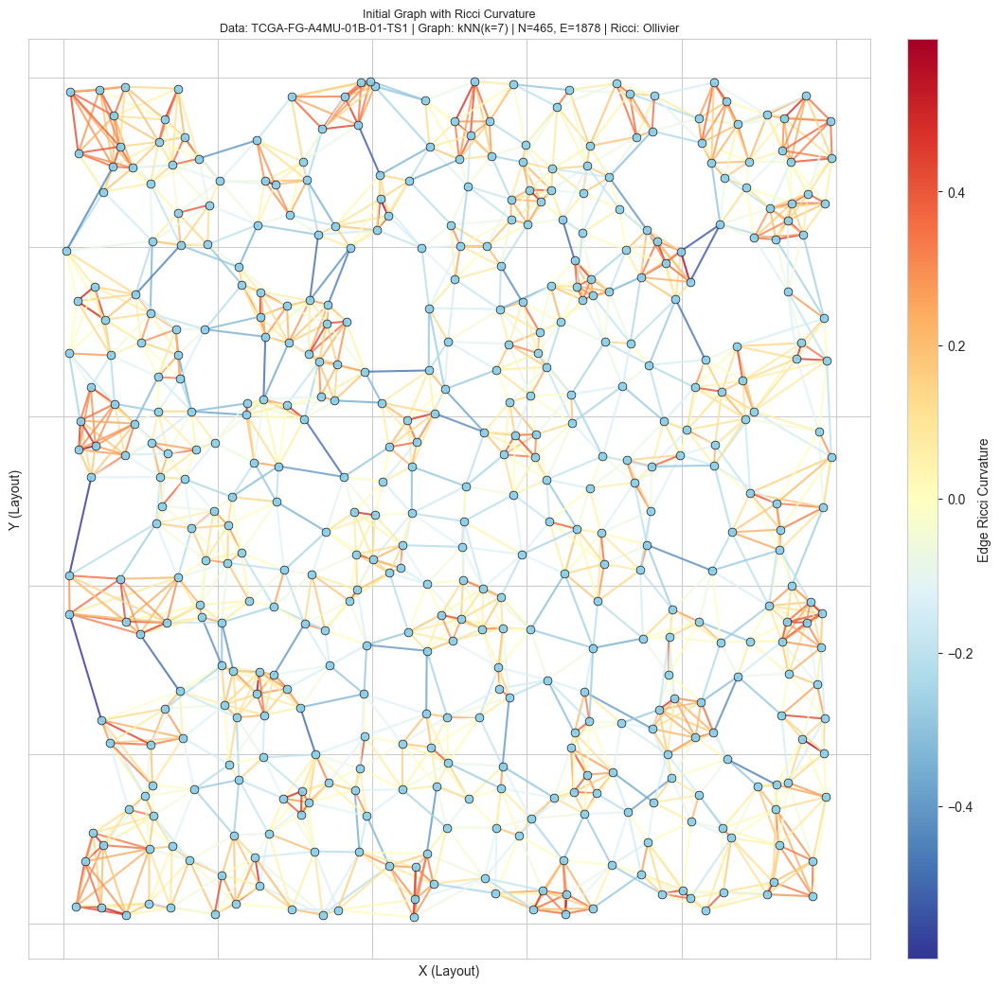

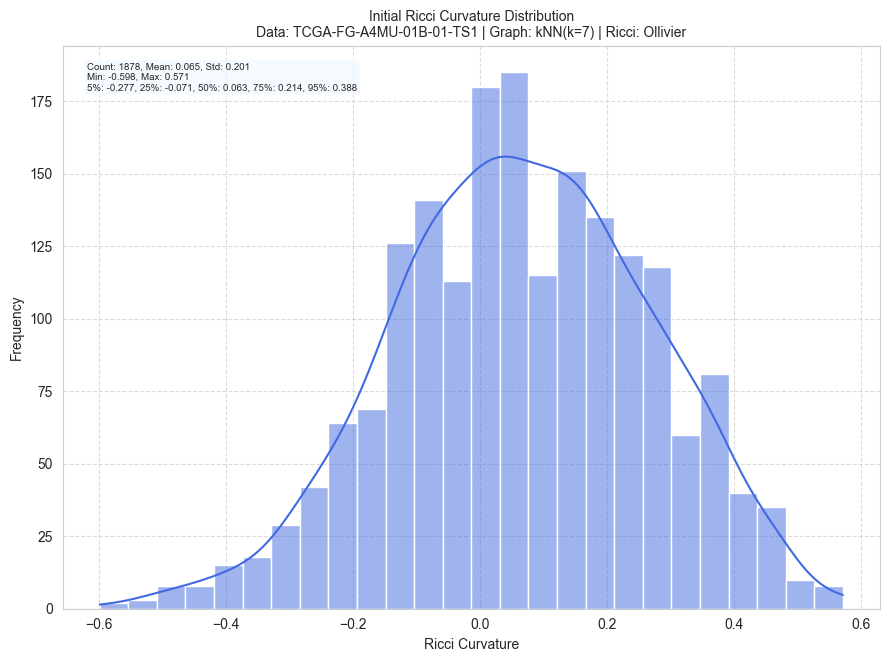


Applying Initial Surgery to TCGA-FG-A4MU-01B-01-TS1: percentage_negative(0.05)...
  Initial surgery removed 33 edges from TCGA-FG-A4MU-01B-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


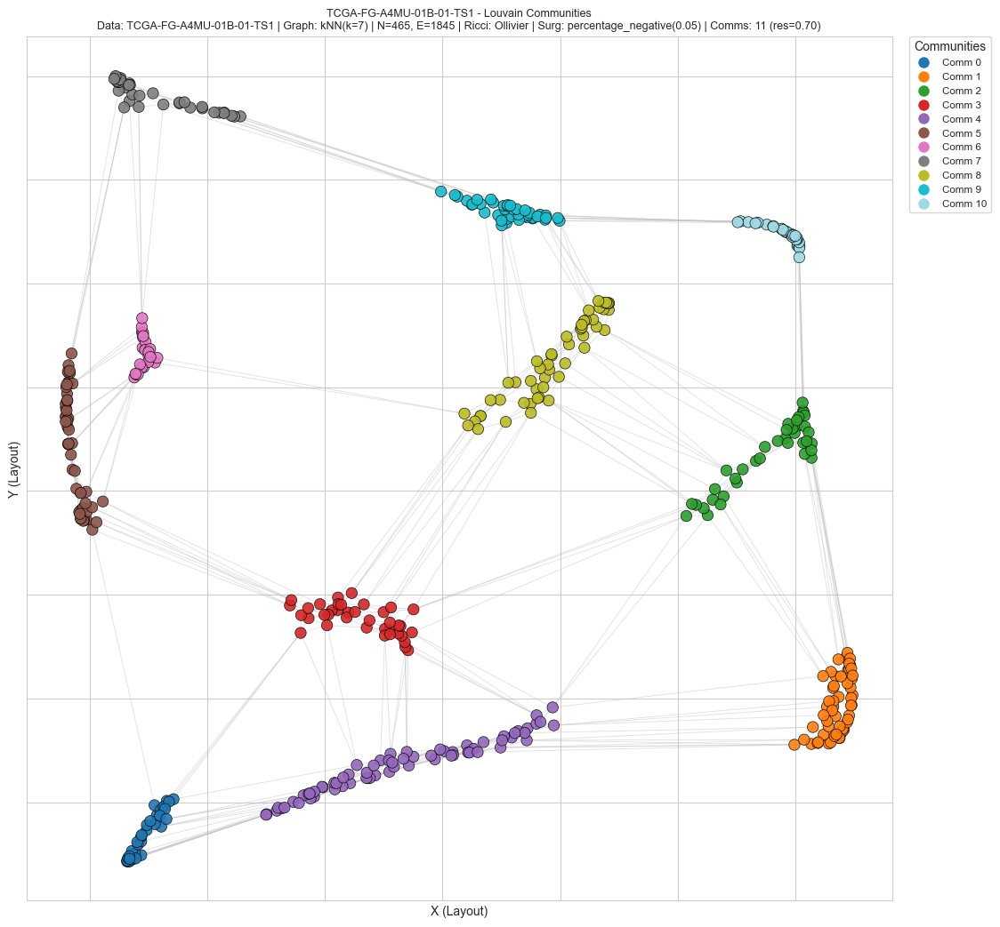

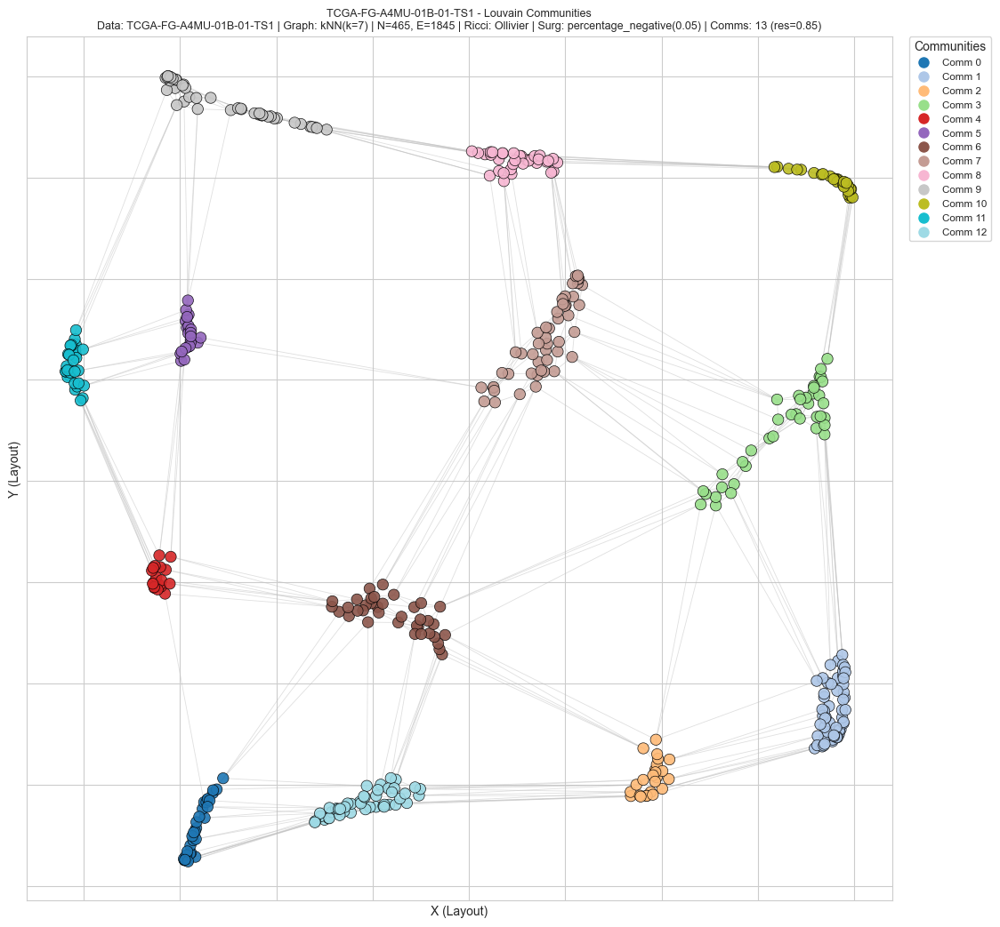

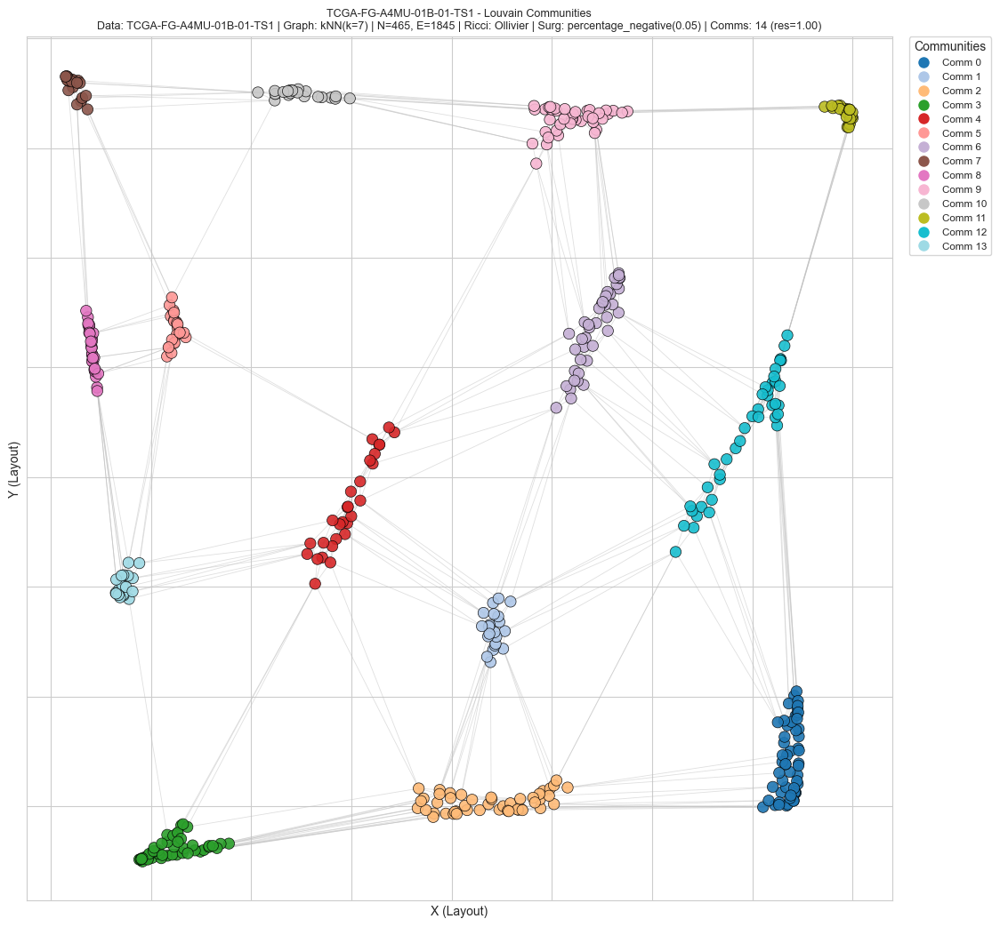


--- Starting Workflow for XML: MoNuSegTestData/TCGA-44-2665-01B-06-BS6.xml ---
Created output folder: output_file/Output_TCGA-44-2665-01B-06-BS6
  Extracted 818 centroids (Source: TCGA-44-2665-01B-06-BS6).
Initial graph (kNN(k=7)) for TCGA-44-2665-01B-06-BS6: 818N, 3294E
Computing Ollivier curvature for TCGA-44-2665-01B-06-BS6...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-44-2665-01B-06-BS6.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


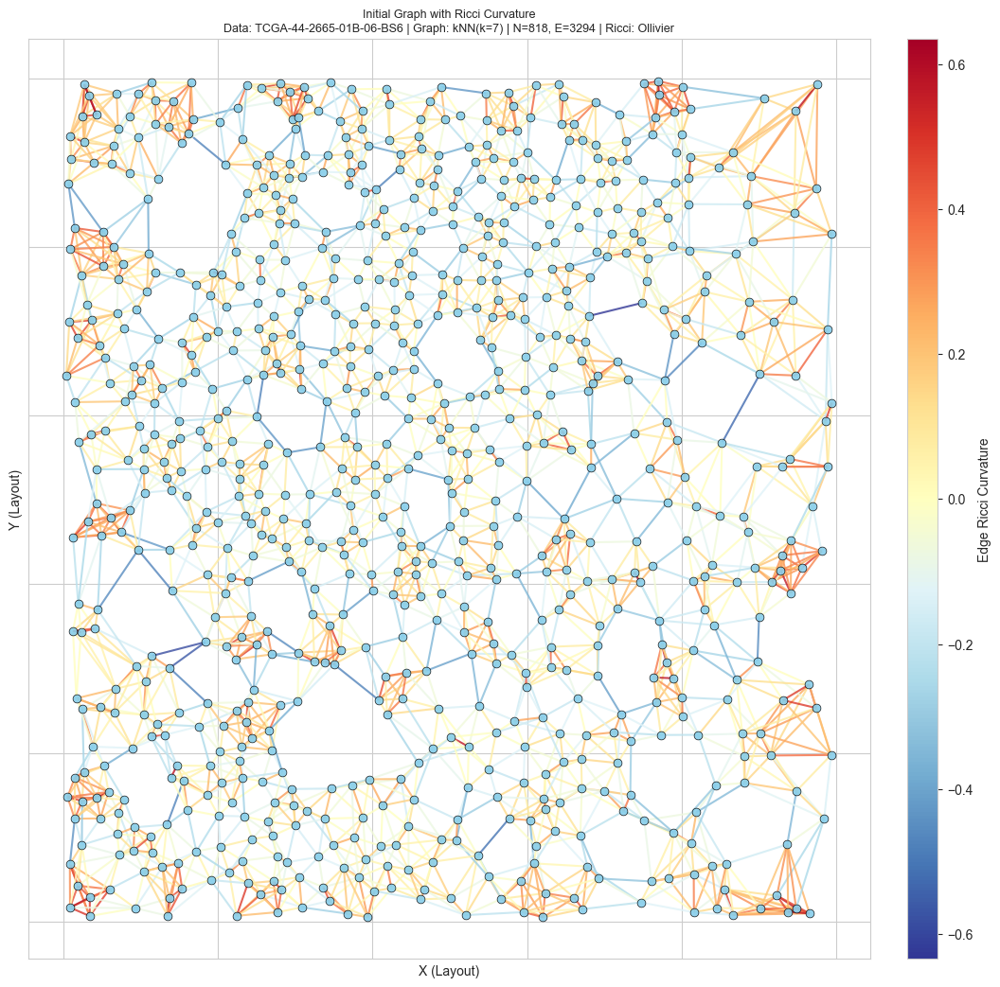

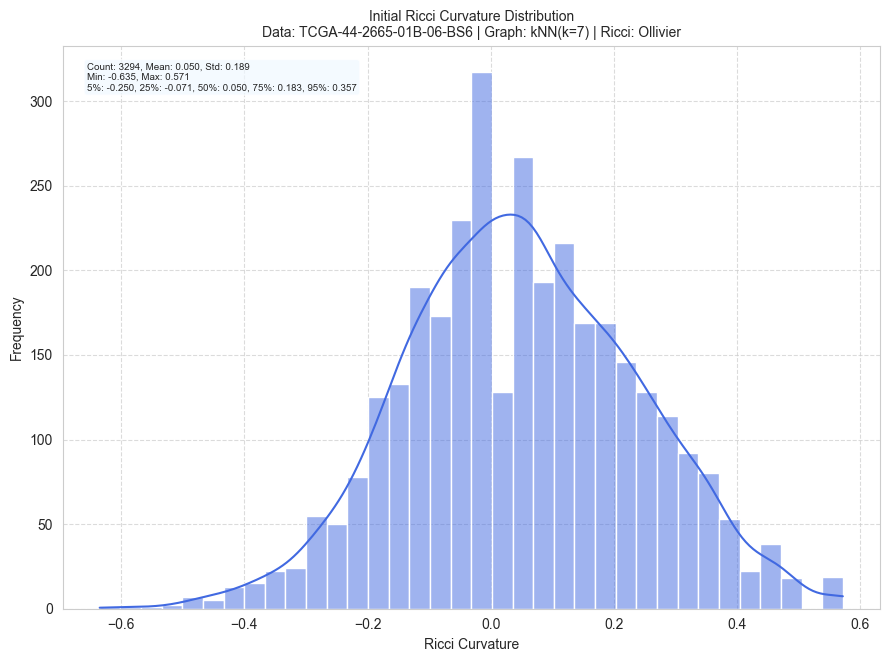


Applying Initial Surgery to TCGA-44-2665-01B-06-BS6: percentage_negative(0.05)...
  Initial surgery removed 63 edges from TCGA-44-2665-01B-06-BS6.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


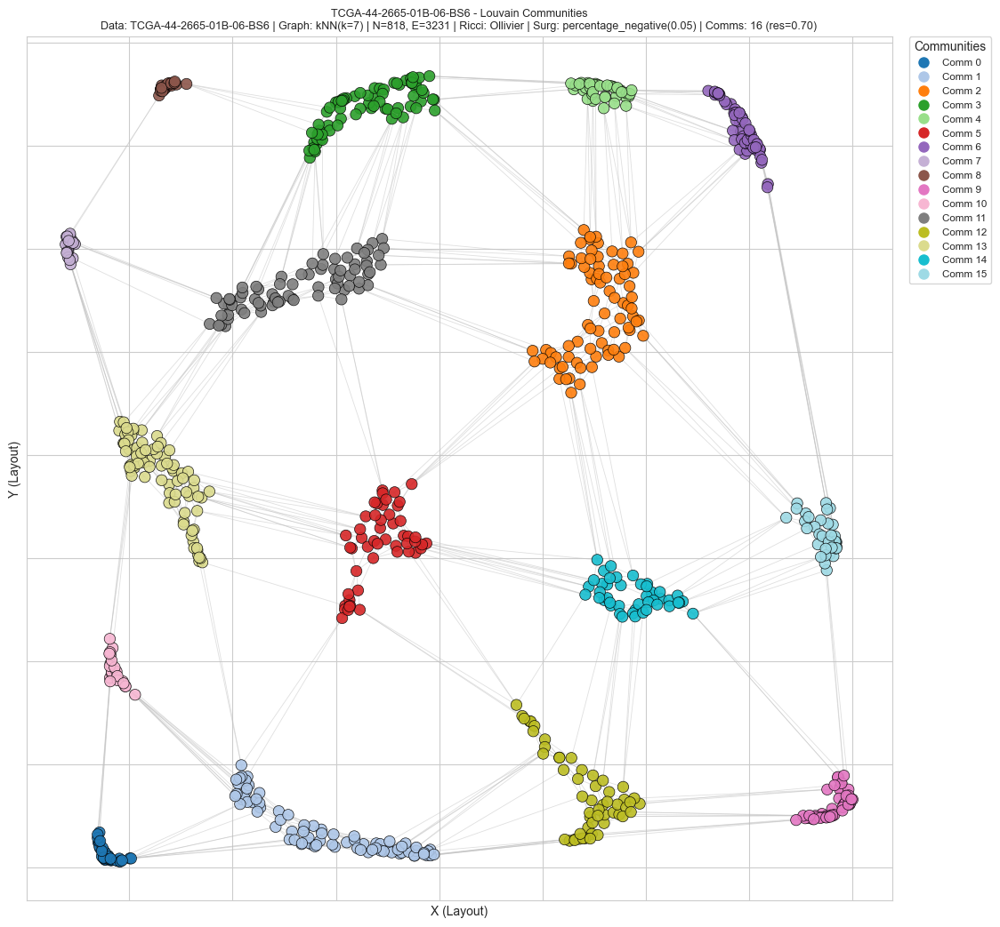

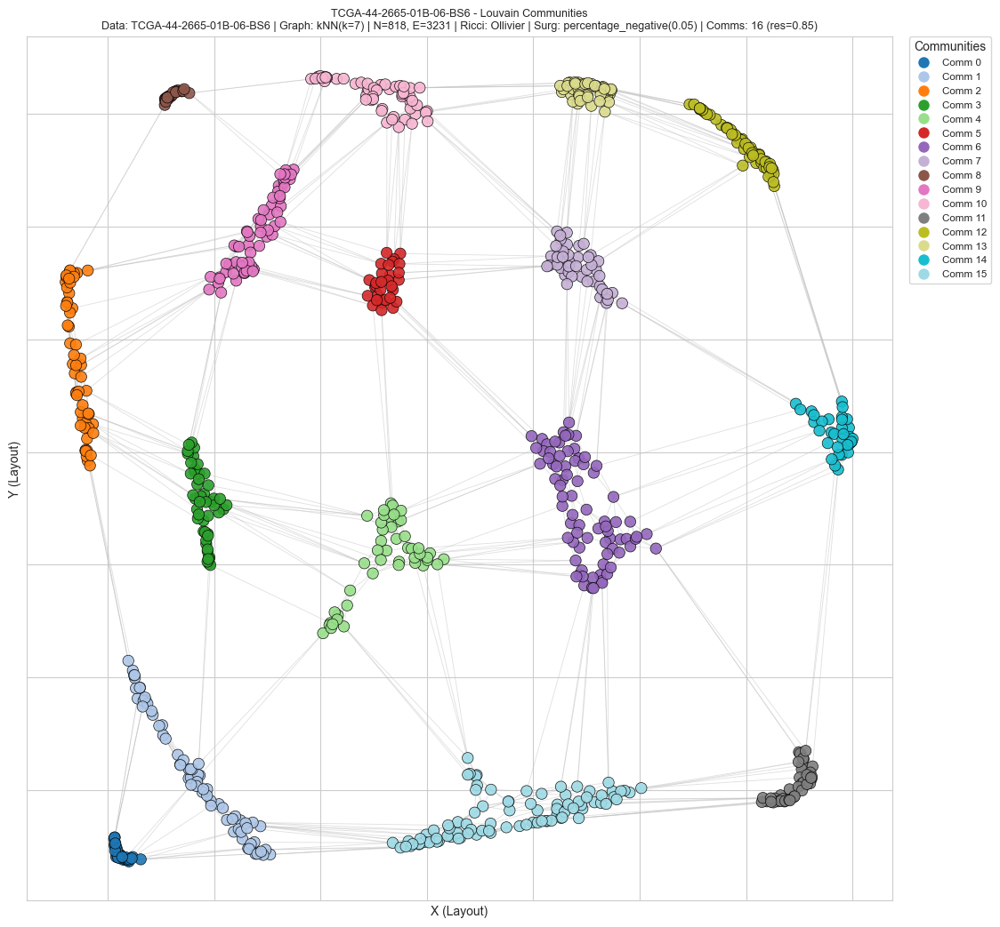

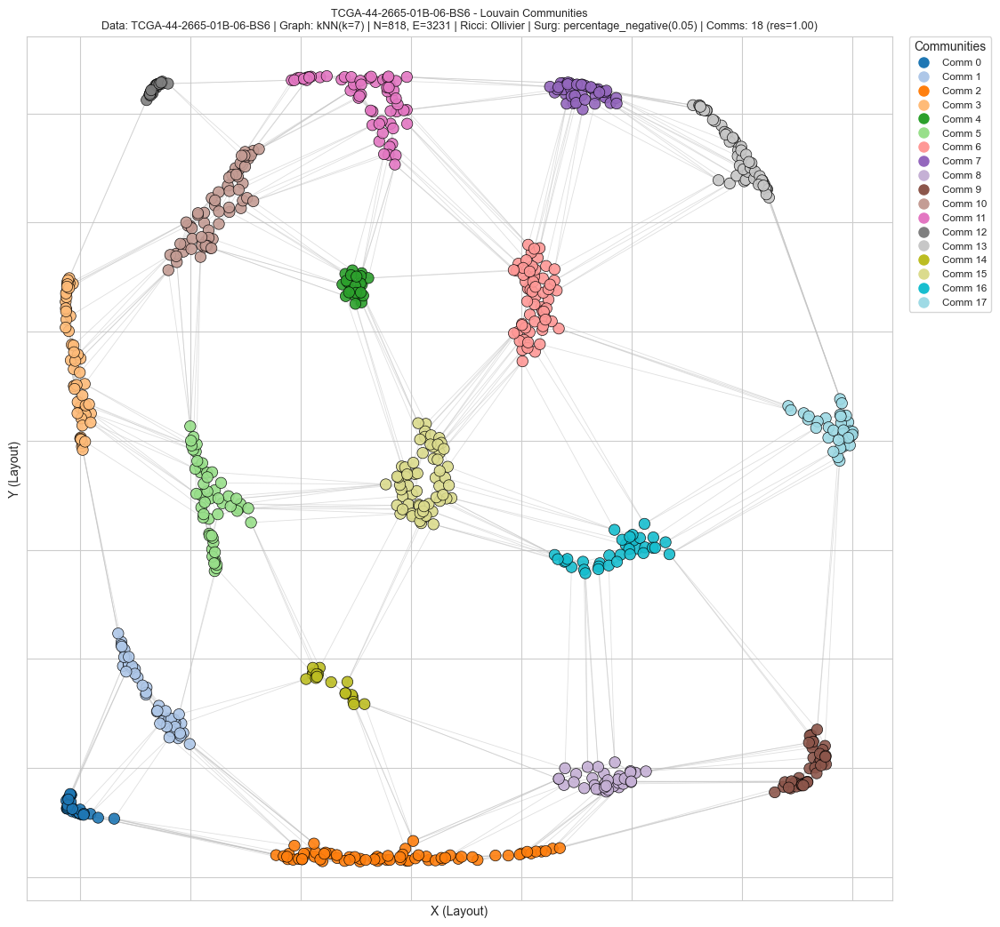


--- Starting Workflow for XML: MoNuSegTestData/TCGA-2Z-A9J9-01A-01-TS1.xml ---
Created output folder: output_file/Output_TCGA-2Z-A9J9-01A-01-TS1
  Extracted 575 centroids (Source: TCGA-2Z-A9J9-01A-01-TS1).
Initial graph (kNN(k=7)) for TCGA-2Z-A9J9-01A-01-TS1: 575N, 2336E
Computing Ollivier curvature for TCGA-2Z-A9J9-01A-01-TS1...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-2Z-A9J9-01A-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


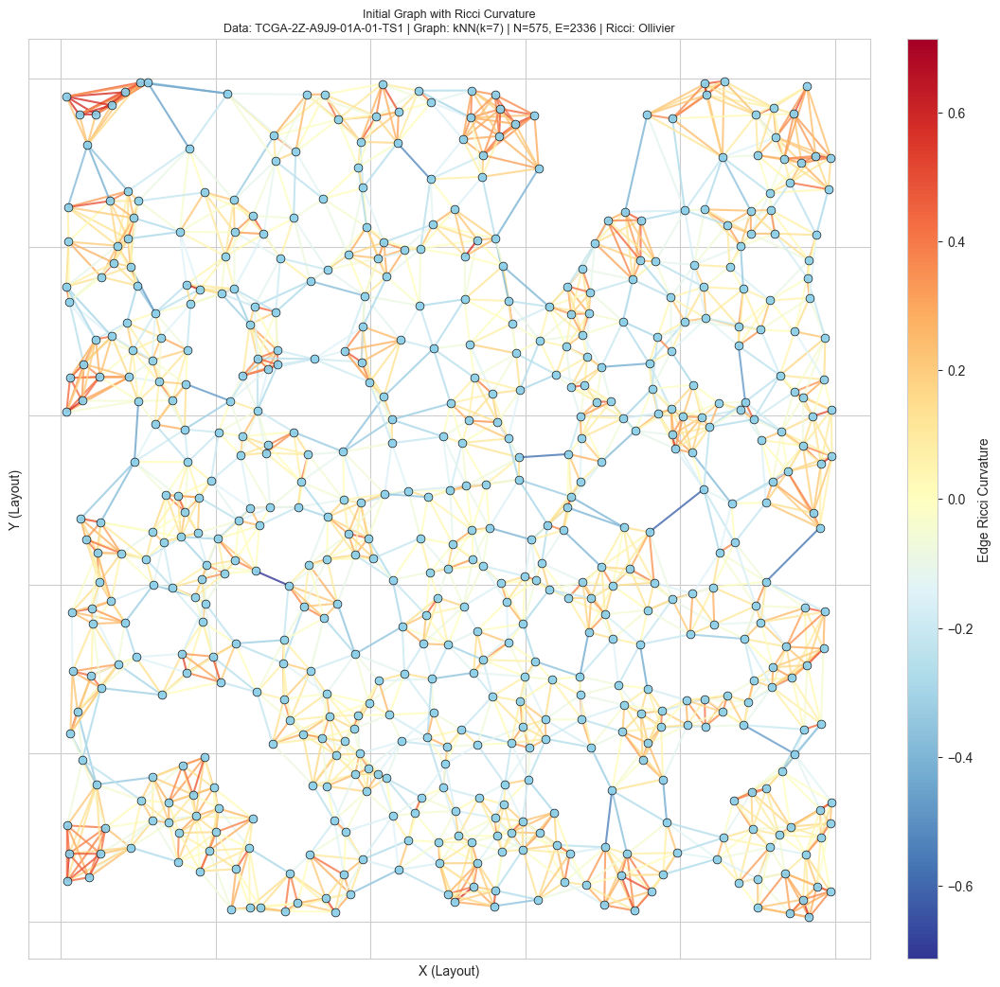

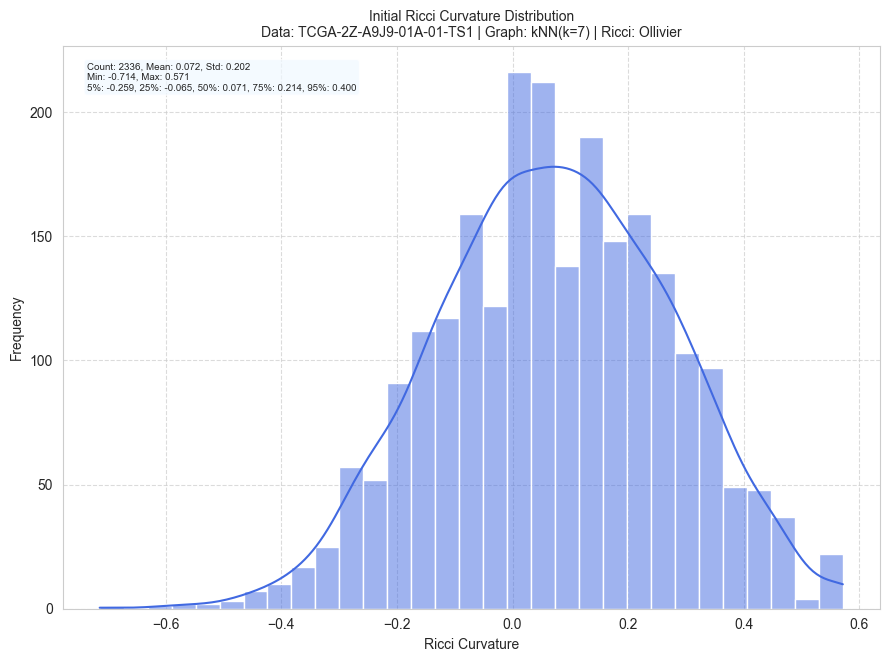


Applying Initial Surgery to TCGA-2Z-A9J9-01A-01-TS1: percentage_negative(0.05)...
  Initial surgery removed 41 edges from TCGA-2Z-A9J9-01A-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


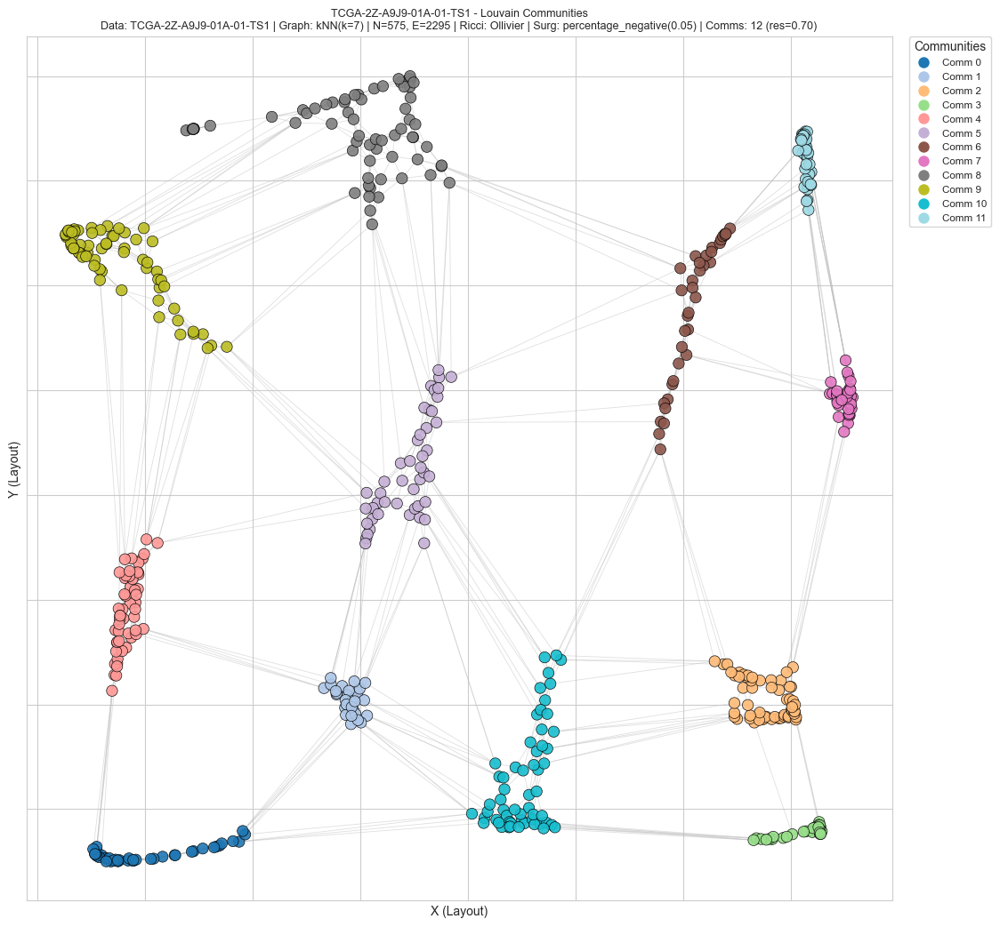

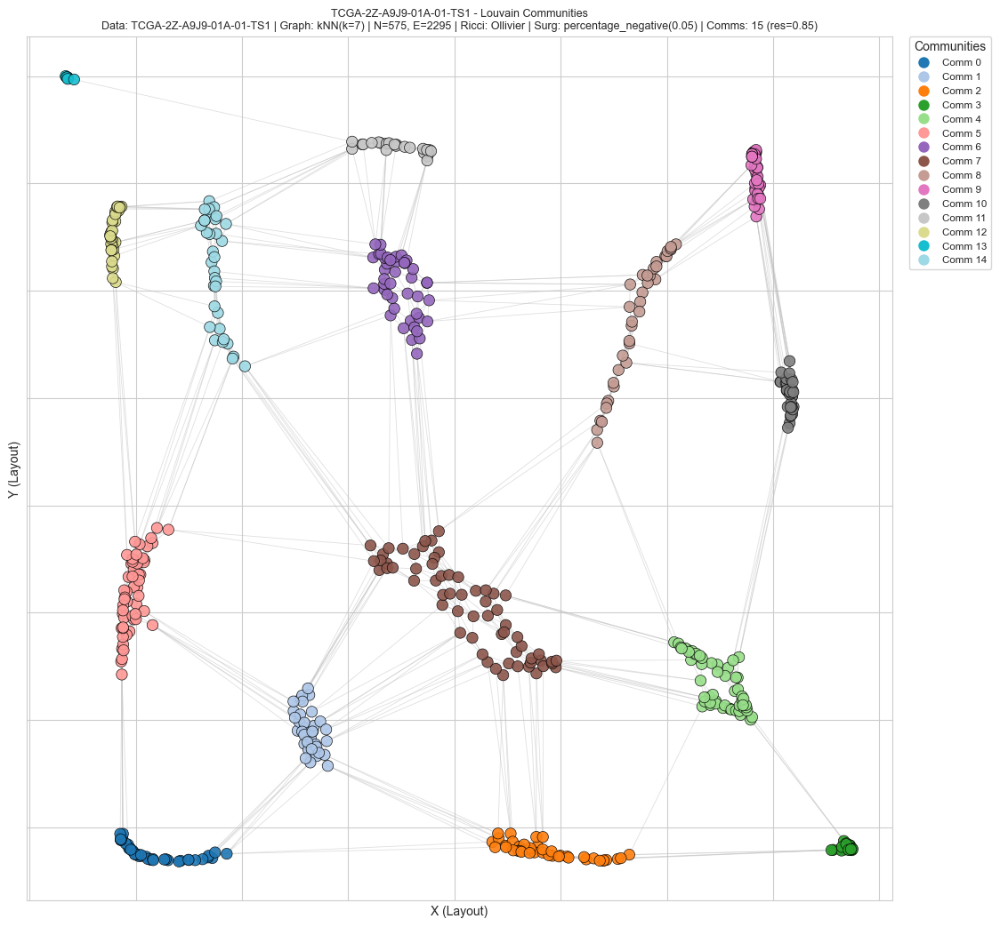

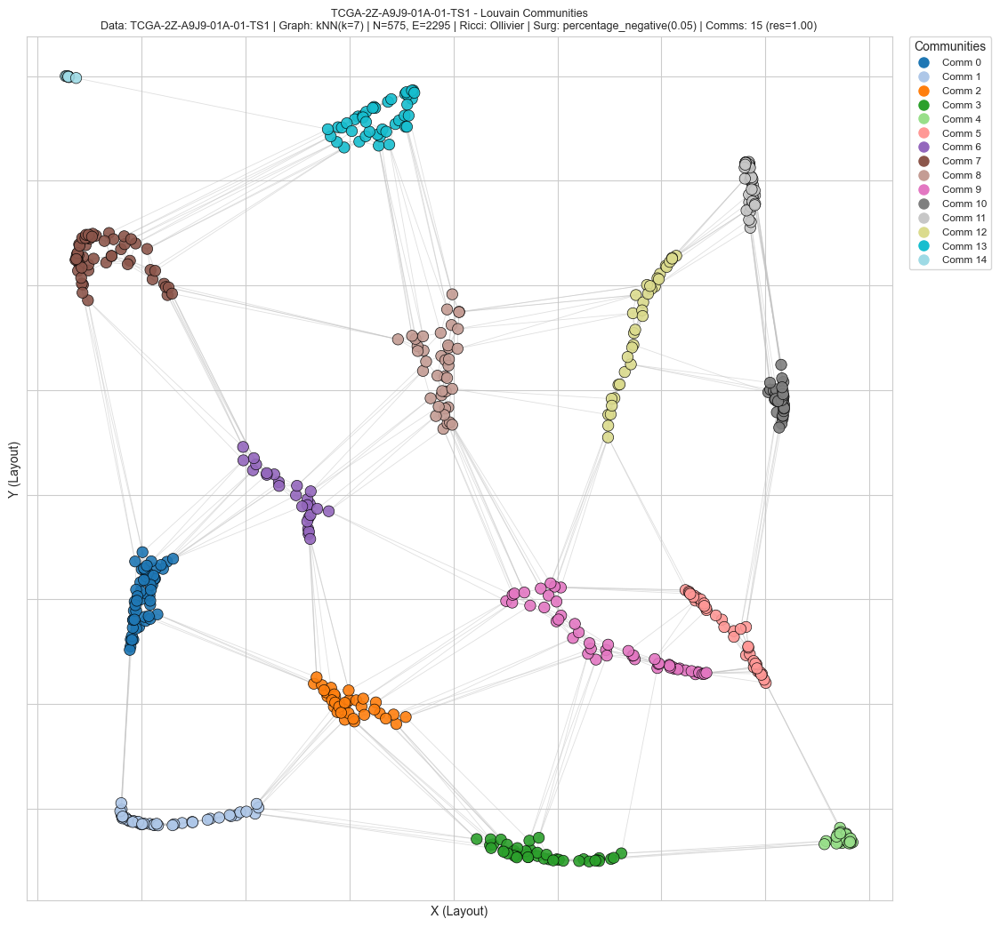


--- Starting Workflow for XML: MoNuSegTestData/TCGA-ZF-A9R5-01A-01-TS1.xml ---
Created output folder: output_file/Output_TCGA-ZF-A9R5-01A-01-TS1
  Extracted 475 centroids (Source: TCGA-ZF-A9R5-01A-01-TS1).
Initial graph (kNN(k=7)) for TCGA-ZF-A9R5-01A-01-TS1: 475N, 1891E
Computing Ollivier curvature for TCGA-ZF-A9R5-01A-01-TS1...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-ZF-A9R5-01A-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


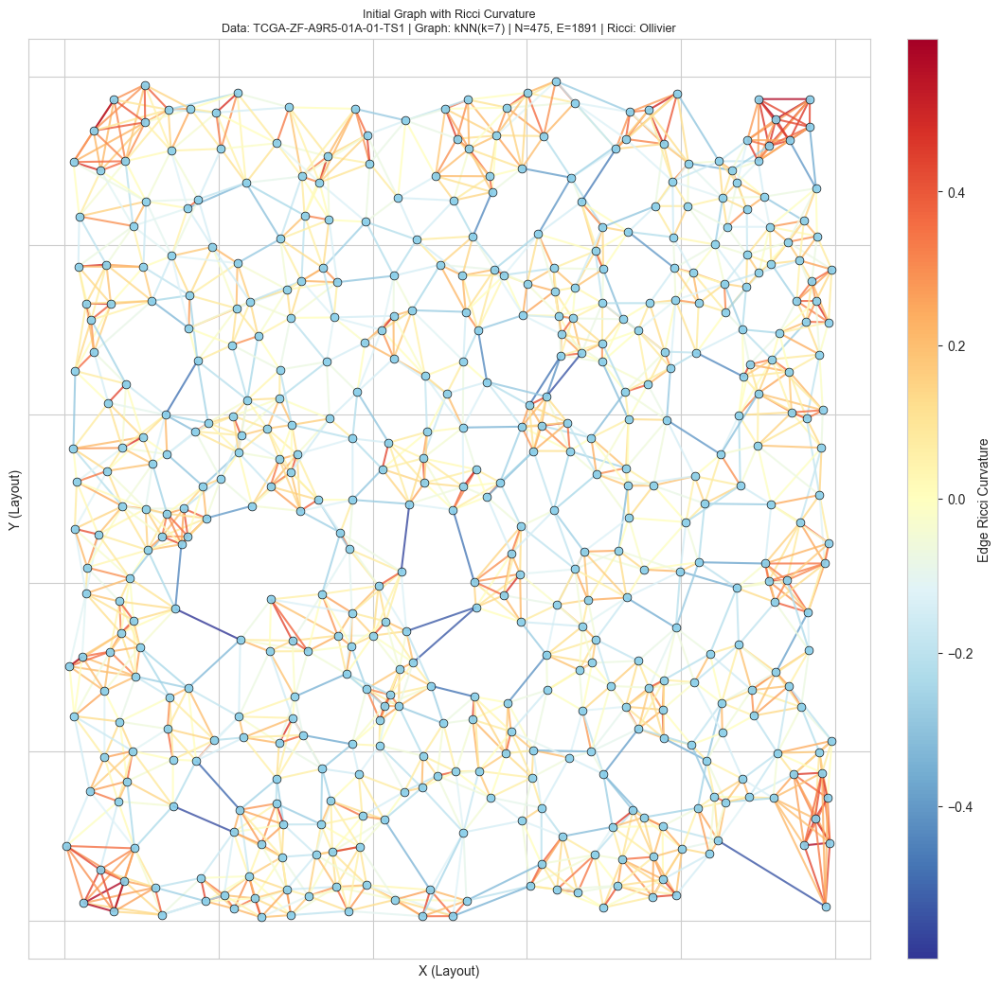

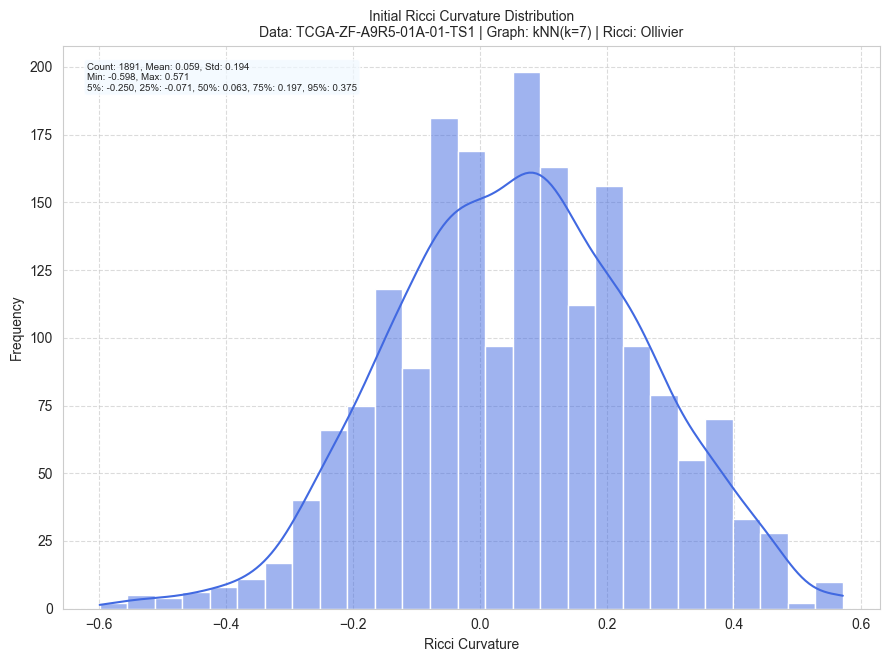


Applying Initial Surgery to TCGA-ZF-A9R5-01A-01-TS1: percentage_negative(0.05)...
  Initial surgery removed 34 edges from TCGA-ZF-A9R5-01A-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


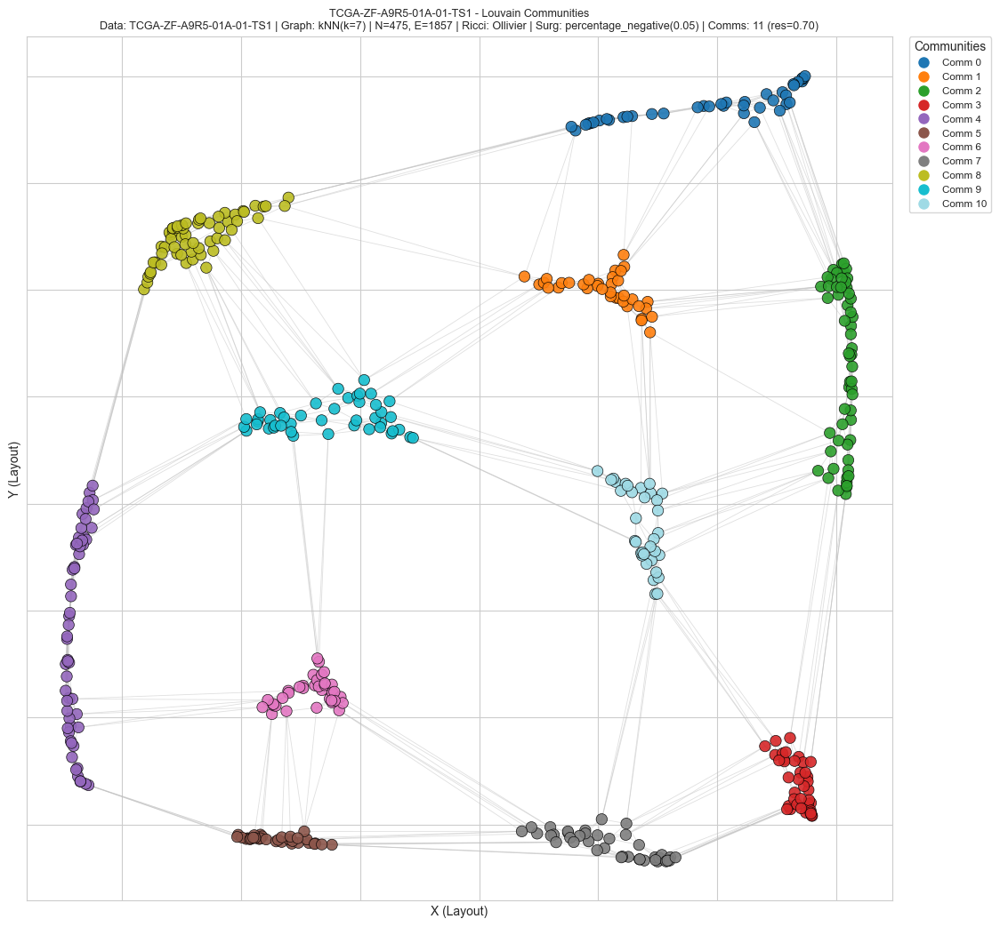

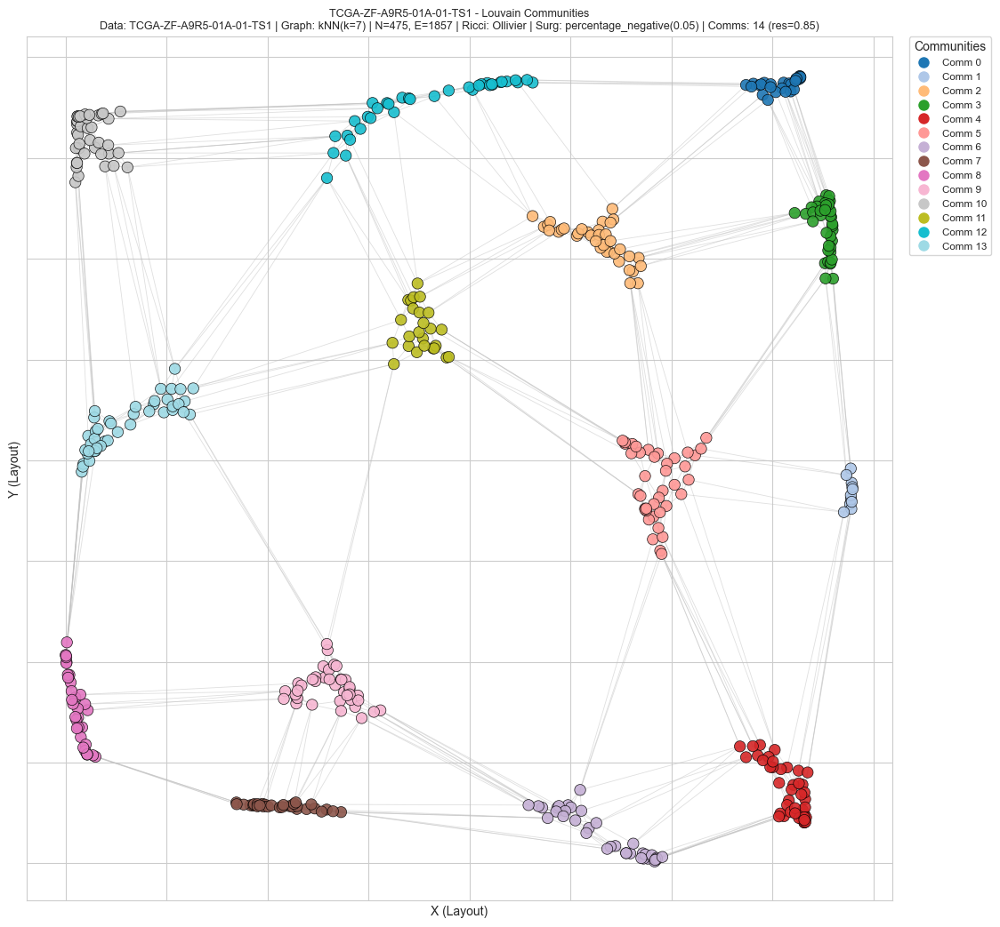

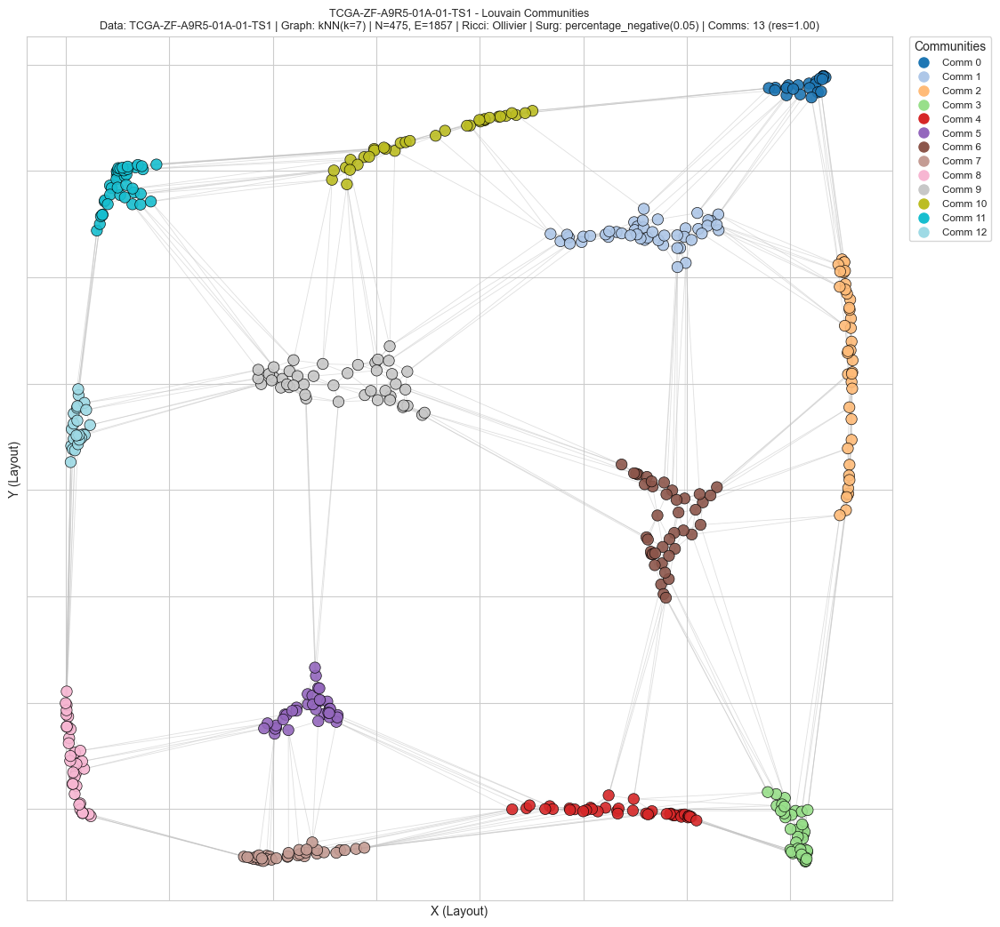


--- Starting Workflow for XML: MoNuSegTestData/TCGA-69-7764-01A-01-TS1.xml ---
Created output folder: output_file/Output_TCGA-69-7764-01A-01-TS1
  Extracted 441 centroids (Source: TCGA-69-7764-01A-01-TS1).
Initial graph (kNN(k=7)) for TCGA-69-7764-01A-01-TS1: 441N, 1789E
Computing Ollivier curvature for TCGA-69-7764-01A-01-TS1...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-69-7764-01A-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


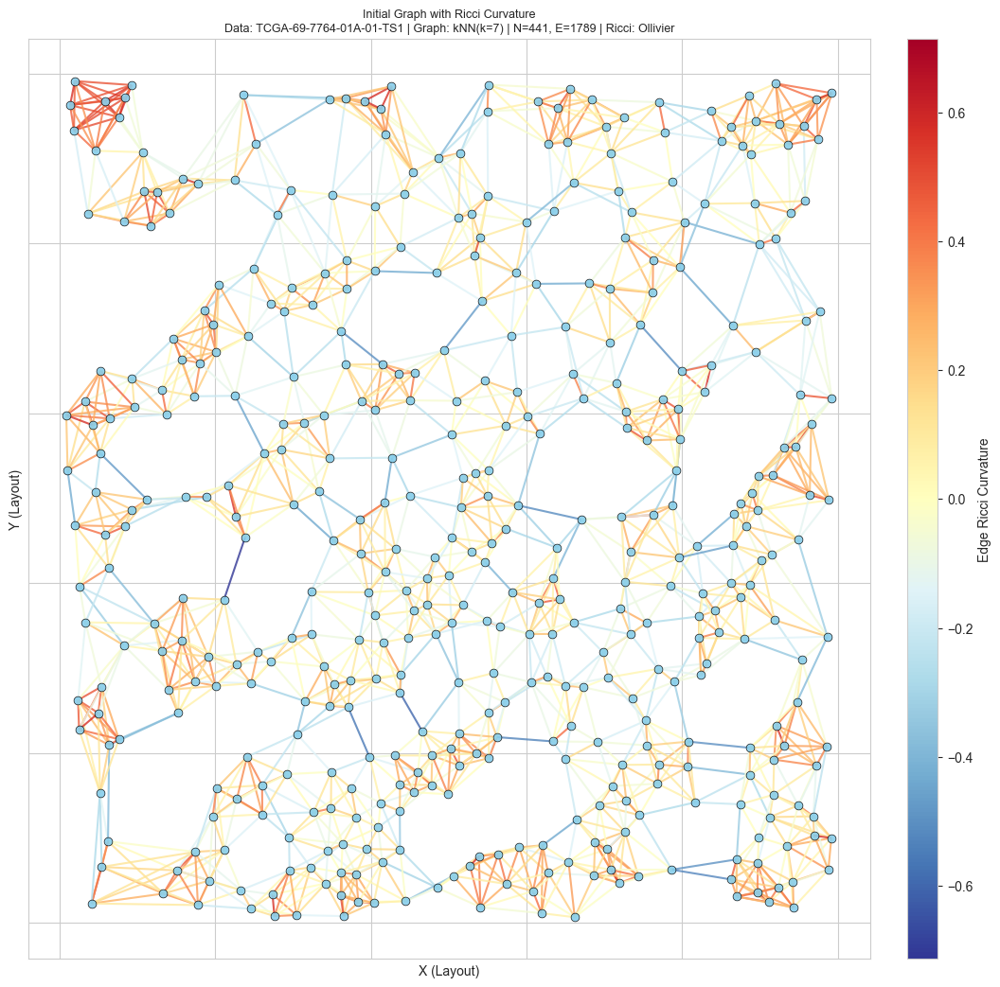

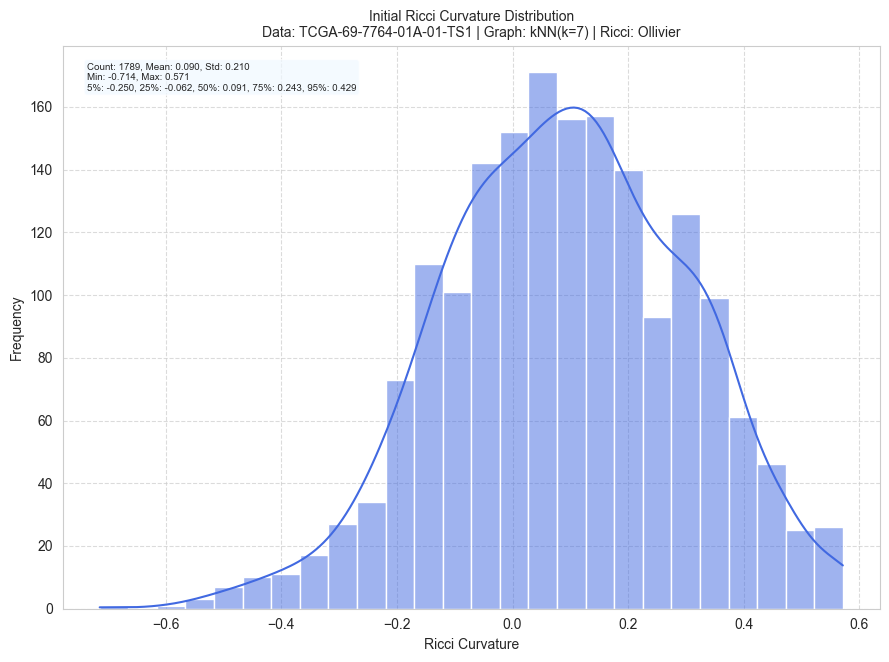


Applying Initial Surgery to TCGA-69-7764-01A-01-TS1: percentage_negative(0.05)...
  Initial surgery removed 29 edges from TCGA-69-7764-01A-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


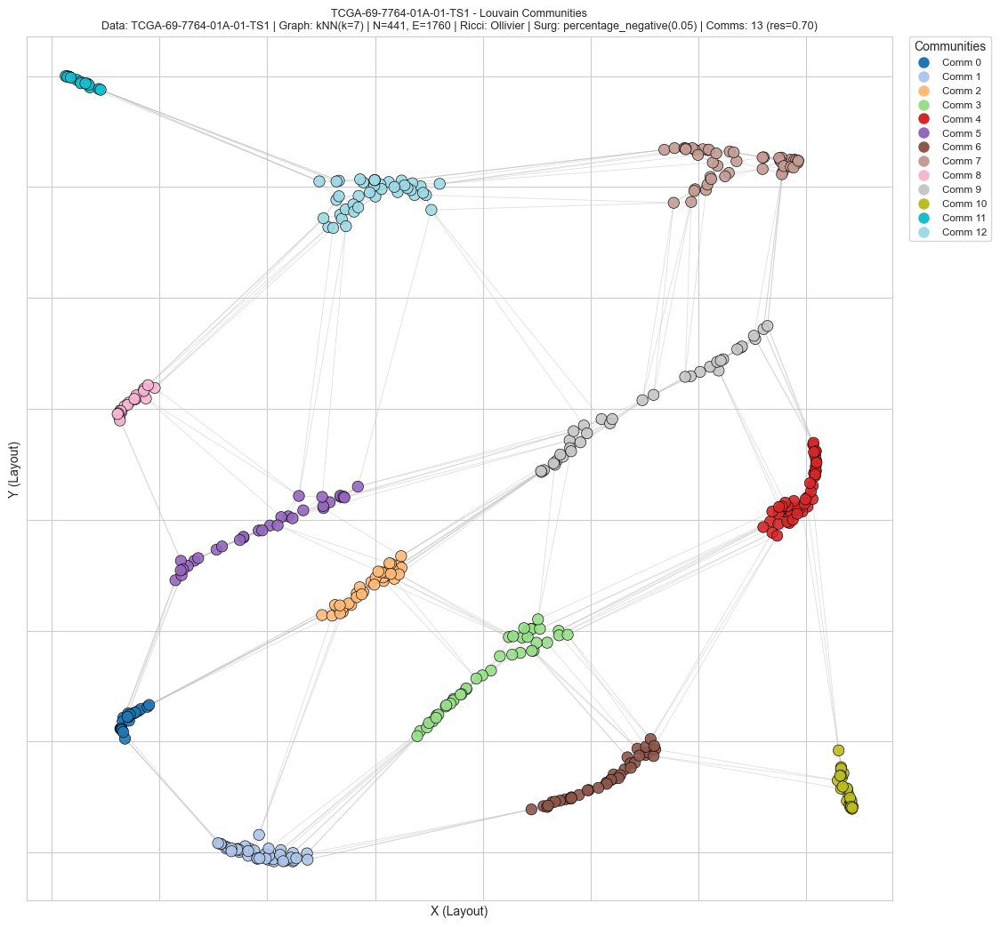

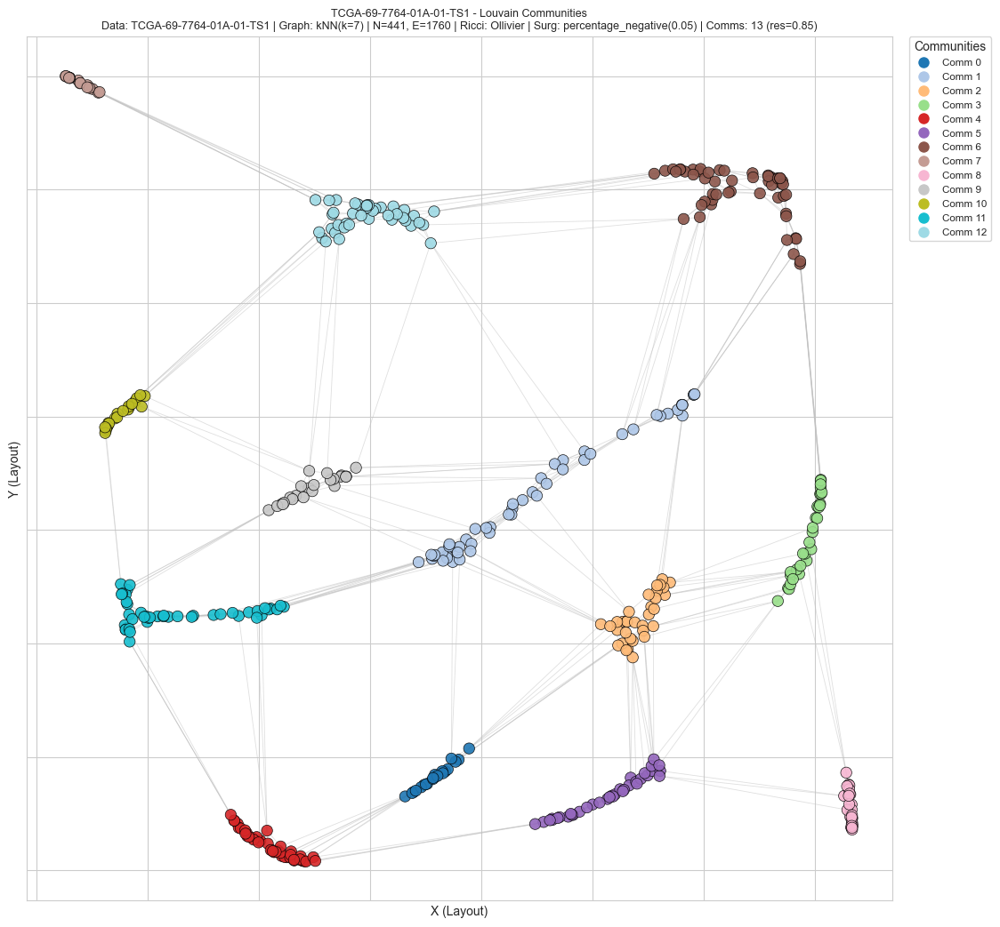

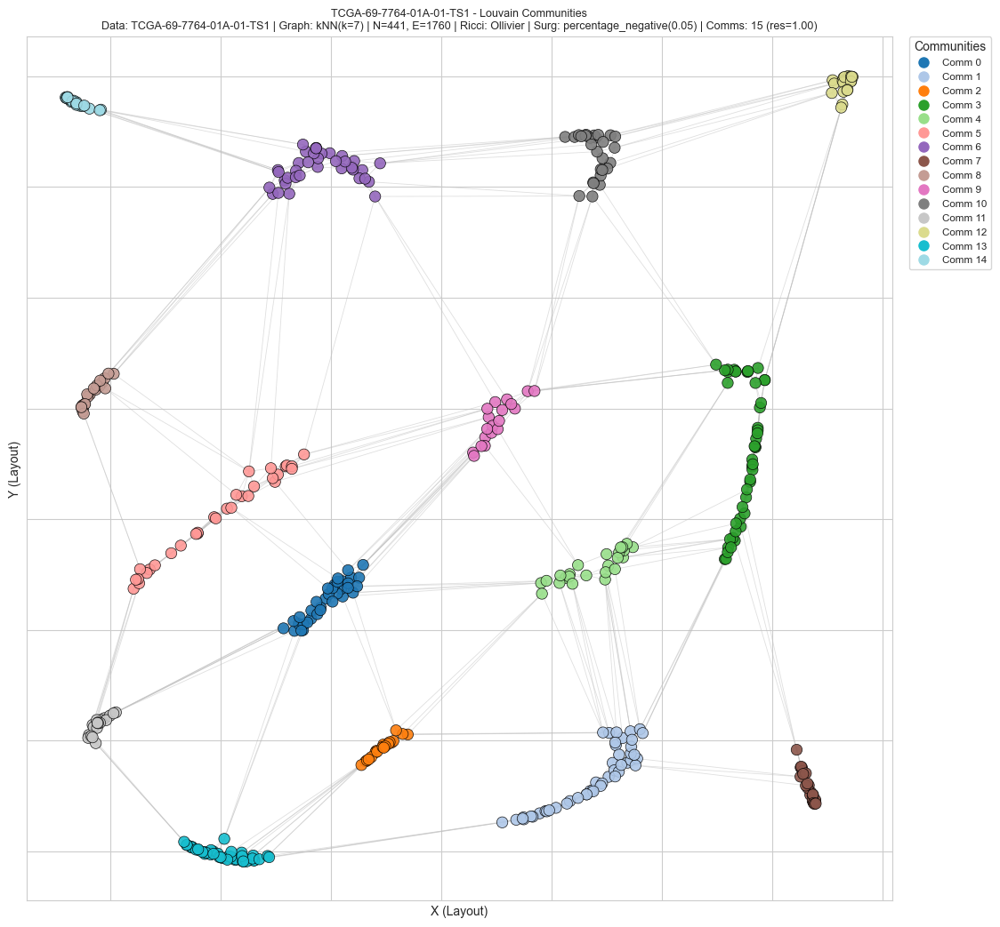


--- Starting Workflow for XML: MoNuSegTestData/TCGA-A6-6782-01A-01-BS1.xml ---
Created output folder: output_file/Output_TCGA-A6-6782-01A-01-BS1
  Extracted 441 centroids (Source: TCGA-A6-6782-01A-01-BS1).
Initial graph (kNN(k=7)) for TCGA-A6-6782-01A-01-BS1: 441N, 1797E
Computing Ollivier curvature for TCGA-A6-6782-01A-01-BS1...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-A6-6782-01A-01-BS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


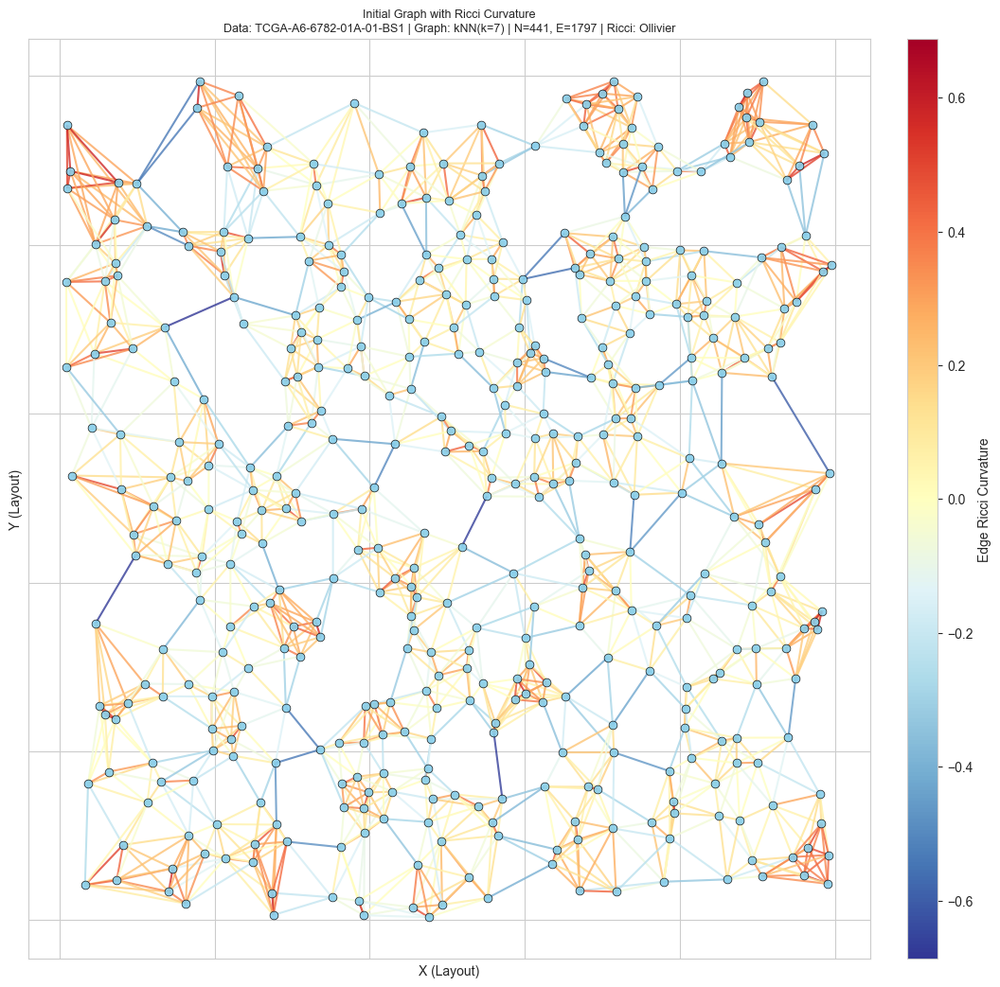

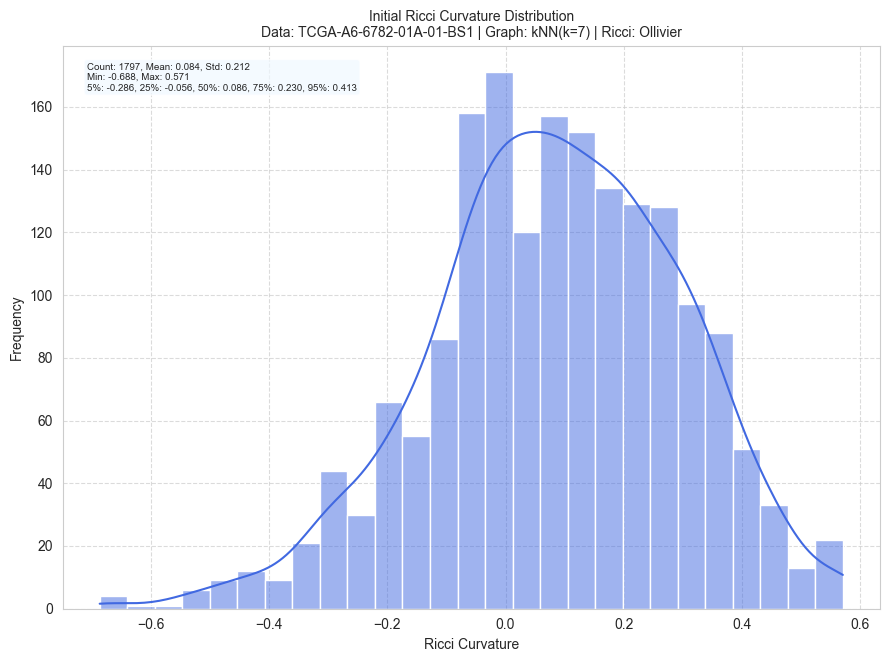


Applying Initial Surgery to TCGA-A6-6782-01A-01-BS1: percentage_negative(0.05)...
  Initial surgery removed 28 edges from TCGA-A6-6782-01A-01-BS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


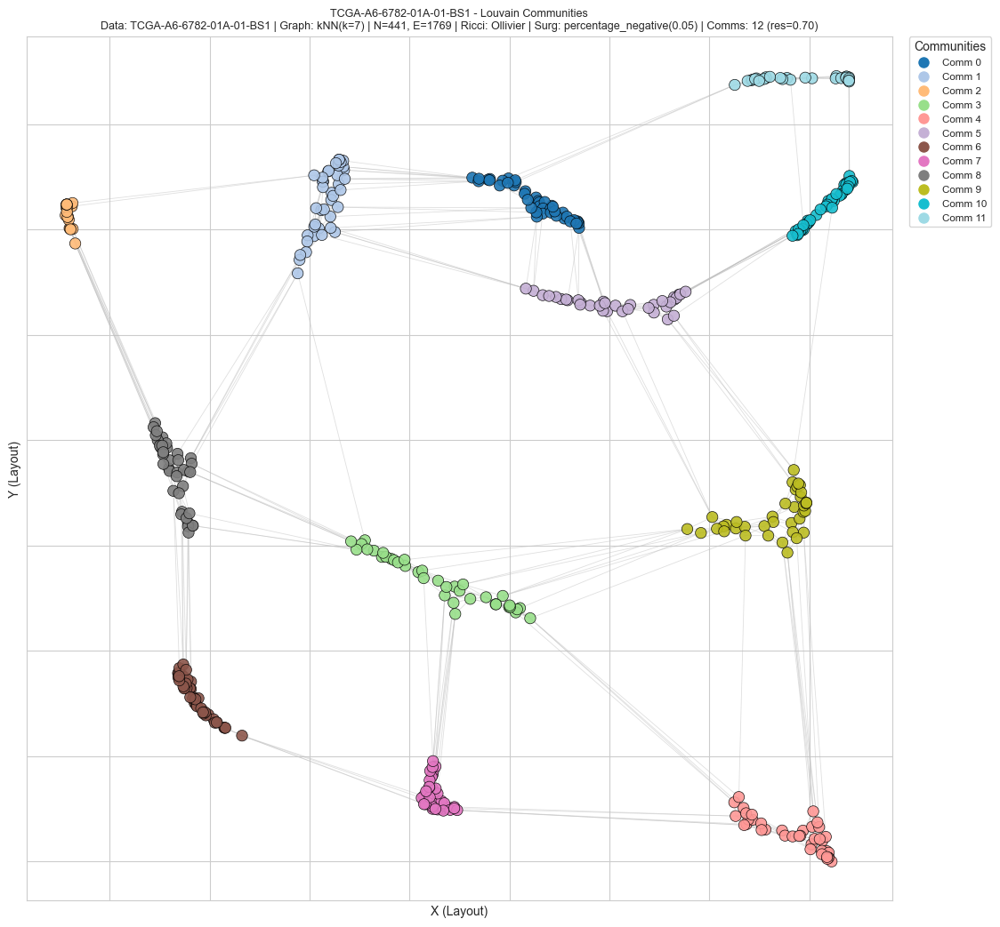

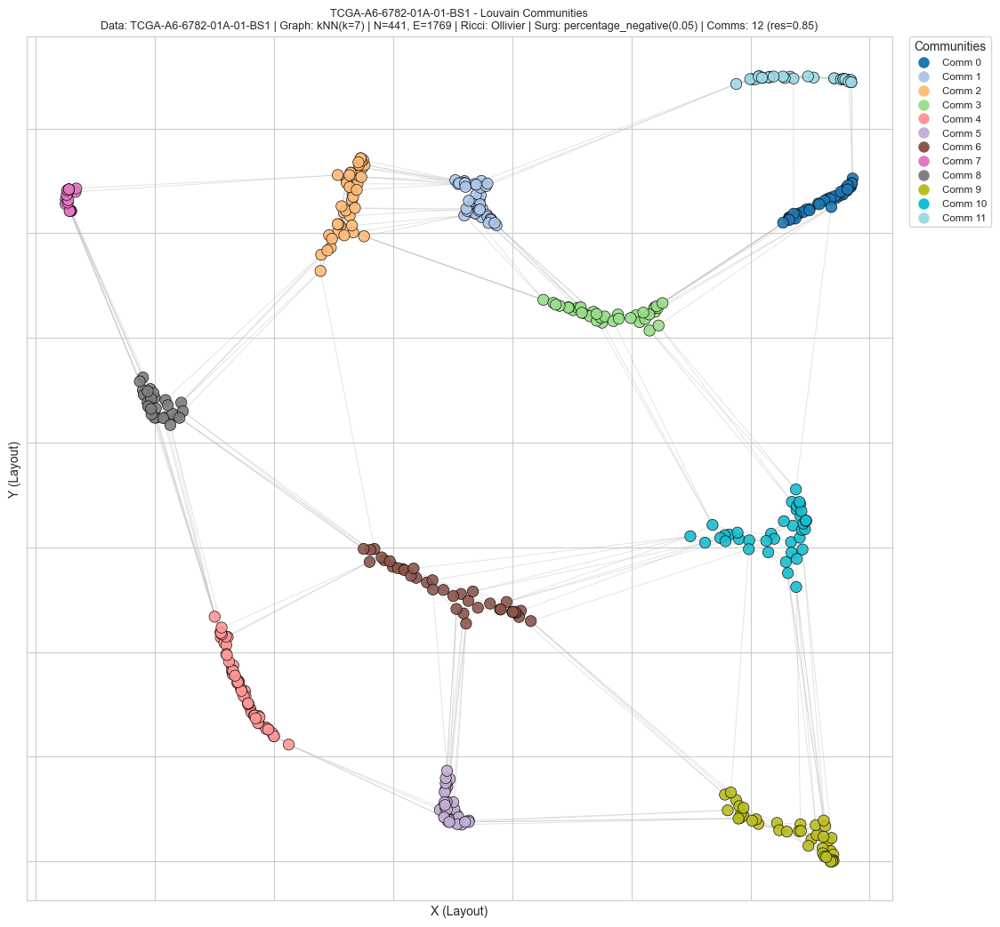

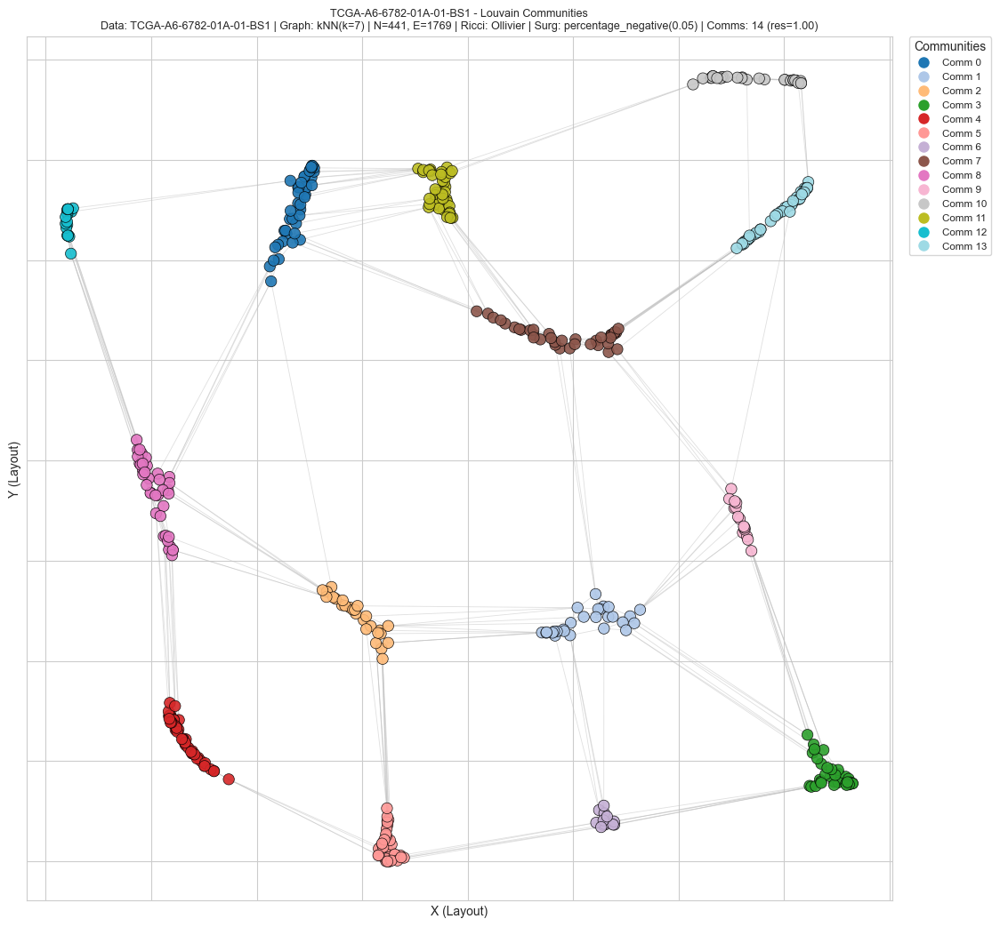


--- Starting Workflow for XML: MoNuSegTestData/TCGA-HT-8564-01Z-00-DX1.xml ---
Created output folder: output_file/Output_TCGA-HT-8564-01Z-00-DX1
  Extracted 249 centroids (Source: TCGA-HT-8564-01Z-00-DX1).
Initial graph (kNN(k=7)) for TCGA-HT-8564-01Z-00-DX1: 249N, 992E
Computing Ollivier curvature for TCGA-HT-8564-01Z-00-DX1...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-HT-8564-01Z-00-DX1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


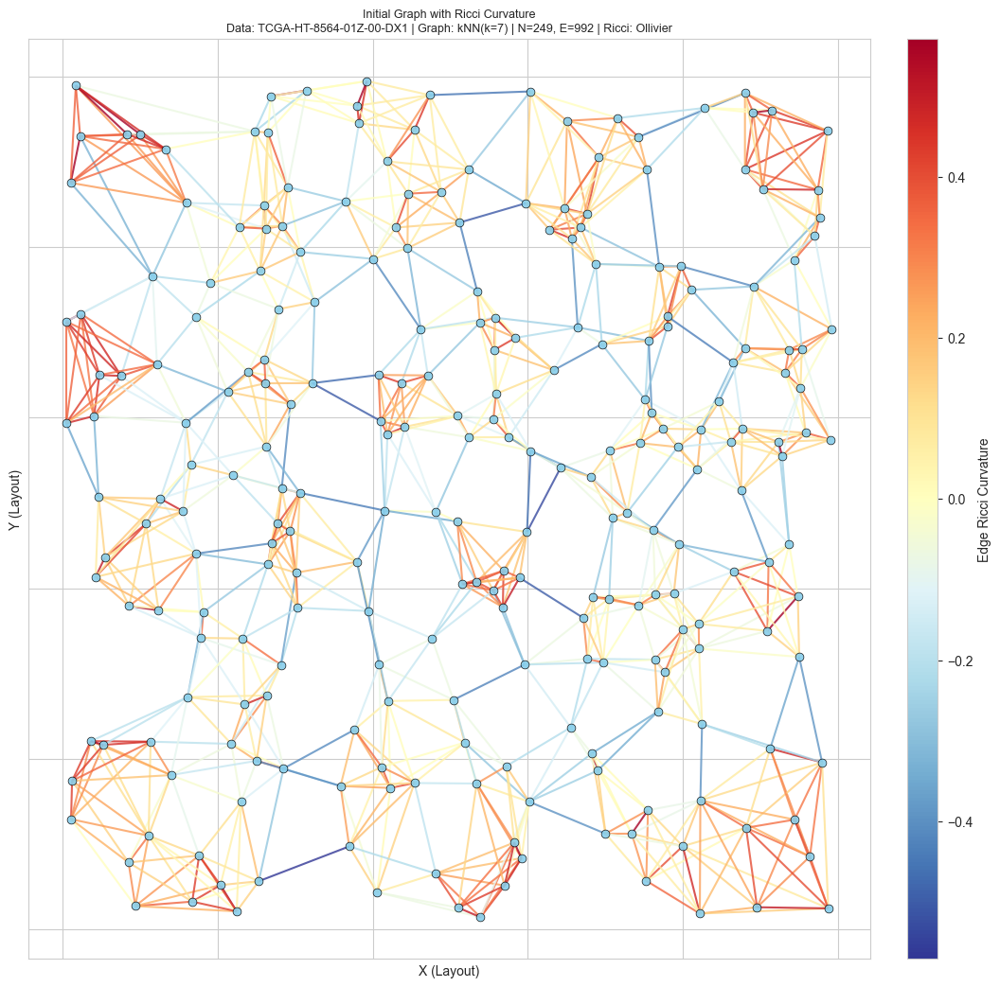

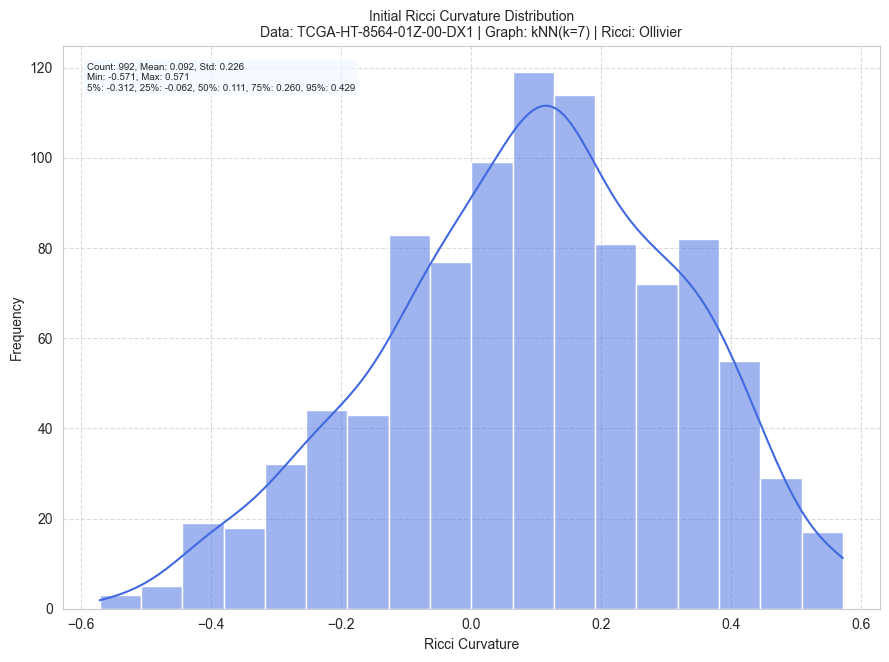


Applying Initial Surgery to TCGA-HT-8564-01Z-00-DX1: percentage_negative(0.05)...
  Initial surgery removed 15 edges from TCGA-HT-8564-01Z-00-DX1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


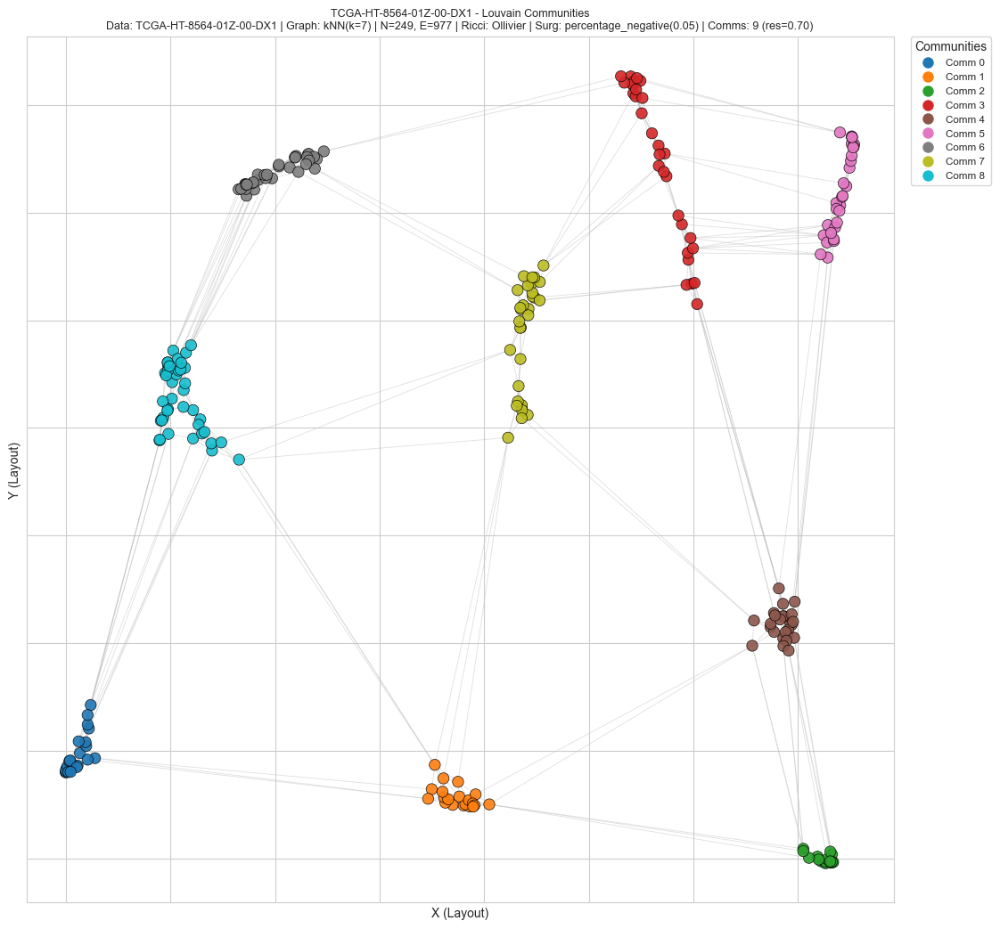

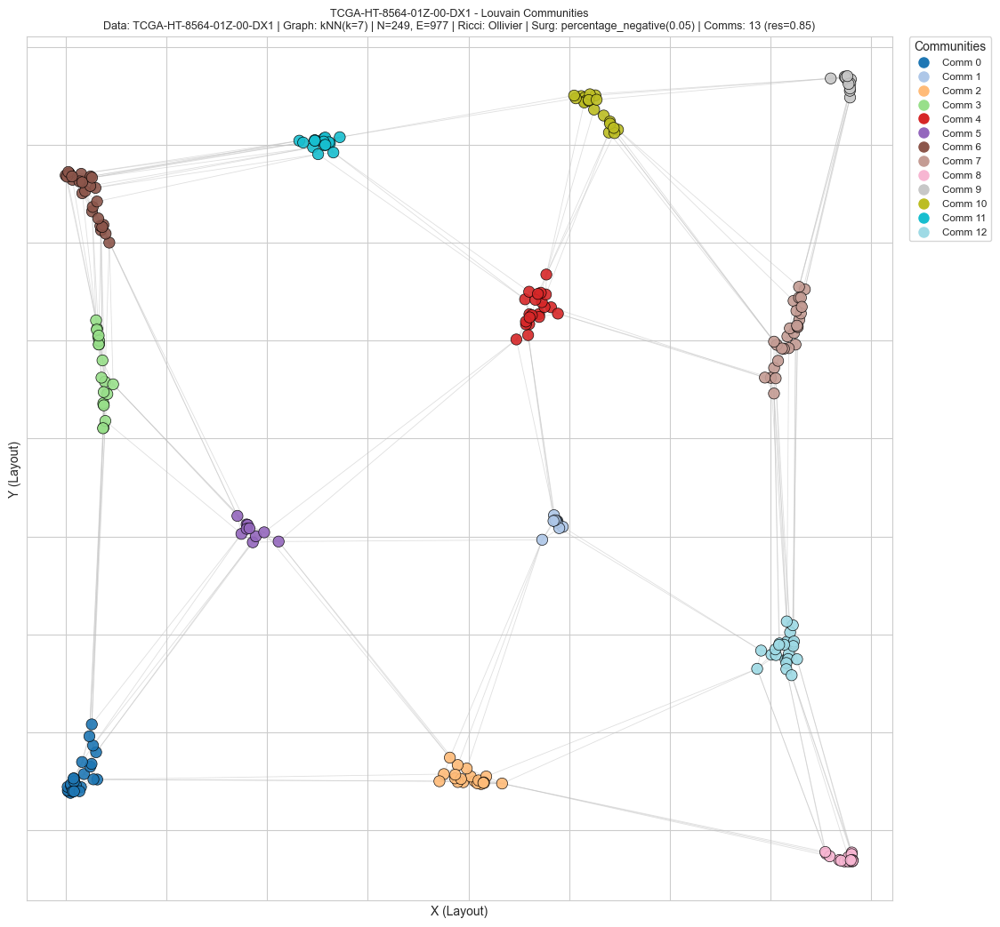

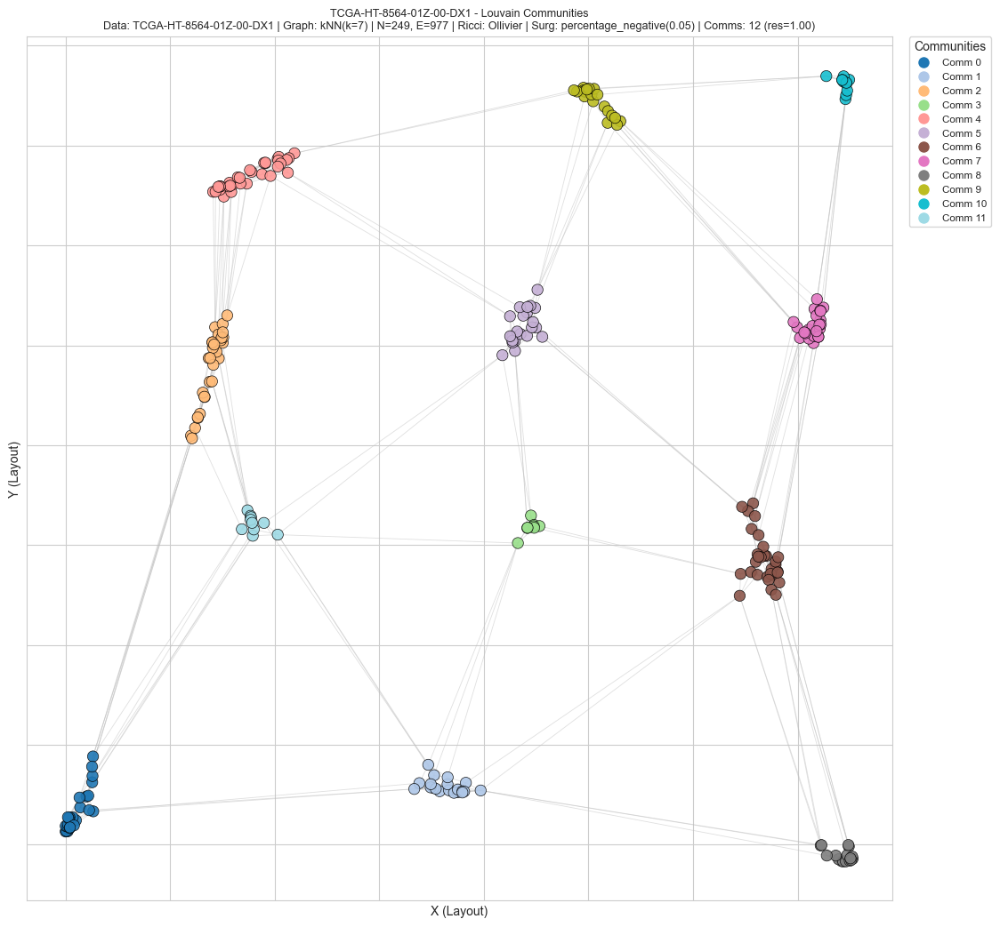


--- Starting Workflow for XML: MoNuSegTestData/TCGA-IZ-8196-01A-01-BS1.xml ---
Created output folder: output_file/Output_TCGA-IZ-8196-01A-01-BS1
  Extracted 533 centroids (Source: TCGA-IZ-8196-01A-01-BS1).
Initial graph (kNN(k=7)) for TCGA-IZ-8196-01A-01-BS1: 533N, 2139E
Computing Ollivier curvature for TCGA-IZ-8196-01A-01-BS1...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-IZ-8196-01A-01-BS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


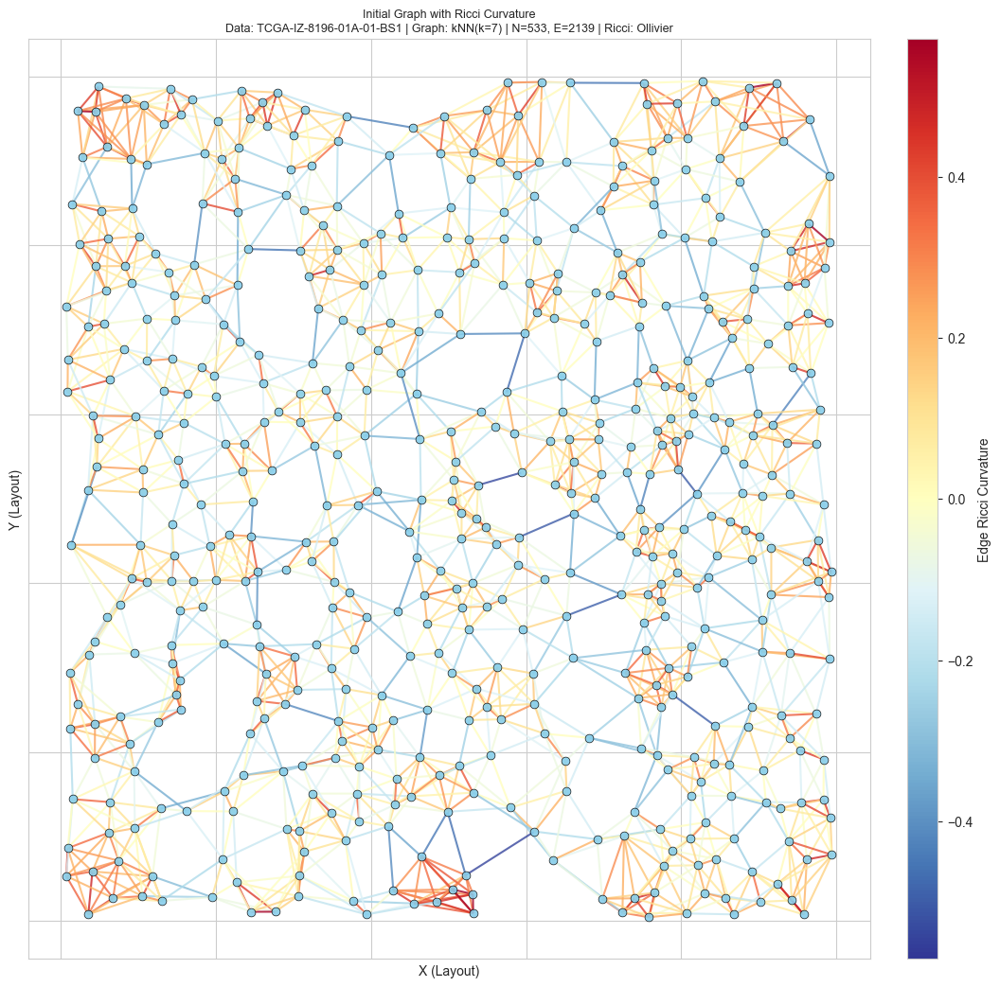

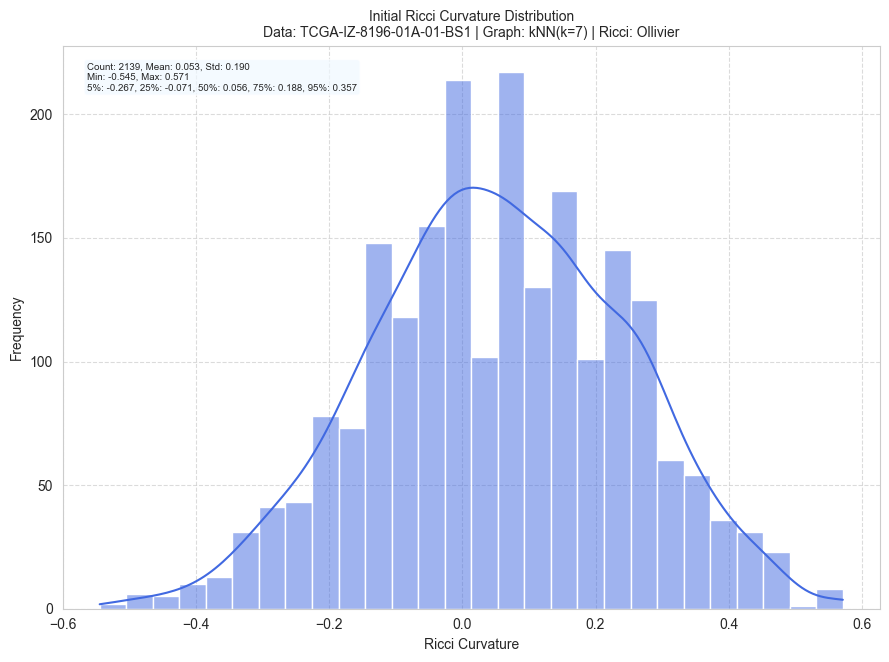


Applying Initial Surgery to TCGA-IZ-8196-01A-01-BS1: percentage_negative(0.05)...
  Initial surgery removed 40 edges from TCGA-IZ-8196-01A-01-BS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


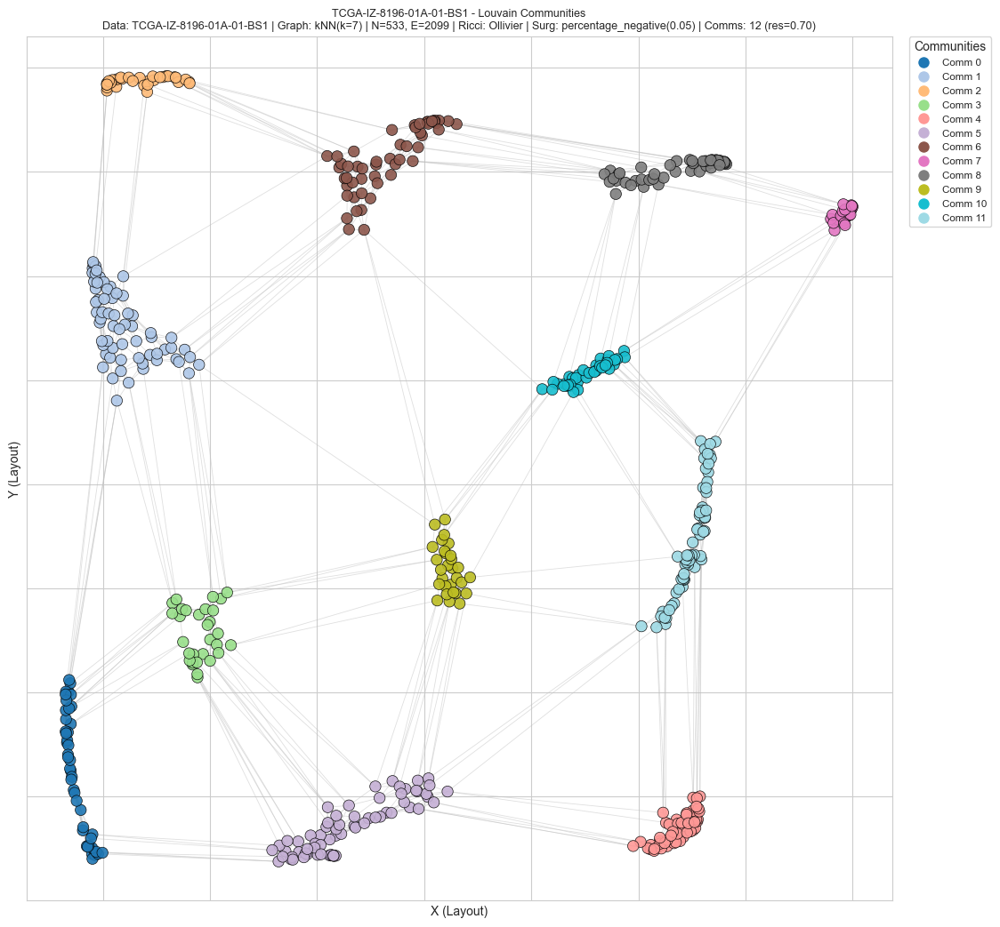

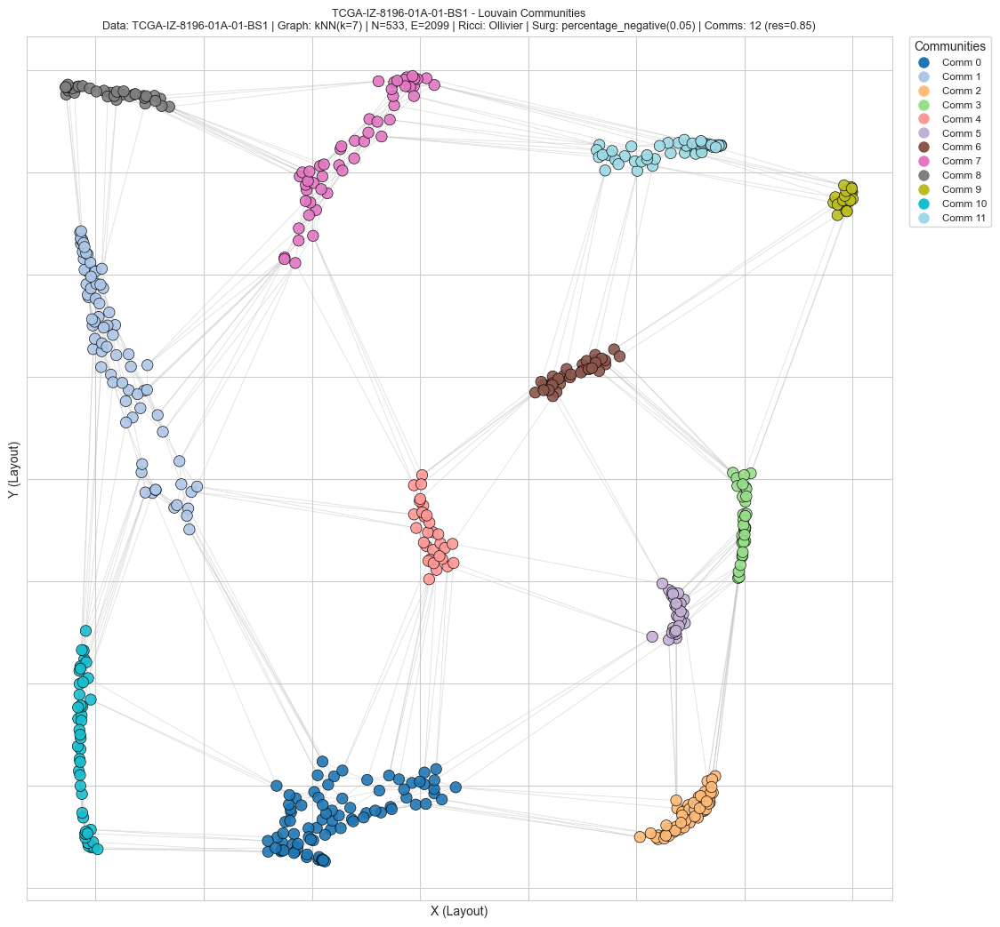

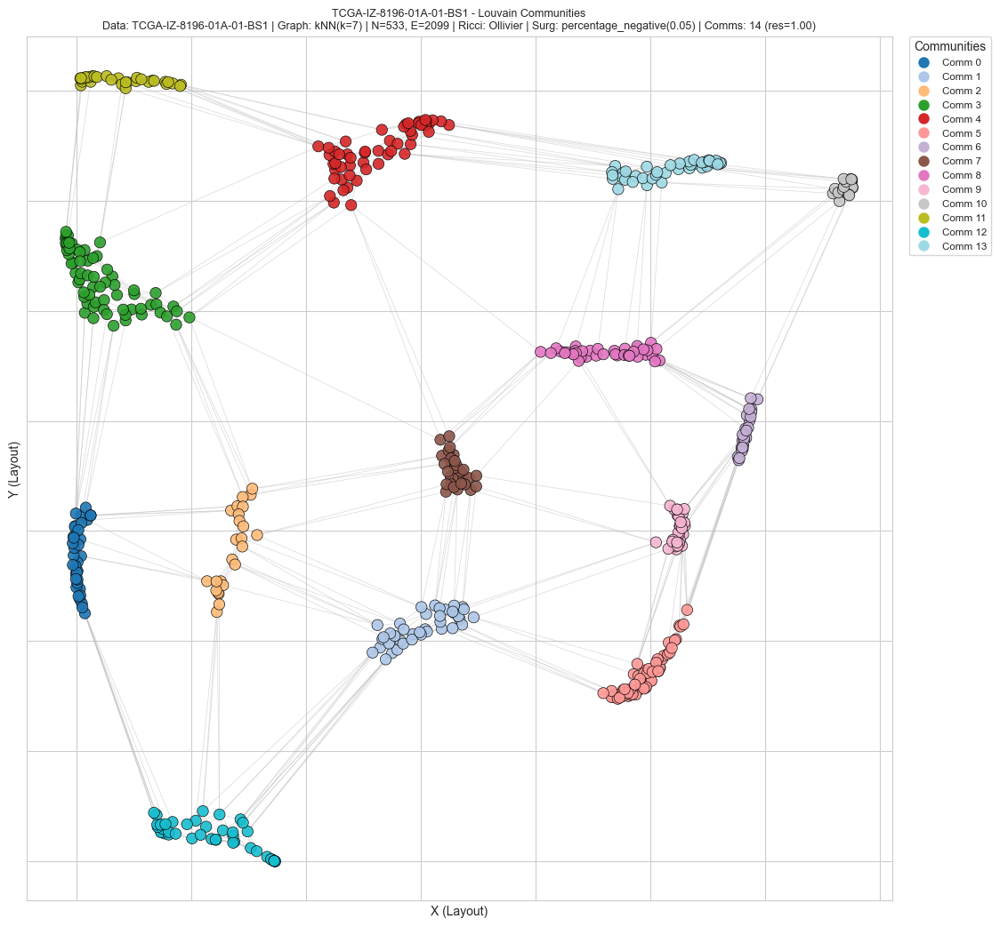


--- Starting Workflow for XML: MoNuSegTestData/TCGA-AO-A0J2-01A-01-BSA.xml ---
Created output folder: output_file/Output_TCGA-AO-A0J2-01A-01-BSA
  Extracted 356 centroids (Source: TCGA-AO-A0J2-01A-01-BSA).
Initial graph (kNN(k=7)) for TCGA-AO-A0J2-01A-01-BSA: 356N, 1426E
Computing Ollivier curvature for TCGA-AO-A0J2-01A-01-BSA...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-AO-A0J2-01A-01-BSA.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


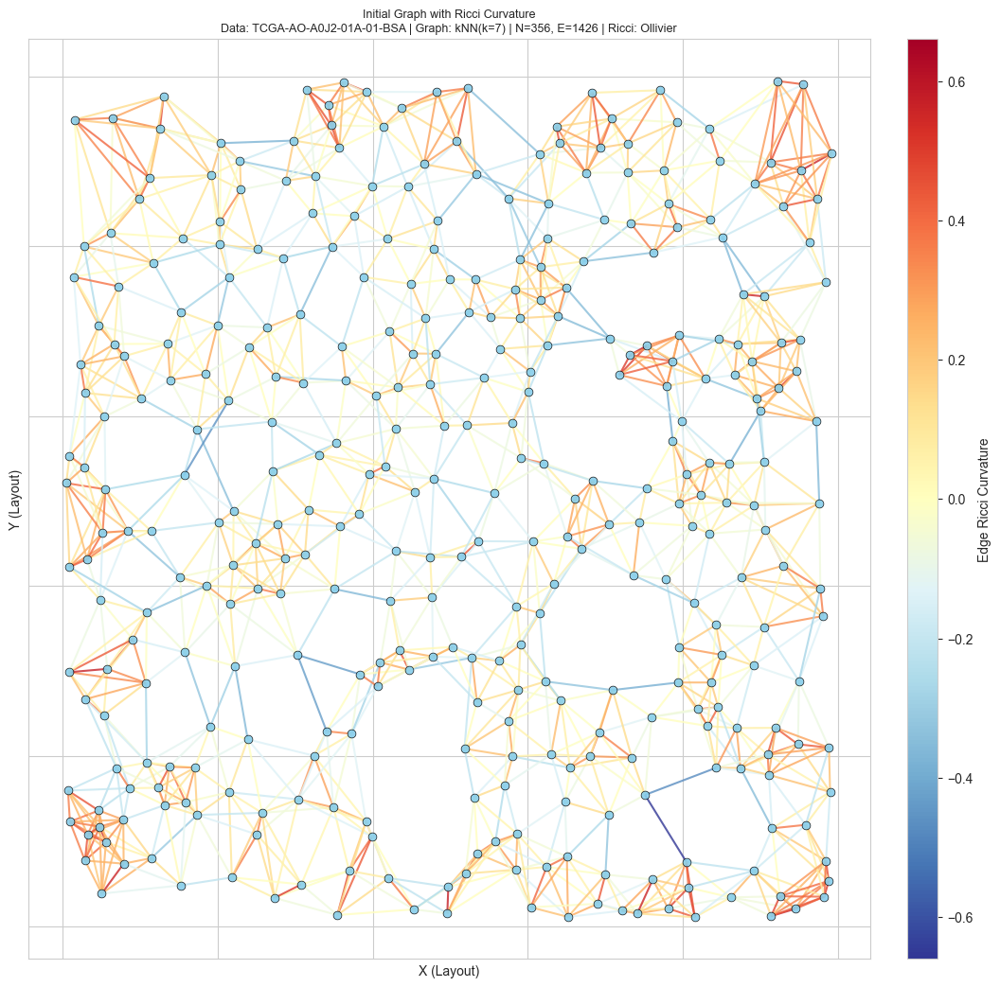

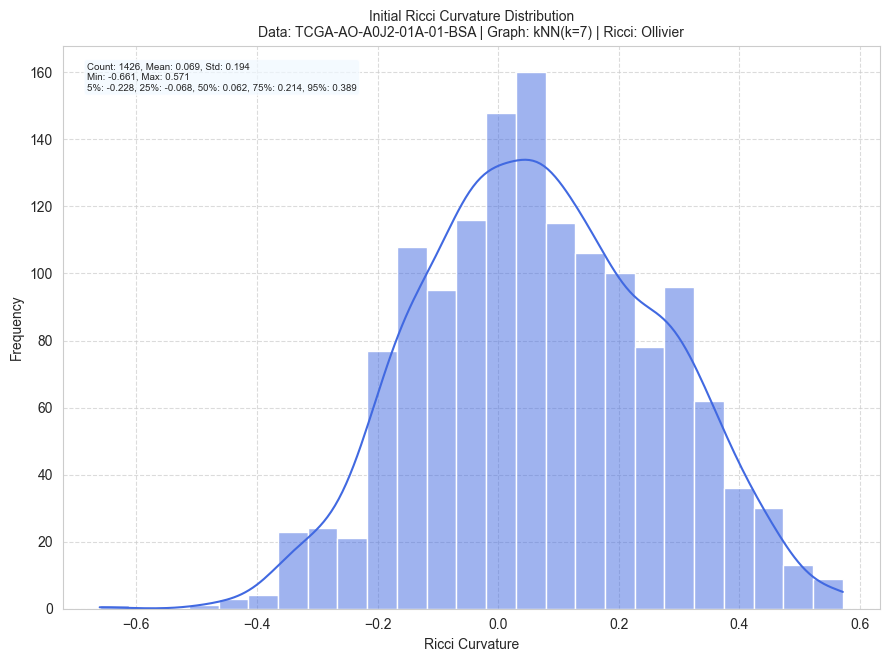


Applying Initial Surgery to TCGA-AO-A0J2-01A-01-BSA: percentage_negative(0.05)...
  Initial surgery removed 26 edges from TCGA-AO-A0J2-01A-01-BSA.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


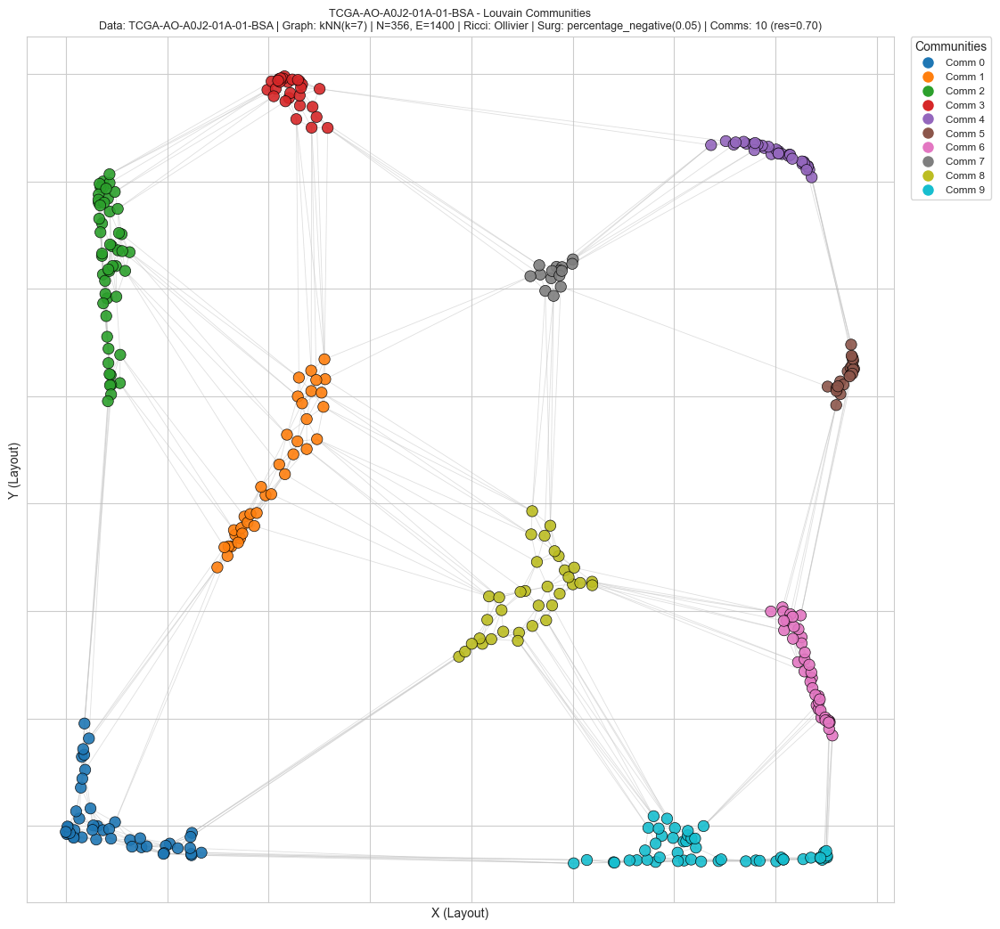

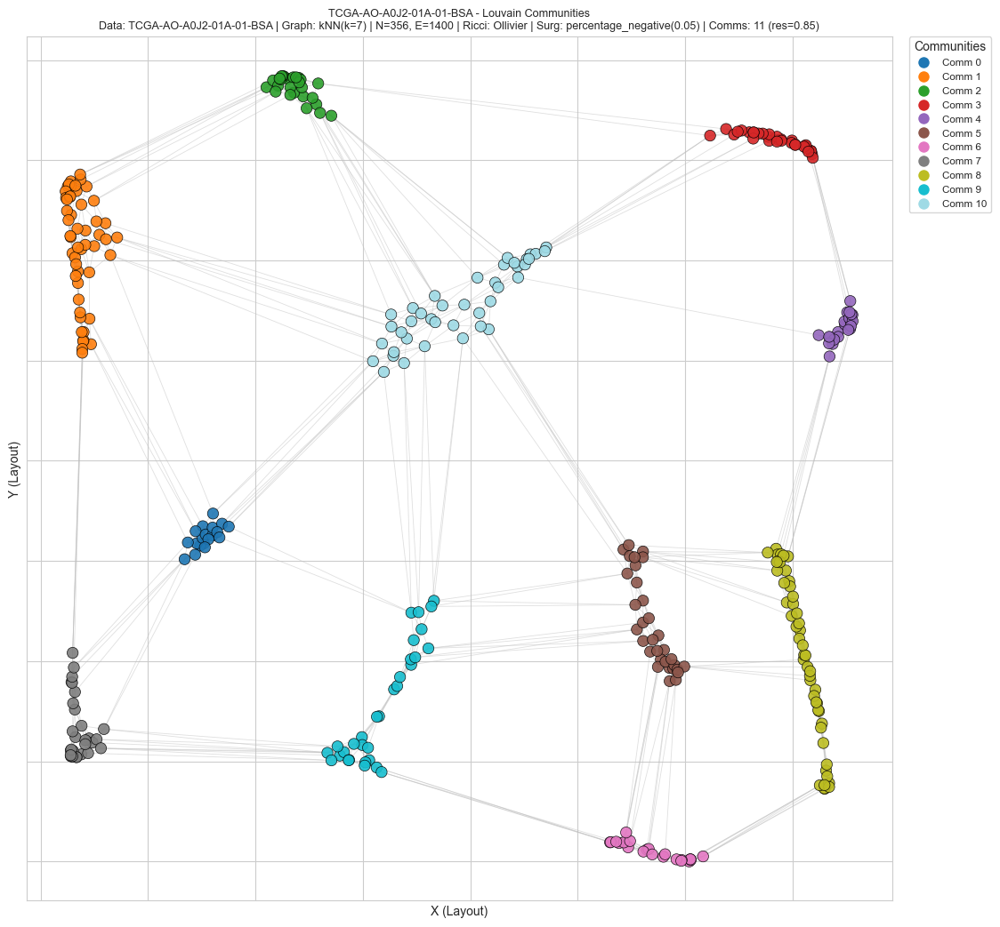

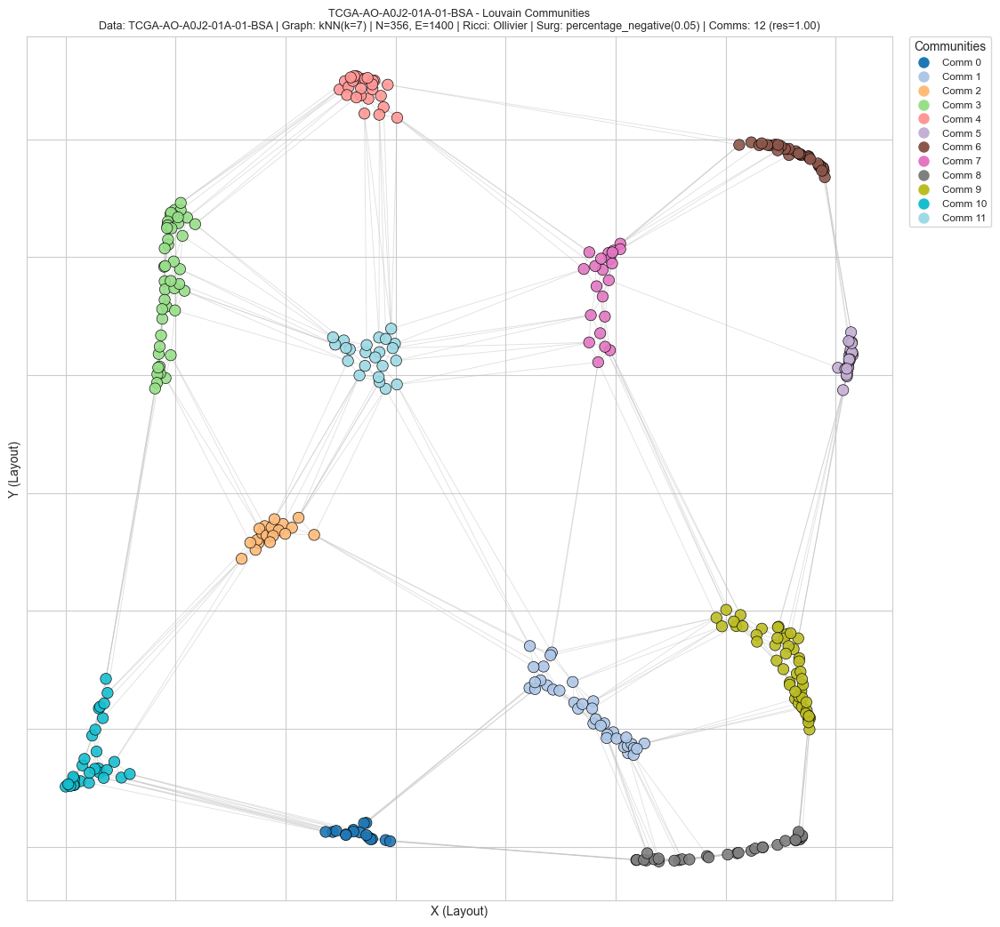


--- Starting Workflow for XML: MoNuSegTestData/TCGA-CU-A0YN-01A-02-BSB.xml ---
Created output folder: output_file/Output_TCGA-CU-A0YN-01A-02-BSB
  Extracted 677 centroids (Source: TCGA-CU-A0YN-01A-02-BSB).
Initial graph (kNN(k=7)) for TCGA-CU-A0YN-01A-02-BSB: 677N, 2732E
Computing Ollivier curvature for TCGA-CU-A0YN-01A-02-BSB...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-CU-A0YN-01A-02-BSB.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


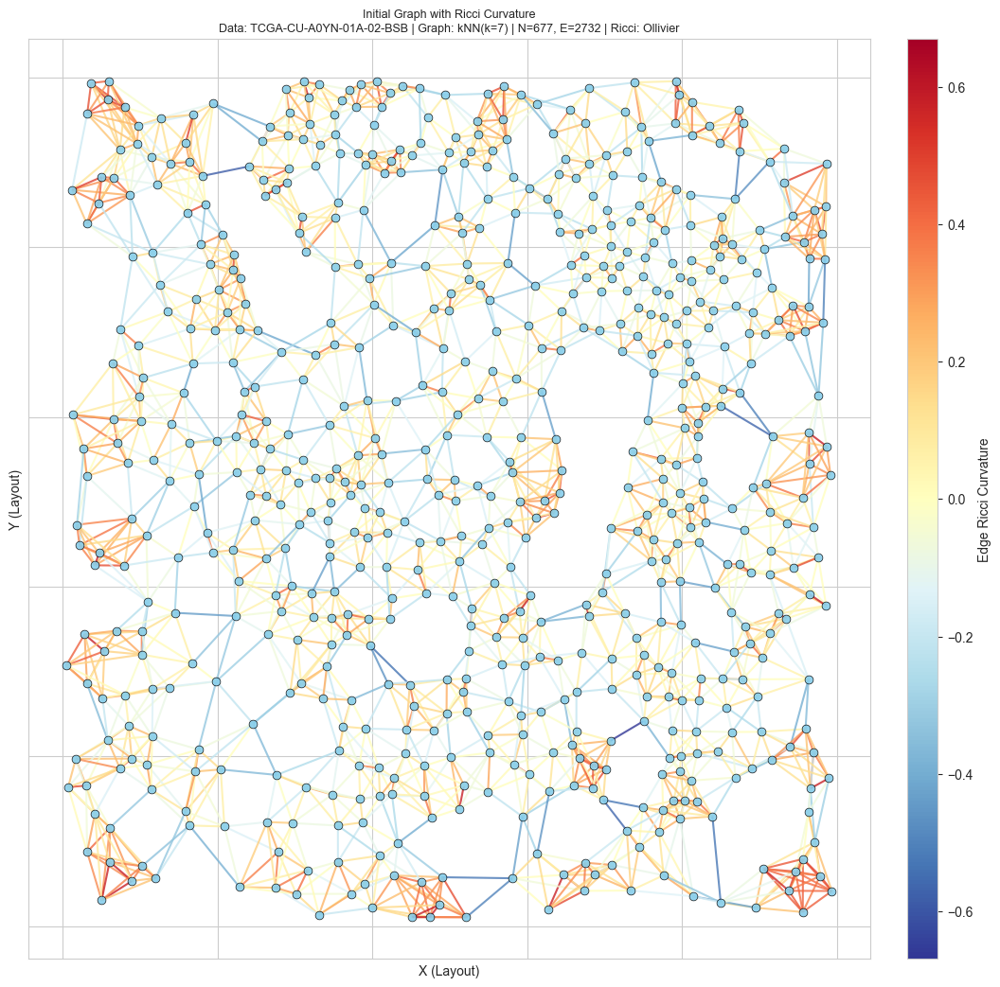

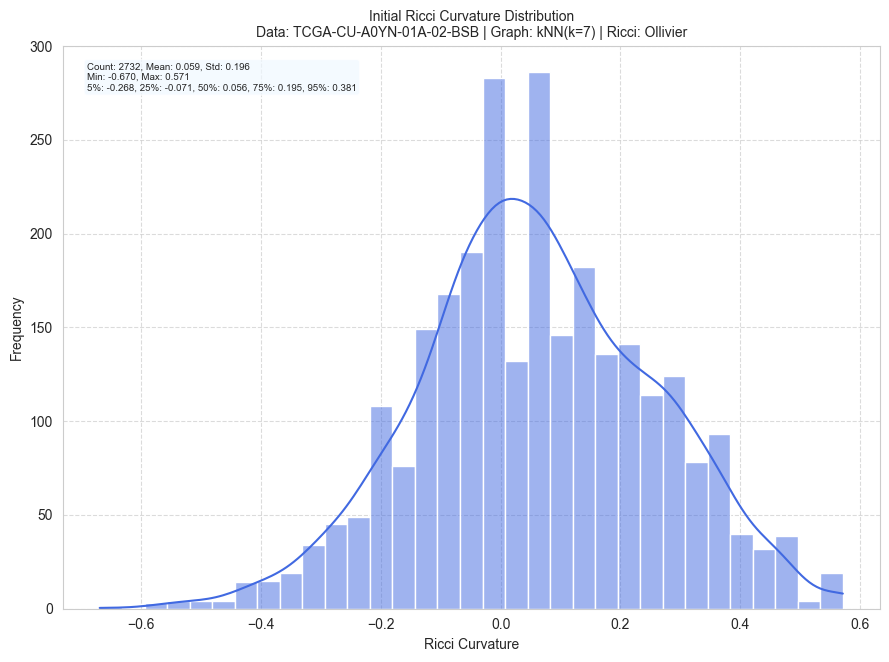


Applying Initial Surgery to TCGA-CU-A0YN-01A-02-BSB: percentage_negative(0.05)...
  Initial surgery removed 50 edges from TCGA-CU-A0YN-01A-02-BSB.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


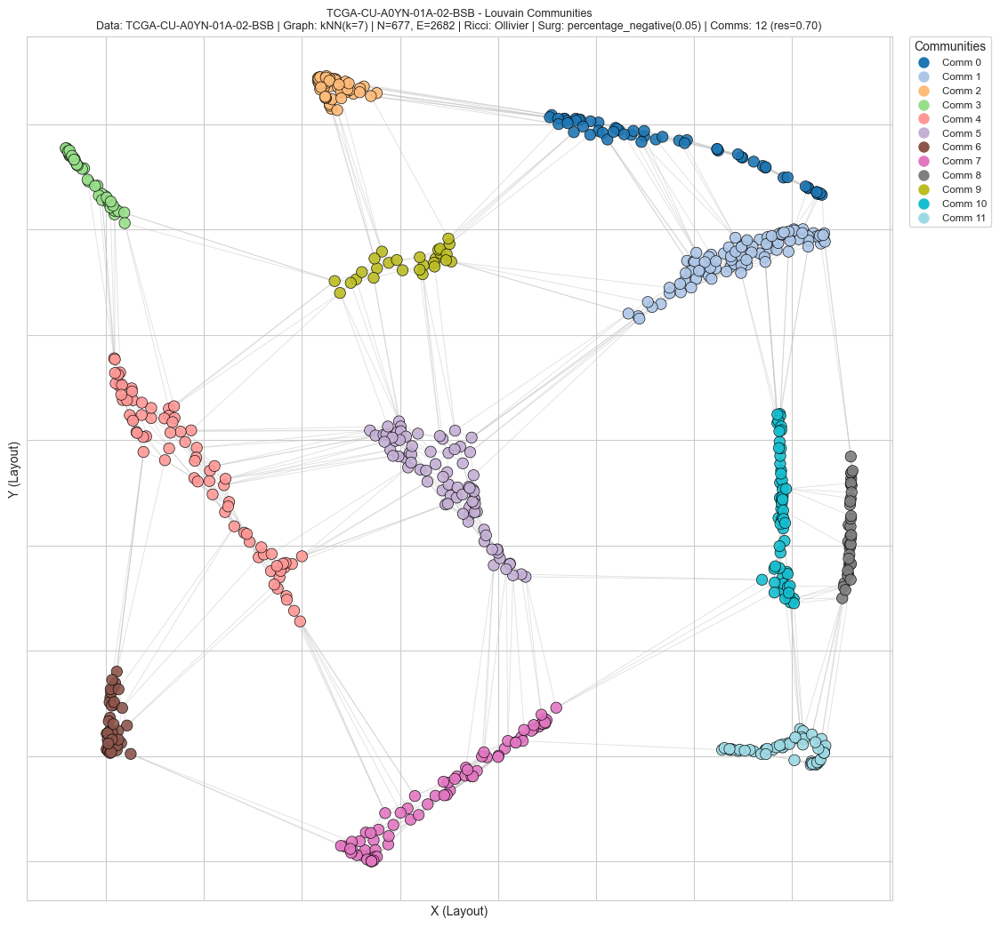

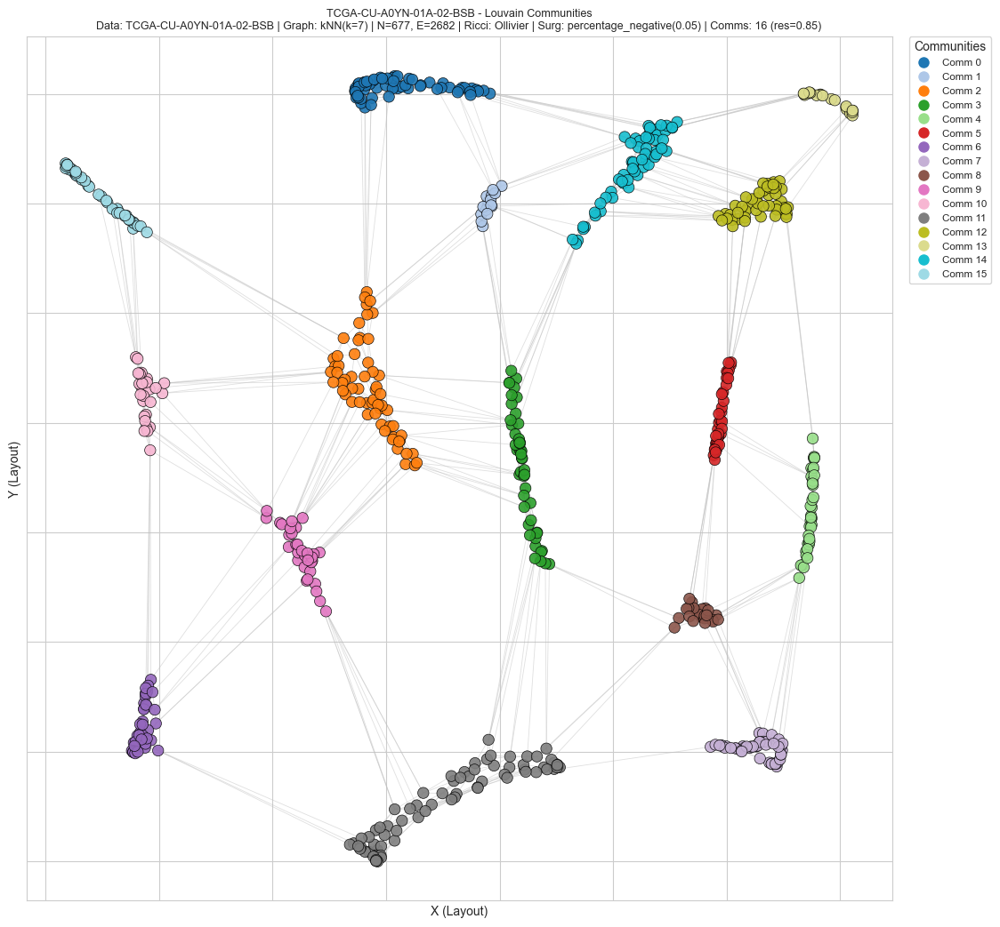

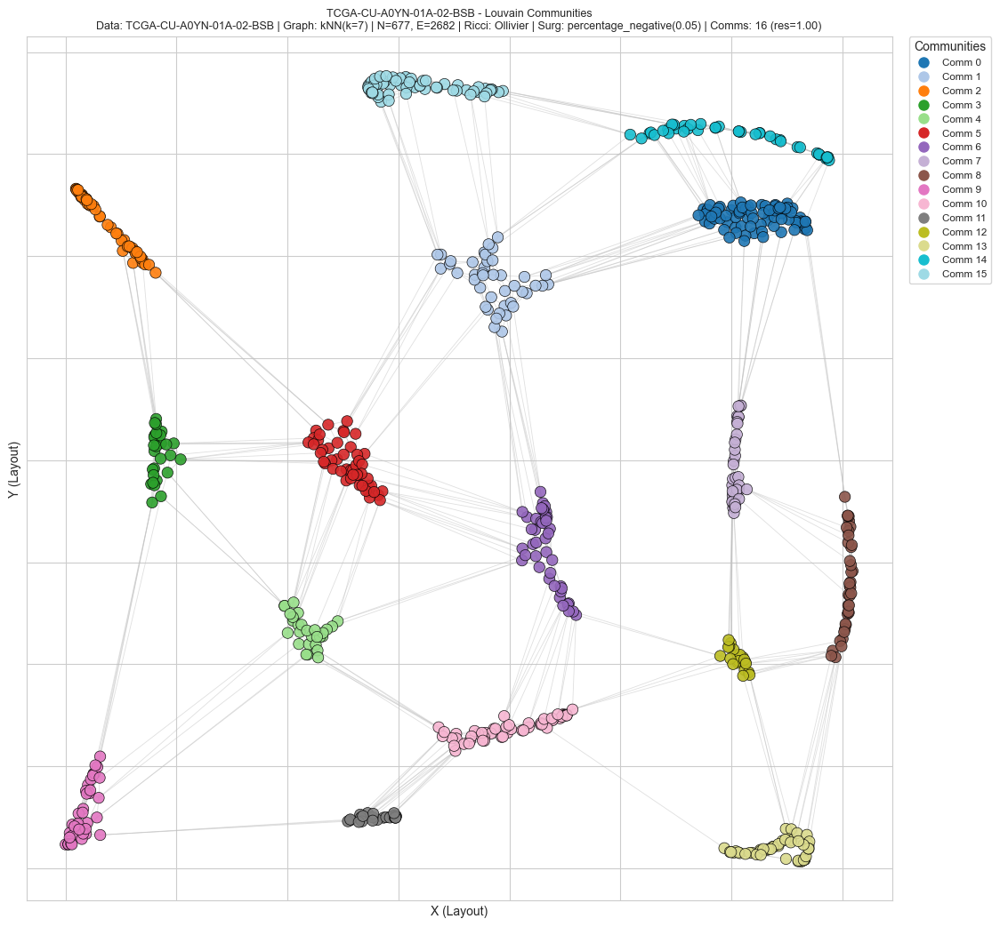


--- Starting Workflow for XML: MoNuSegTestData/TCGA-AC-A2FO-01A-01-TS1.xml ---
Created output folder: output_file/Output_TCGA-AC-A2FO-01A-01-TS1
  Extracted 521 centroids (Source: TCGA-AC-A2FO-01A-01-TS1).
Initial graph (kNN(k=7)) for TCGA-AC-A2FO-01A-01-TS1: 521N, 2107E
Computing Ollivier curvature for TCGA-AC-A2FO-01A-01-TS1...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-AC-A2FO-01A-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


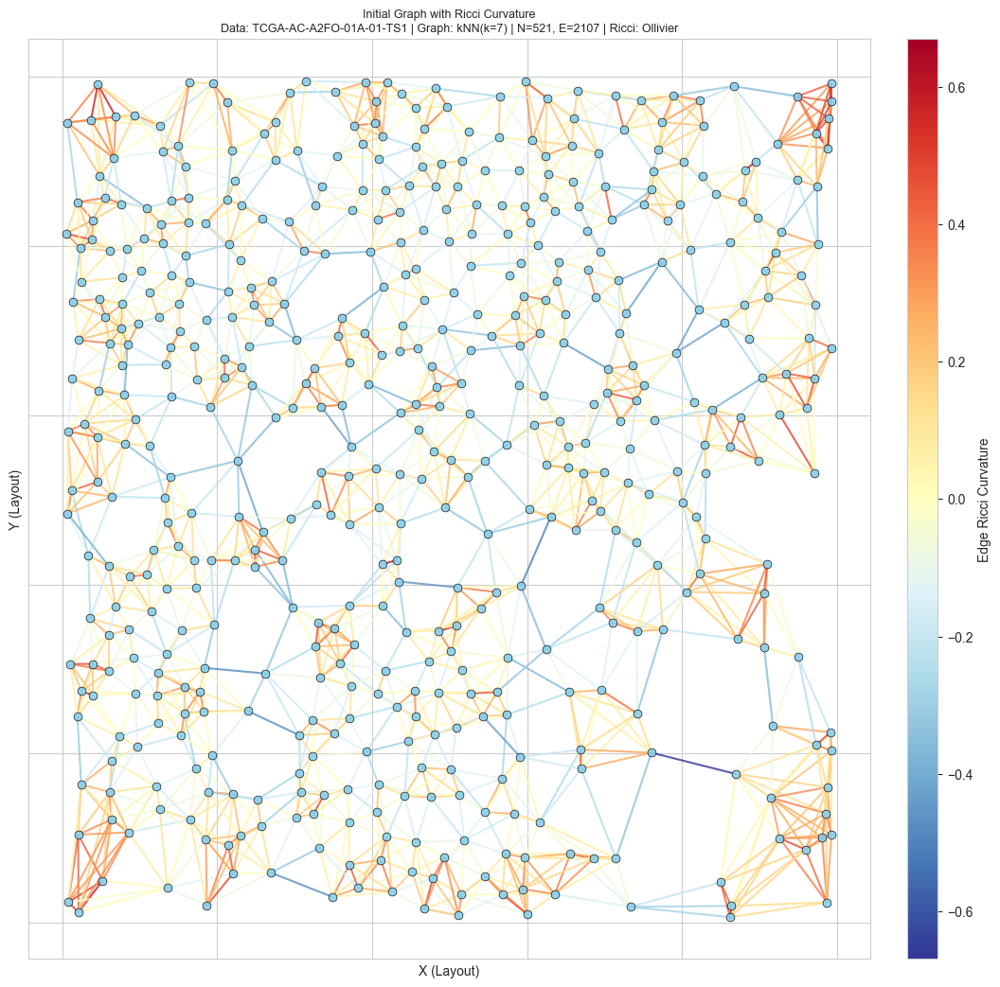

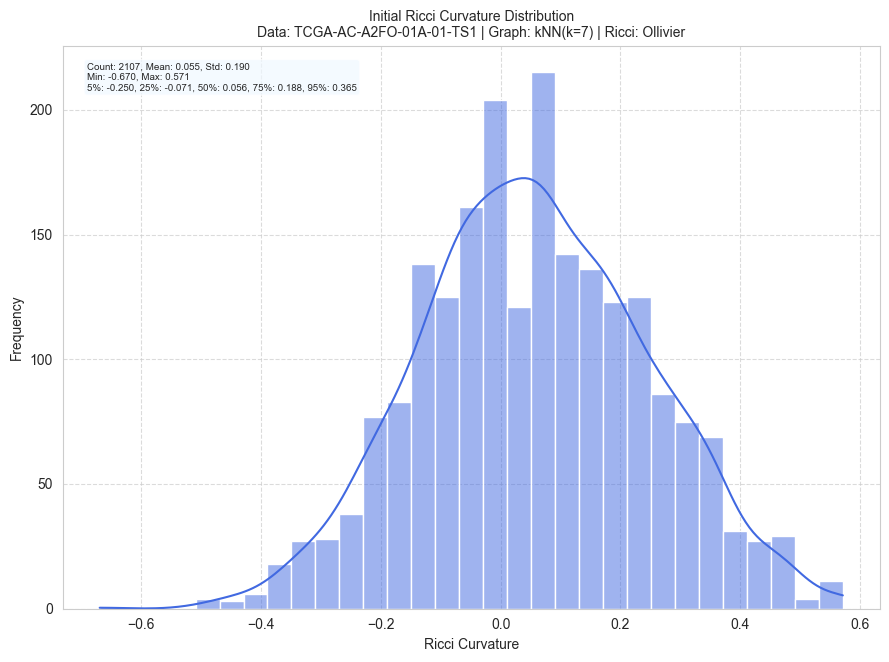


Applying Initial Surgery to TCGA-AC-A2FO-01A-01-TS1: percentage_negative(0.05)...
  Initial surgery removed 40 edges from TCGA-AC-A2FO-01A-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


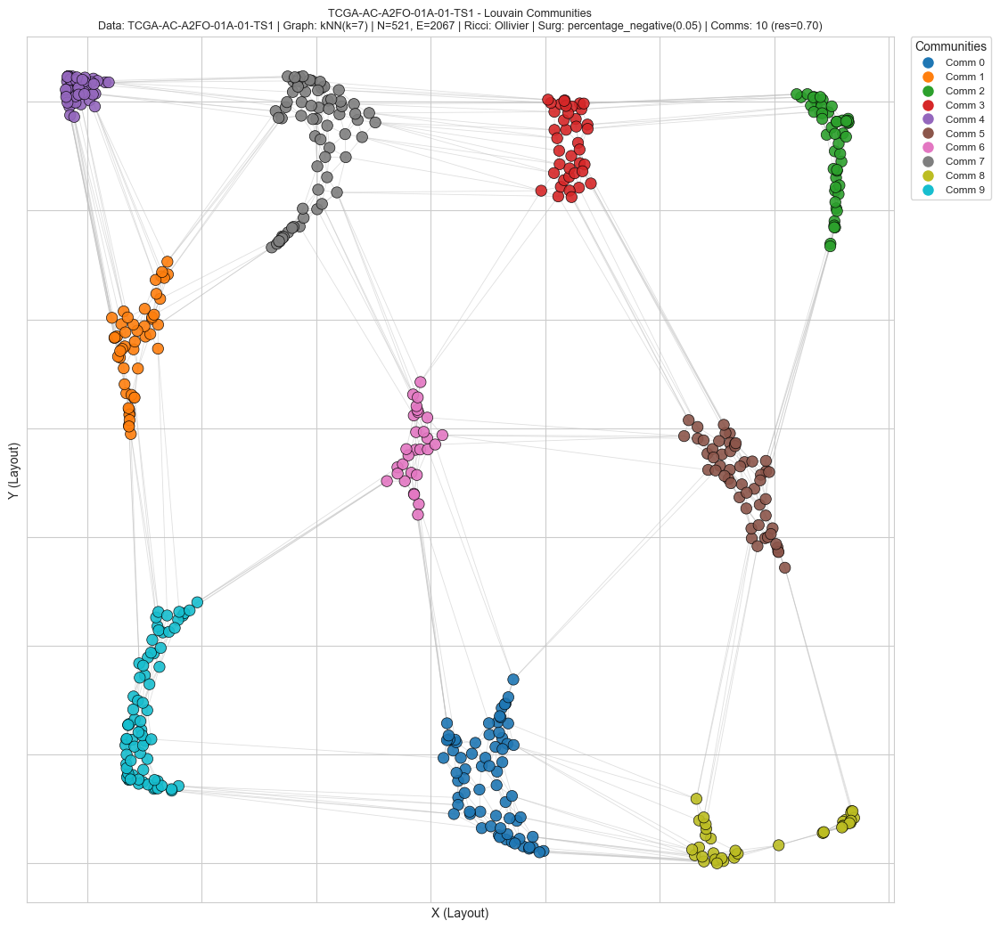

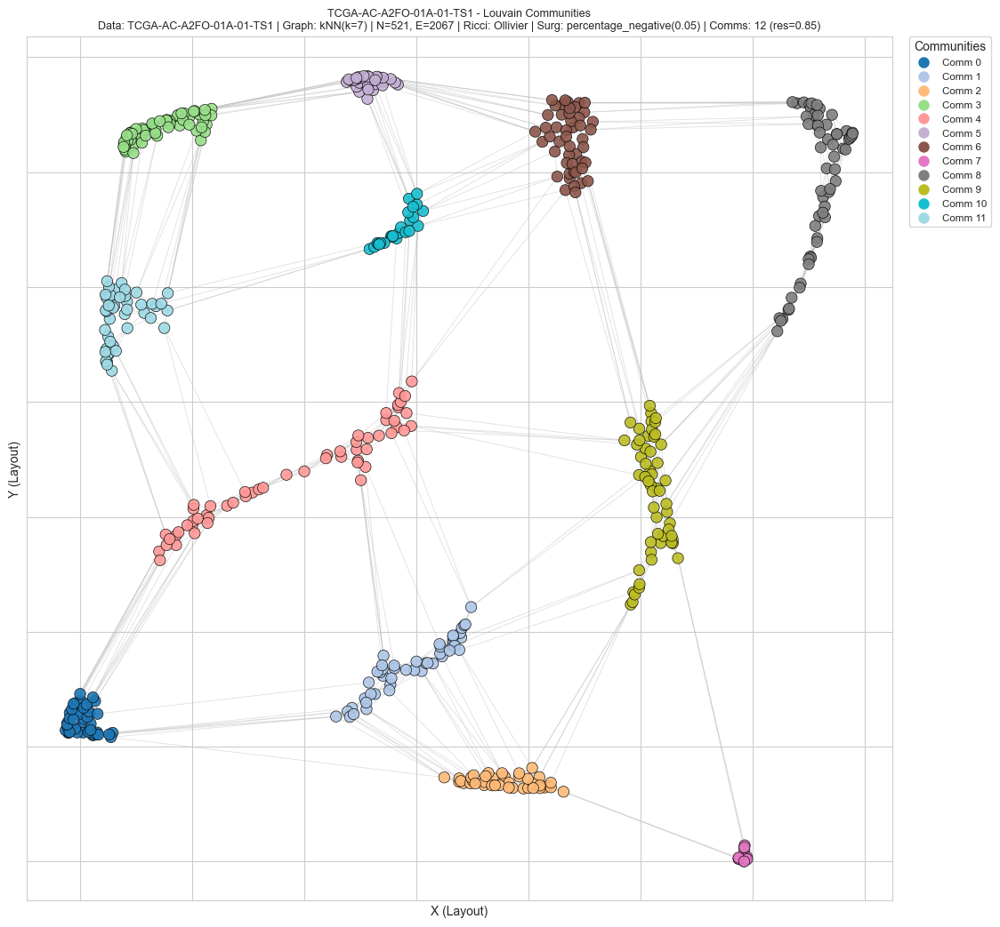

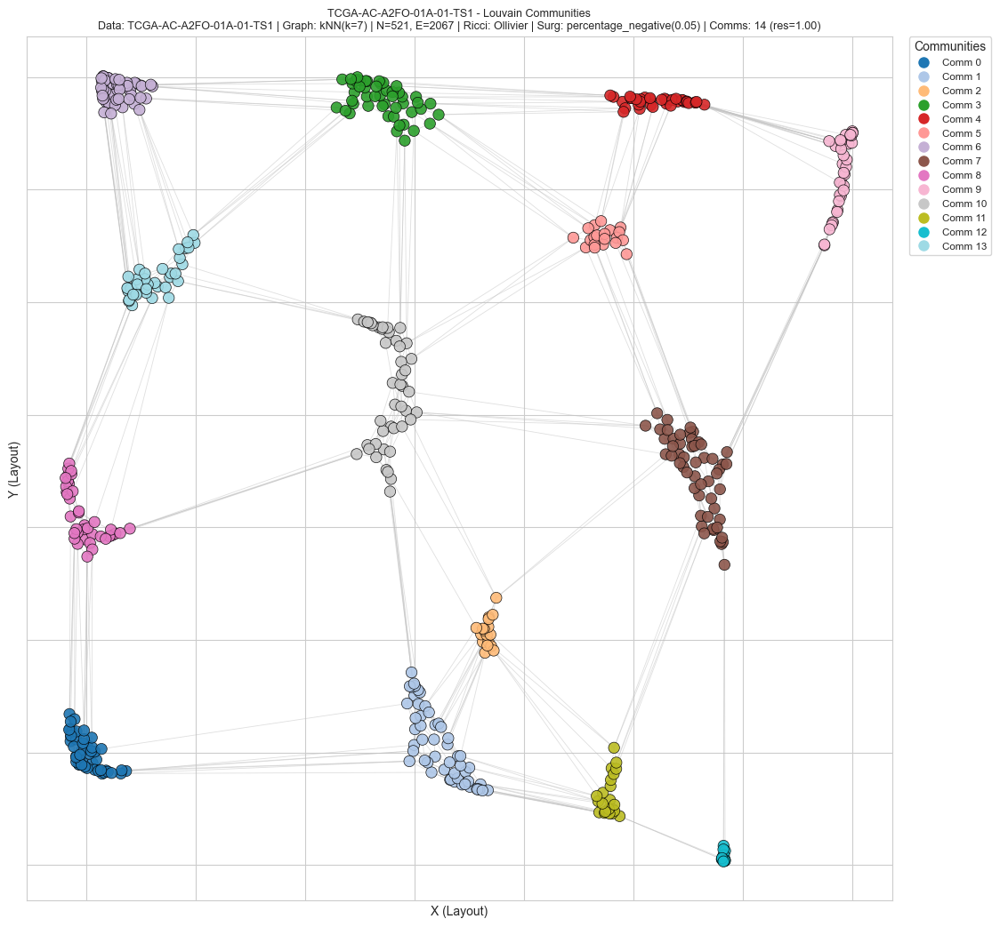


--- Starting Workflow for XML: MoNuSegTestData/TCGA-EJ-A46H-01A-03-TSC.xml ---
Created output folder: output_file/Output_TCGA-EJ-A46H-01A-03-TSC
  Extracted 466 centroids (Source: TCGA-EJ-A46H-01A-03-TSC).
Initial graph (kNN(k=7)) for TCGA-EJ-A46H-01A-03-TSC: 466N, 1924E
Computing Ollivier curvature for TCGA-EJ-A46H-01A-03-TSC...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-EJ-A46H-01A-03-TSC.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


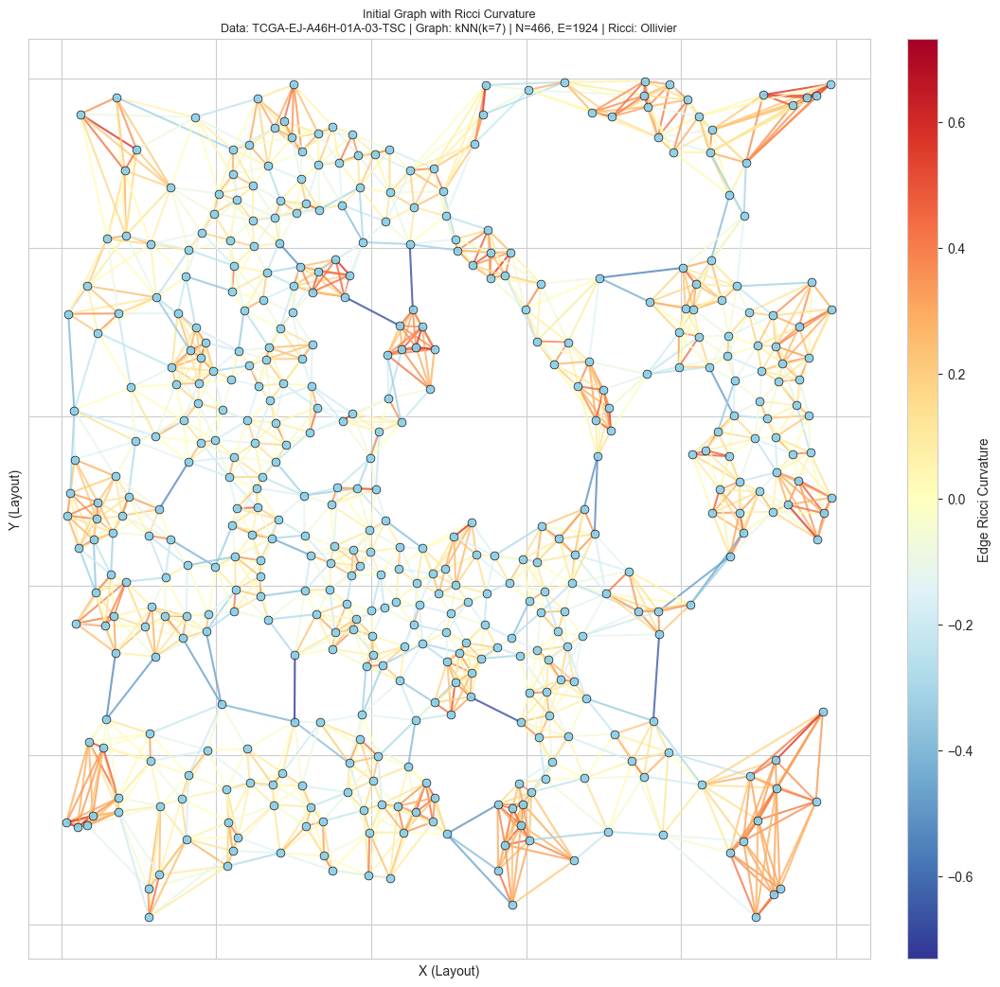

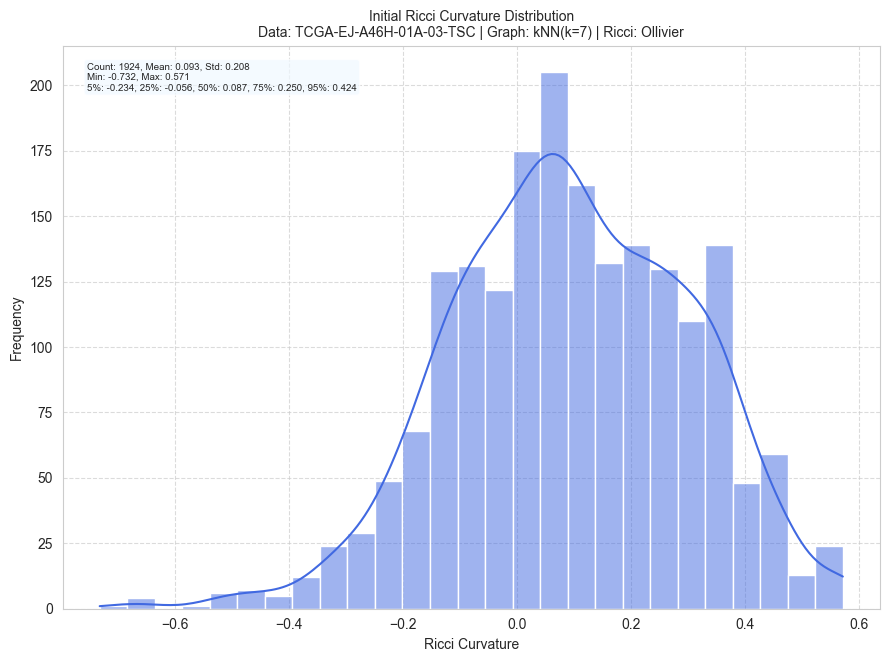


Applying Initial Surgery to TCGA-EJ-A46H-01A-03-TSC: percentage_negative(0.05)...
  Initial surgery removed 30 edges from TCGA-EJ-A46H-01A-03-TSC.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


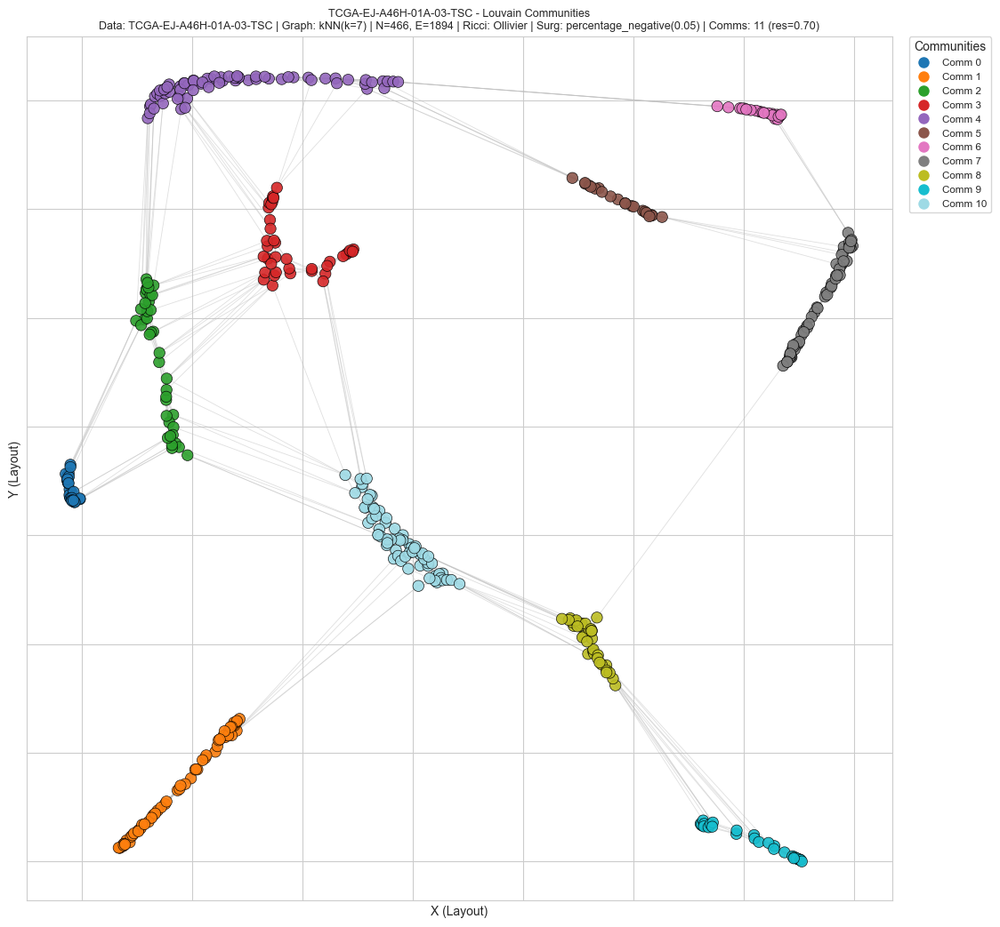

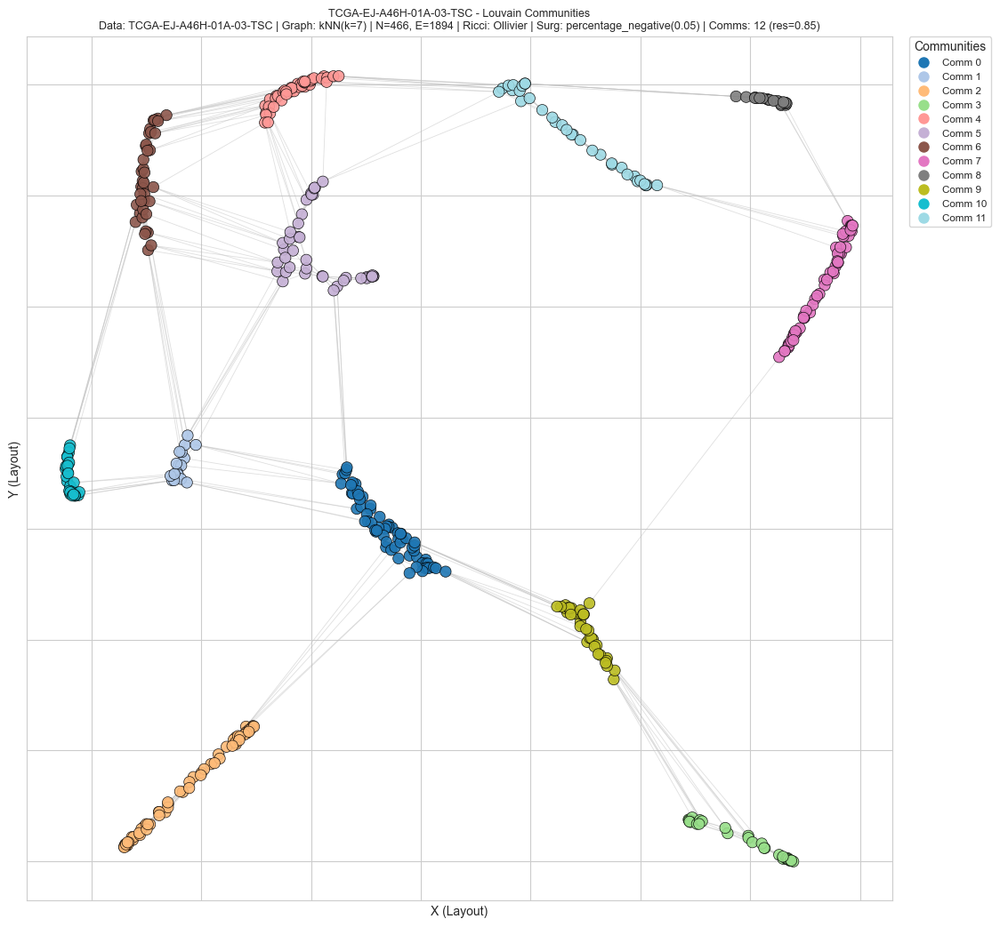

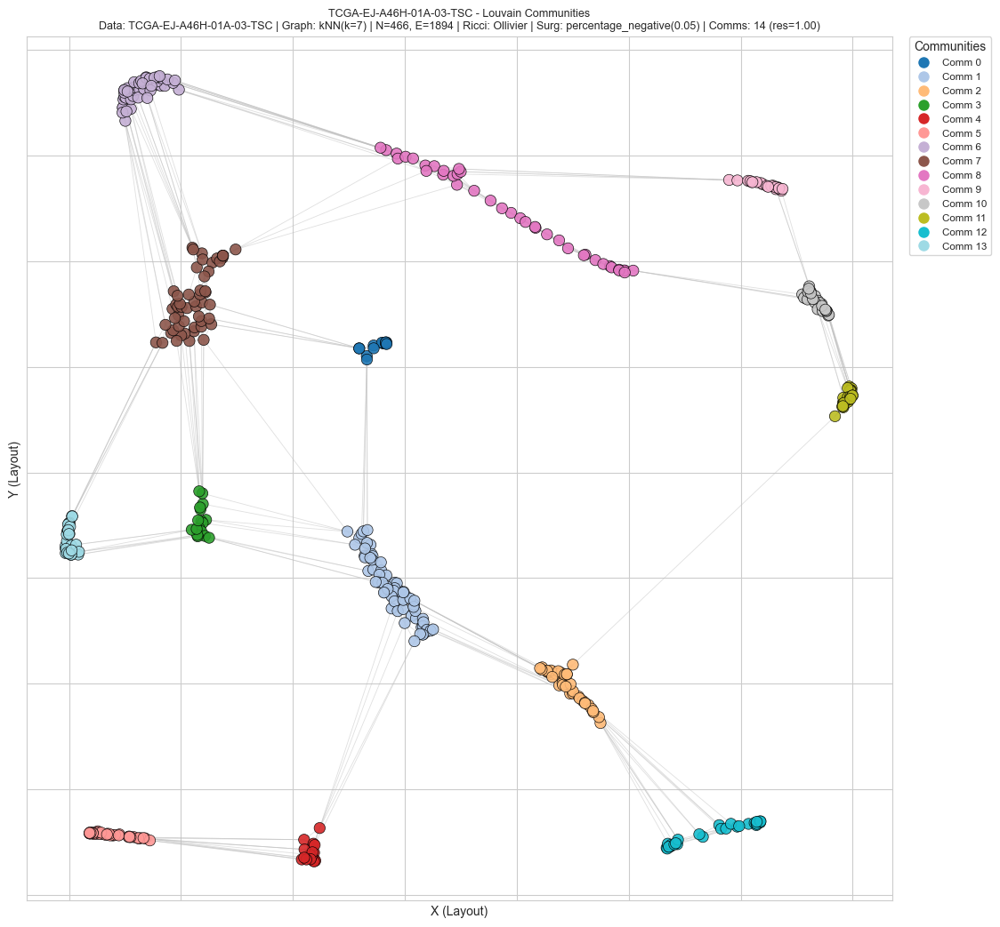


--- Starting Workflow for XML: MoNuSegTestData/TCGA-HC-7209-01A-01-TS1.xml ---
Created output folder: output_file/Output_TCGA-HC-7209-01A-01-TS1
  Extracted 325 centroids (Source: TCGA-HC-7209-01A-01-TS1).
Initial graph (kNN(k=7)) for TCGA-HC-7209-01A-01-TS1: 325N, 1341E
Computing Ollivier curvature for TCGA-HC-7209-01A-01-TS1...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-HC-7209-01A-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


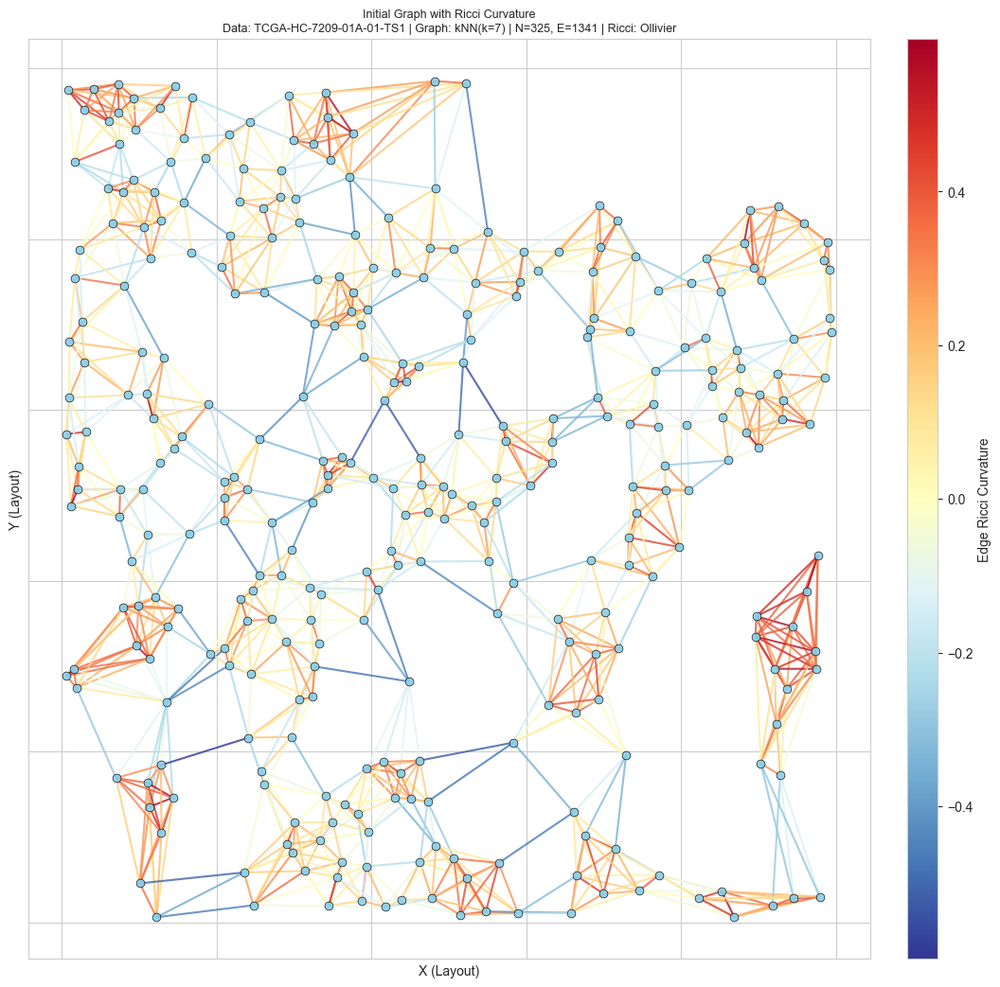

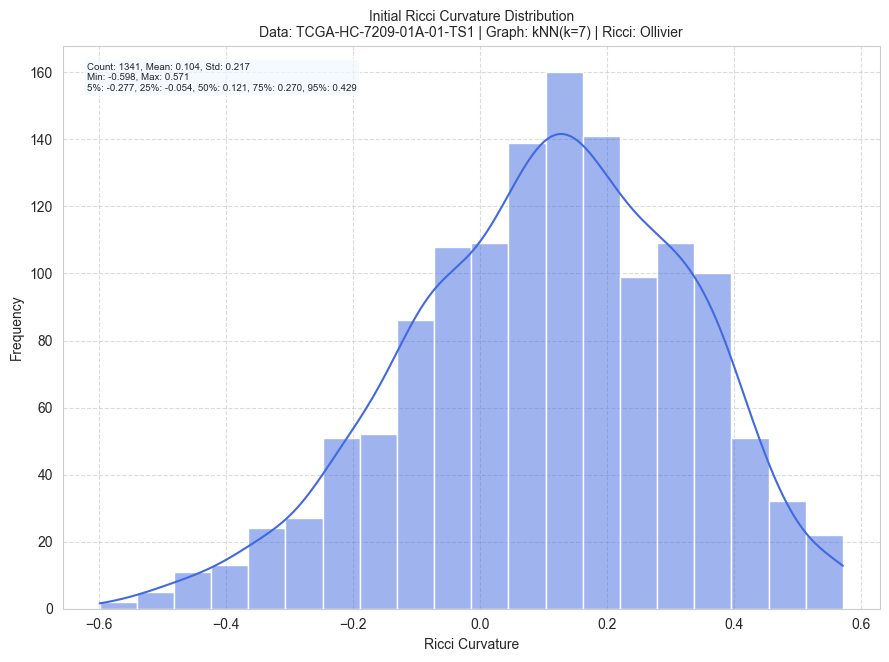


Applying Initial Surgery to TCGA-HC-7209-01A-01-TS1: percentage_negative(0.05)...
  Initial surgery removed 19 edges from TCGA-HC-7209-01A-01-TS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


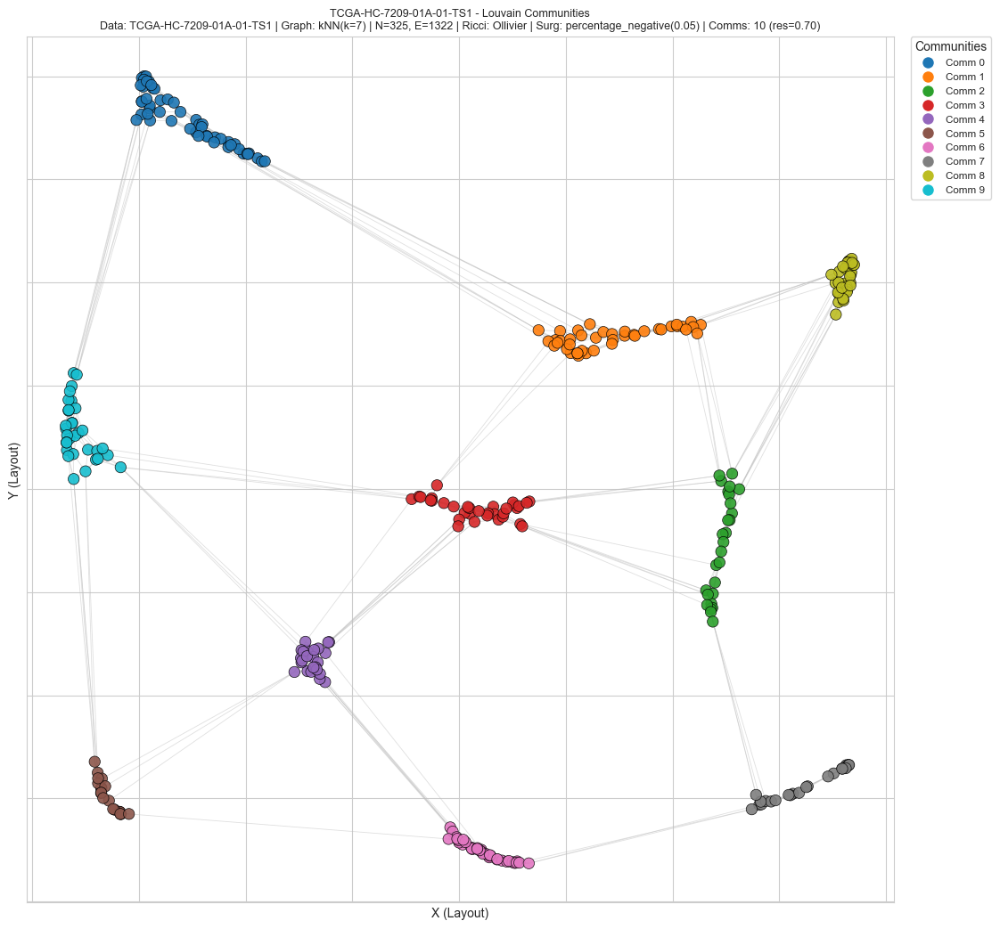

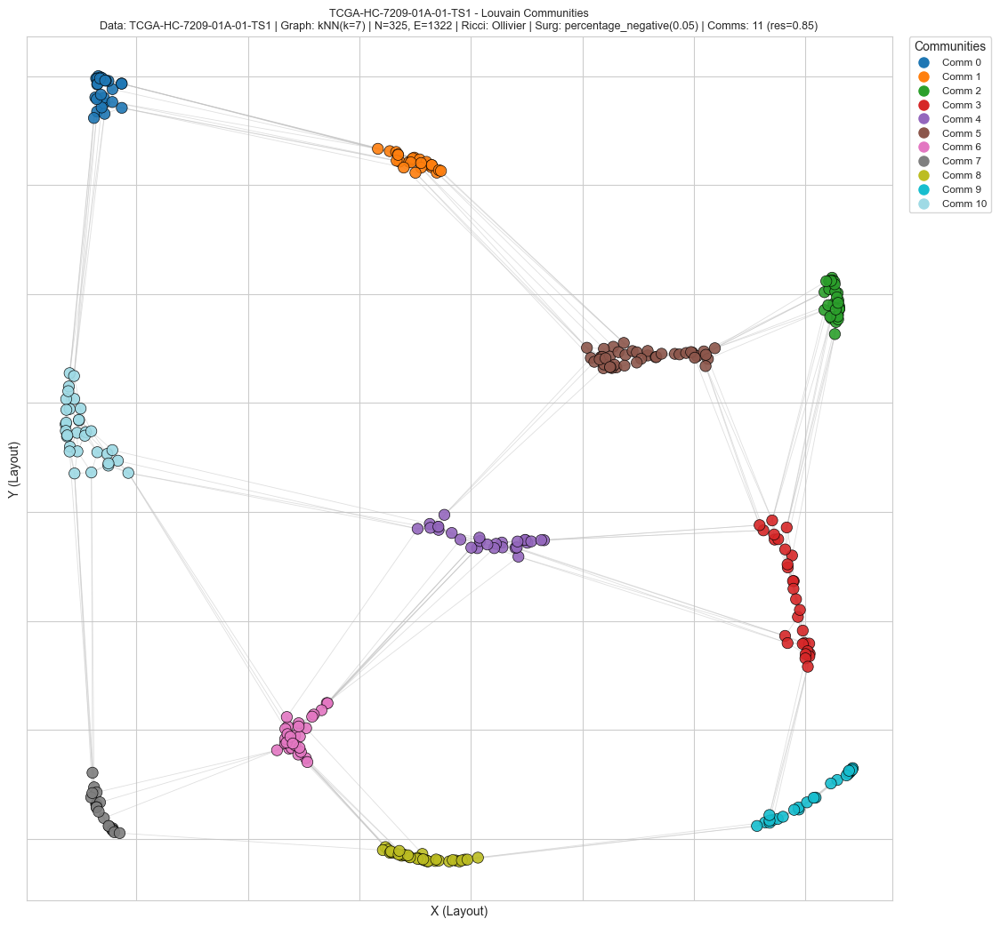

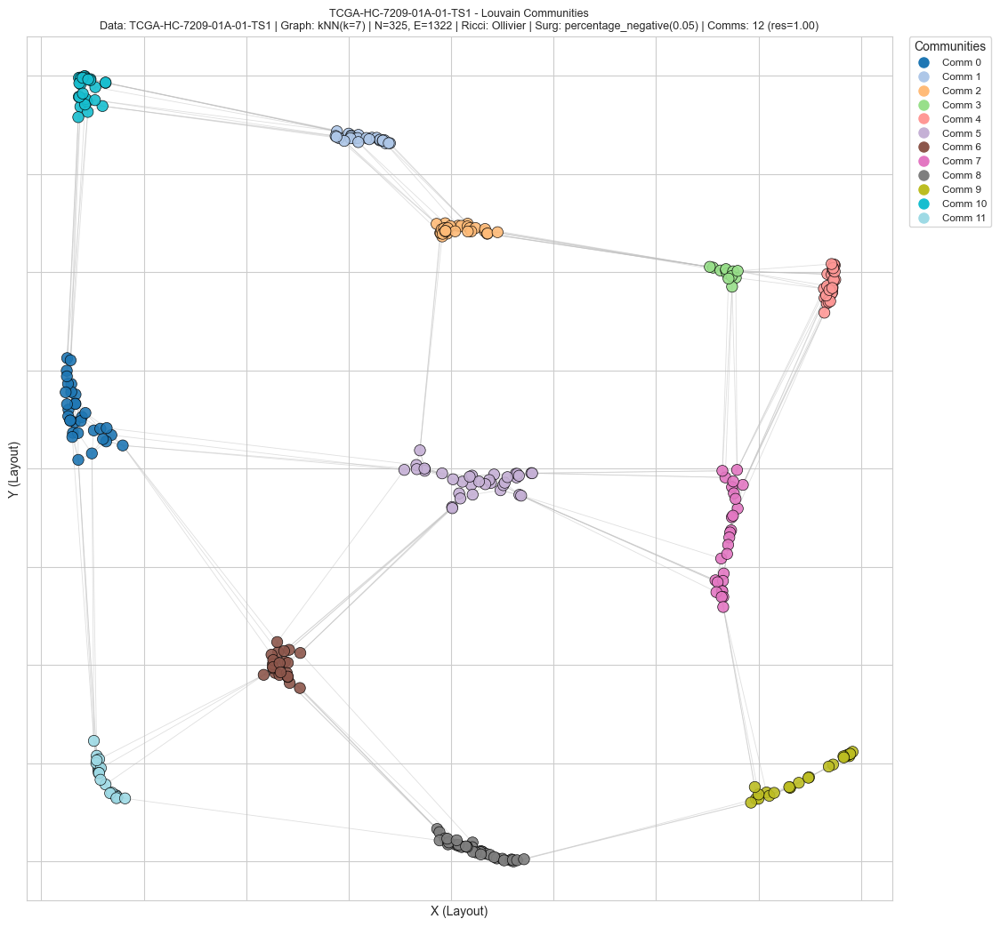


--- Starting Workflow for XML: MoNuSegTestData/TCGA-GL-6846-01A-01-BS1.xml ---
Created output folder: output_file/Output_TCGA-GL-6846-01A-01-BS1
  Extracted 355 centroids (Source: TCGA-GL-6846-01A-01-BS1).
Initial graph (kNN(k=7)) for TCGA-GL-6846-01A-01-BS1: 355N, 1429E
Computing Ollivier curvature for TCGA-GL-6846-01A-01-BS1...
Incorrect verbose level, option:["INFO","DEBUG","ERROR"], use "ERROR instead."
Ricci curvature (Ollivier) data found on edges for TCGA-GL-6846-01A-01-BS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/3807311279.py:69: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(graph, layout_pos, edge_color=edge_curvatures_to_draw, edge_cmap=cmap_edges_to_use,


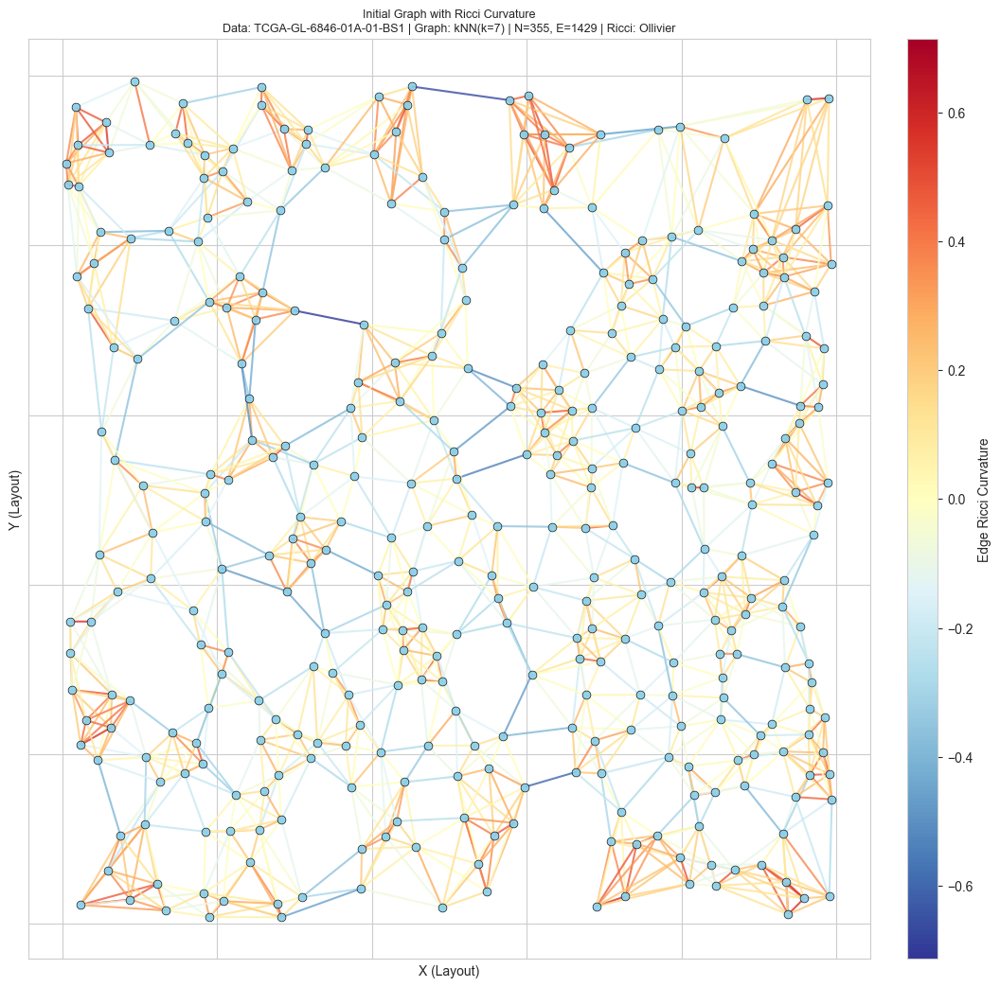

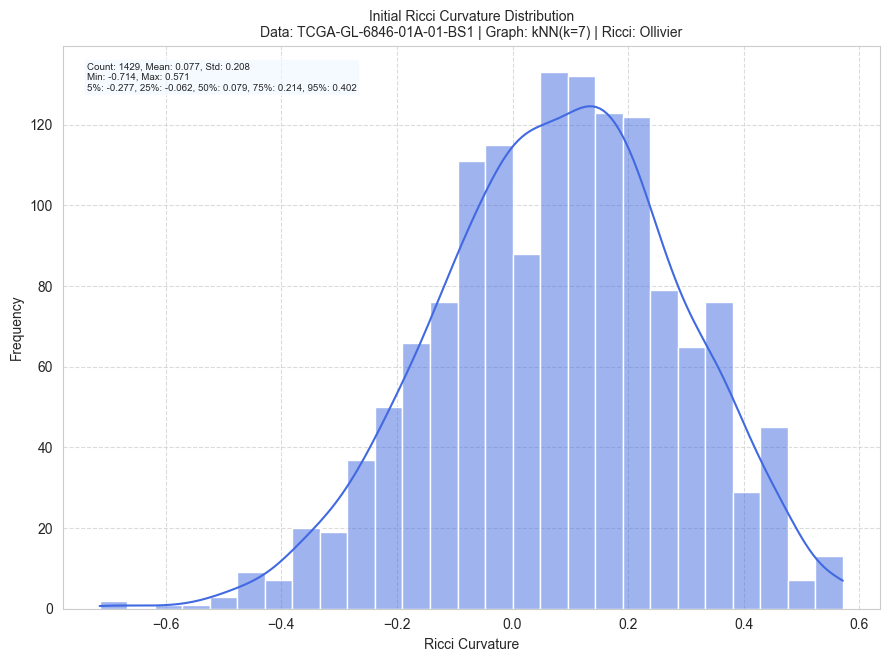


Applying Initial Surgery to TCGA-GL-6846-01A-01-BS1: percentage_negative(0.05)...
  Initial surgery removed 23 edges from TCGA-GL-6846-01A-01-BS1.


/var/folders/xy/03cjwd9527j8gnxjzhw31yjm0000gn/T/ipykernel_60570/1929797659.py:103: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_viz_display = plt.cm.get_cmap(cmap_n, num_unique_comms_viz if num_unique_comms_viz > 0 else 1)


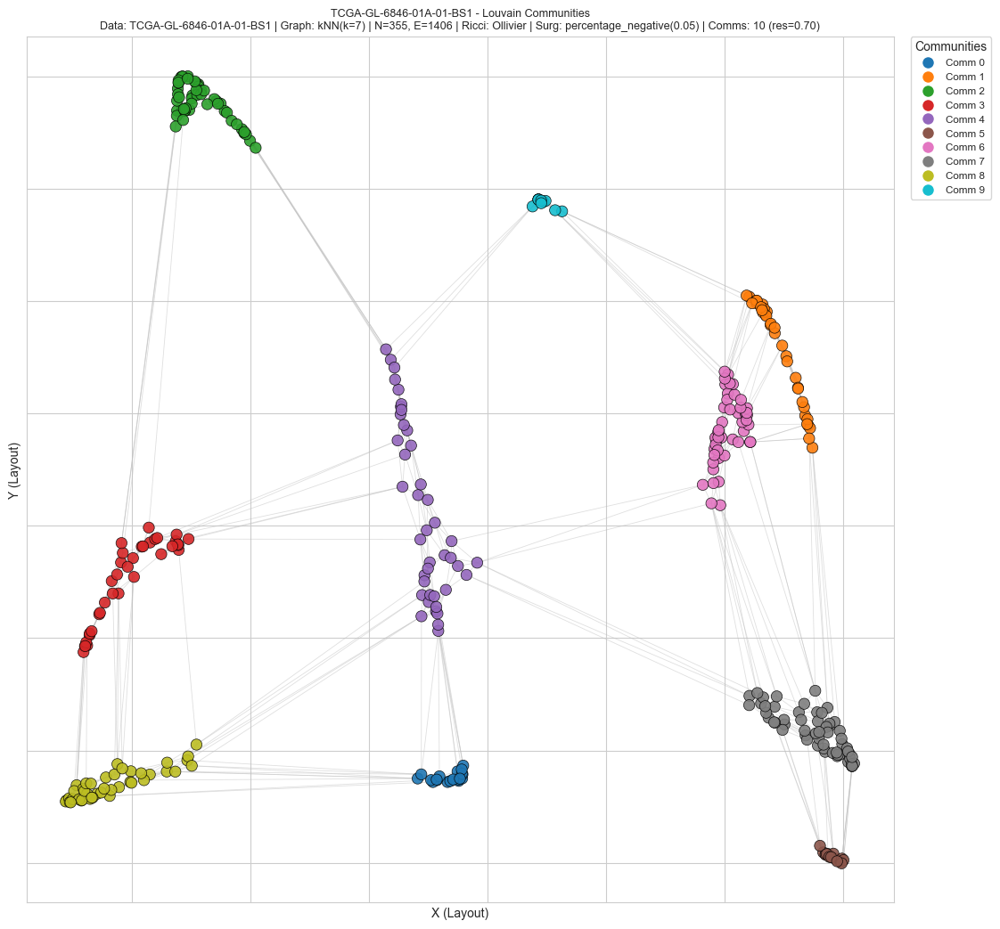

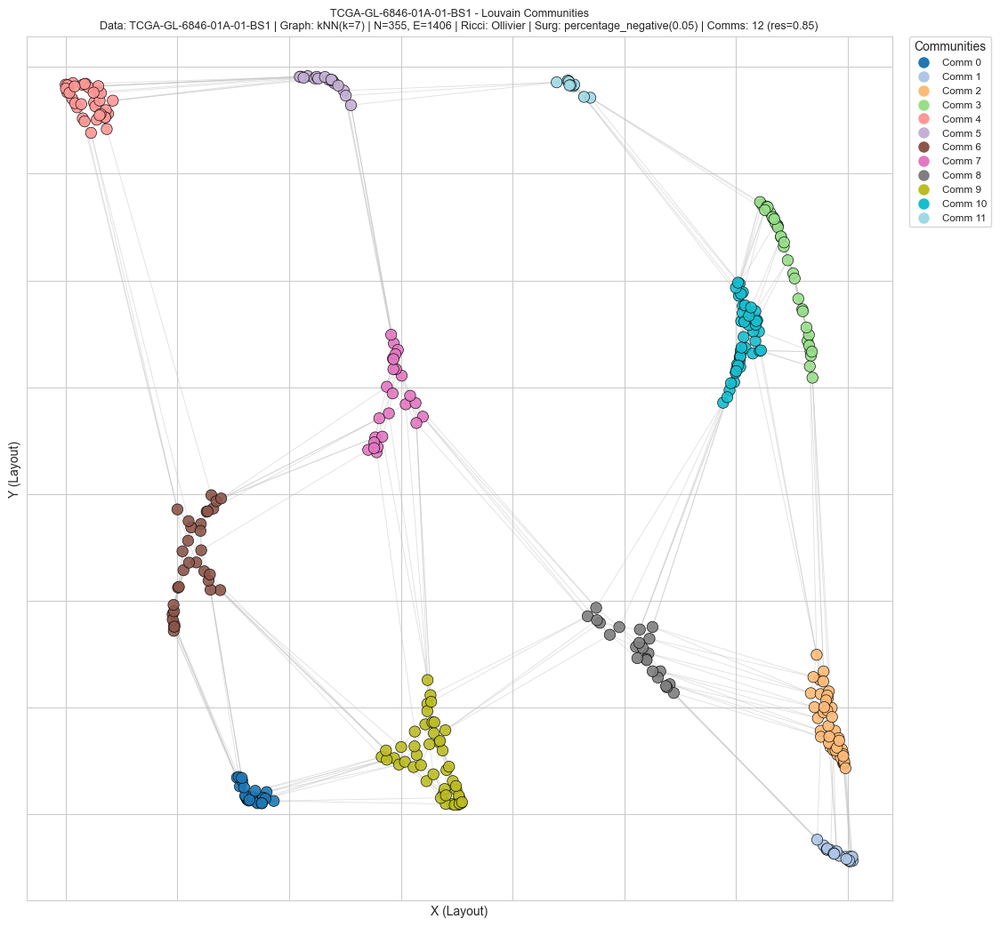

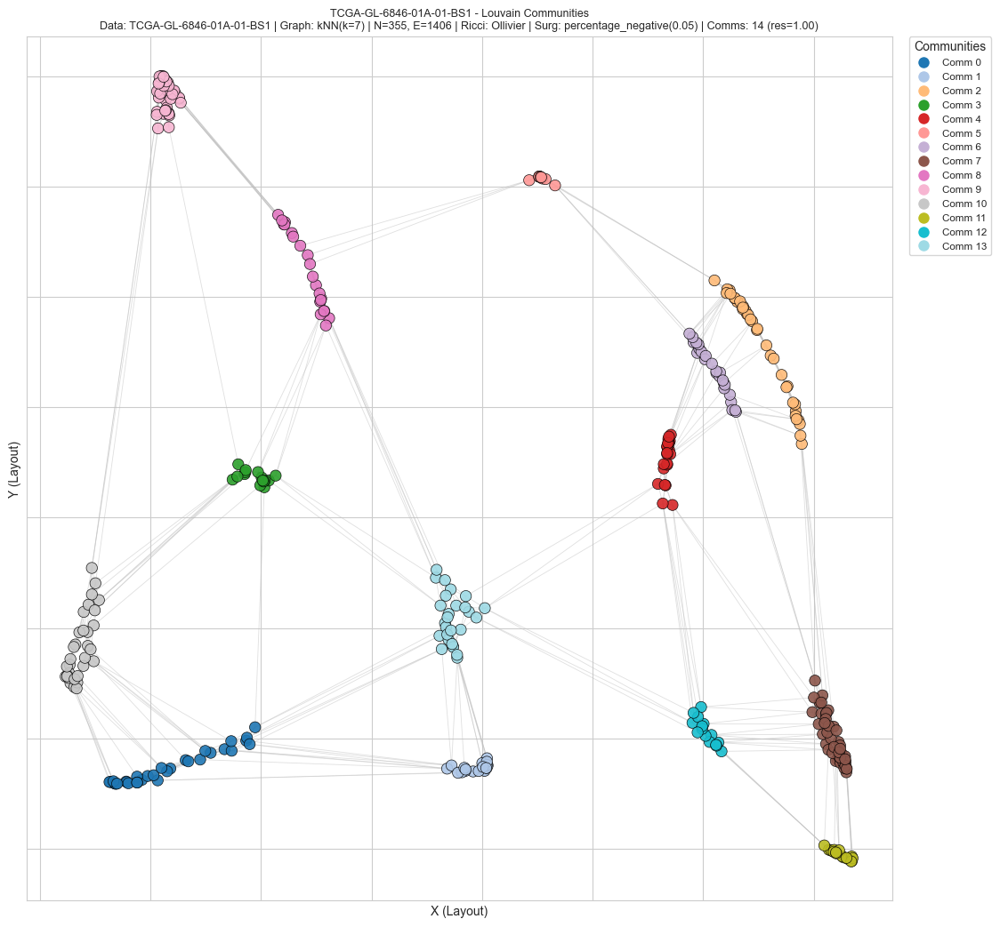

In [26]:
for xml_file_path_loop in xml_files_to_process:
    current_base_filename = os.path.splitext(os.path.basename(xml_file_path_loop))[0]
    safe_base_filename = current_base_filename.replace(' ','_').replace('.','-').replace(':','-')
    file_specific_output_folder = os.path.join(output_base_folder_main, f"Output_{safe_base_filename}")
    
    label_for_main_comp, curvatures_for_main_comp = process_xml_workflow(
        xml_file_path=xml_file_path_loop,
        initial_graph_type='knn',
        initial_k_value=shared_initial_k,
        ricci_method=shared_ricci_method,
        apply_initial_surgery=shared_apply_surgery,
        initial_surgery_method_type=shared_surgery_method,
        initial_surgery_param_value=shared_surgery_val,
        louvain_resolution_schedule=shared_louvain_res_schedule,
        use_community_aware_layout_flag=shared_use_community_layout,
        spring_layout_intra_weight_val=shared_intra_weight,
        spring_layout_inter_weight_val=shared_inter_weight,
        spring_layout_base_iterations_val=shared_layout_iters,
        show_plots_live=SHOW_PLOTS_LIVE_MAIN,
        save_frames=SAVE_PLOTS_TO_FILE_MAIN,
        frame_output_folder=file_specific_output_folder,
        frame_prefix_base=""
    )

    if label_for_main_comp and curvatures_for_main_comp:
        all_curvature_profiles_for_main_comparison.append((label_for_main_comp, curvatures_for_main_comp))
    elif label_for_main_comp:
        print(f"Processed {current_base_filename}, but no valid curvatures were returned.")


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Saved comparison plot: output_file/ALL_FILES_curv_profiles_k7_Ollivier_Surg-percentage_negative_0.05.png


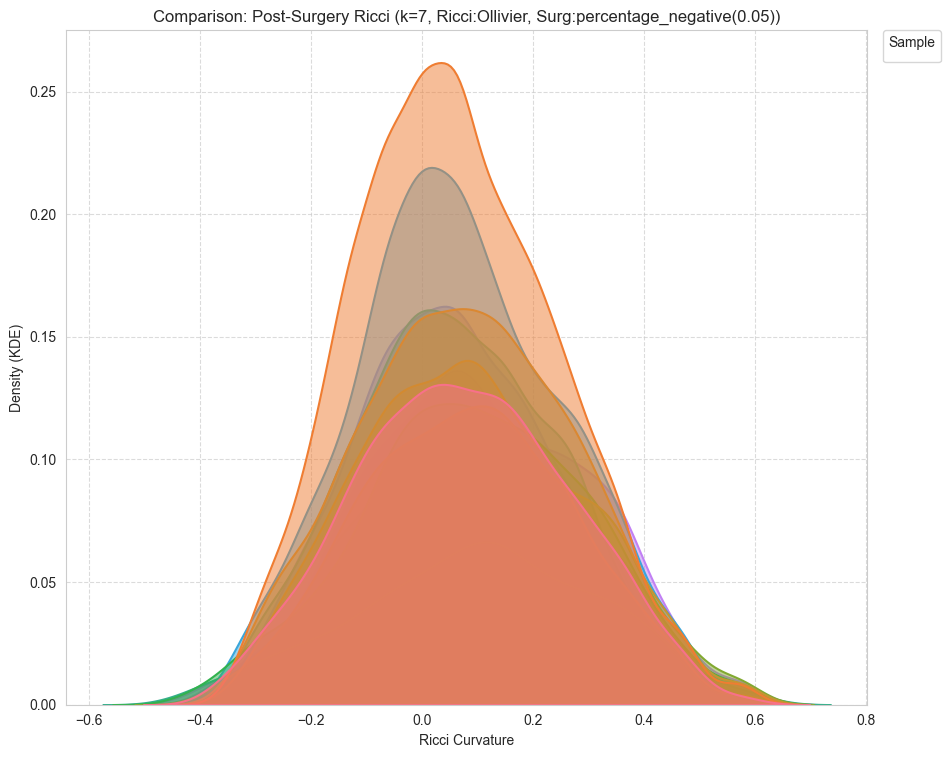

In [28]:
if len(all_curvature_profiles_for_main_comparison) > 1:
    surg_method_str = shared_surgery_method or "None"
    surg_val_str = f"{shared_surgery_val:.2f}" if isinstance(shared_surgery_val, float) else str(shared_surgery_val or "N/A")
    comparison_plot_filename = f"ALL_FILES_curv_profiles_k{shared_initial_k}_{shared_ricci_method}_Surg-{surg_method_str}_{surg_val_str}.png"
    final_comparison_output_path = os.path.join(output_base_folder_main, comparison_plot_filename) if SAVE_PLOTS_TO_FILE_MAIN else None

    plot_multiple_curvature_distributions(
        curvature_data_list=all_curvature_profiles_for_main_comparison,
        main_title=f"Comparison: Post-Surgery Ricci (k={shared_initial_k}, Ricci:{shared_ricci_method}, Surg:{surg_method_str}({surg_val_str}))",
        output_path=final_comparison_output_path,
        show_plot_live=SHOW_PLOTS_LIVE_MAIN
    )
elif all_curvature_profiles_for_main_comparison:
    print("Only one valid curvature profile. Plotting it.")
    single_label, single_curvs = all_curvature_profiles_for_main_comparison[0]
    single_plot_path = os.path.join(output_base_folder_main, f"SINGLE_PROFILE_{single_label.replace(' ','_').replace(':','-')}_dist.png") if SAVE_PLOTS_TO_FILE_MAIN else None
    if single_curvs:
        temp_g_for_single_plot = nx.Graph()
        if len(single_curvs) == 1:
            temp_g_for_single_plot.add_edge("s0", "s1", ricciCurvature=single_curvs[0])
        else:
            for idx, c_val in enumerate(single_curvs):
                temp_g_for_single_plot.add_edge(f"s{idx*2}", f"s{idx*2+1}", ricciCurvature=c_val)
        if temp_g_for_single_plot.edges():
            plot_curvature_distribution(temp_g_for_single_plot, title_parts={"main": f"Ricci Dist: {single_label}"}, output_path=single_plot_path, show_plot_live=SHOW_PLOTS_LIVE_MAIN)
else:
    print("No curvature profiles were generated.")


In [29]:
if SHOW_PLOTS_LIVE_MAIN and plt.get_fignums():
    print("\nAll processing complete. Close all plot windows to finish.")
    plt.show()
else:
    print("\nAll processing complete.")



All processing complete.
